# Réseaux pleinement connectés 

Cet exercice fait suite au devoir 1.  L'objectif ici est d'implanter un réseau pleinement connecté avec une approche plus modulaire. Pour chaque couche, vous serez appelé à implanter une fonction `forward` et une fonction `backward`. La fonction `forward` reçoit en entrée un tenseur `x`, des poids `w` et possiblement d'autres parameters, et retourne le tenseur de sortie de la couche `out`.  La fonction retourne aussi une variable `cache`  contenant des données utilisés pour la rétropropagation (fonction `backward`).  La structure de la fonction `forward` est la suivante : 

```python
def layer_forward(x, w):
  """ Receive inputs x and weights w """
  # Do some computations ...
  z = # ... some intermediate value
  # Do some more computations ...
  out = # the output
   
  cache = (x, w, z, out) # Values we need to compute gradients
   
  return out, cache
```

N'oubliez pas que `x` est une `batch` et donc conbient plus d'un élément.

En rétropropagation, la fonction `backward` de la couche reçoit en entrée un tenseur de dérivées `dout` ainsi que la liste `cache` calculée lors de la propagation avant (fonction `forward`).  Elle retourne deux tenseurs de gradients: un par rapport à ses entrée (`dx`) et un par rapport à ses poids (`dw`) (et parfois un par rapport aux bias `db`).  La structure de la fonction `backward` est la suivante : 

```python
def layer_backward(dout, cache):
  """
  Receive derivative of loss with respect to outputs and cache,
  and compute derivative with respect to inputs.
  """
  # Unpack cache values
  x, w, z, out = cache
  
  # Use values in cache to compute derivatives
  dx = # Derivative of loss with respect to x
  dw = # Derivative of loss with respect to w
  
  return dx, dw
```

Une fois ce type de couches implanté, il sera possible de les combiner ensemble et ainsi construire des réseaux de neurones de différentes architectures.

En plus des réseaux pleinement connectés, nous explorerons différents algorithme de descente de gradient et  introduirons *Dropout* et *Batch Norm*.
  

In [1]:
# As usual, a bit of setup

#import time
import numpy as np
import matplotlib.pyplot as plt
from ift725.classifiers.fc_net import *
from ift725.data_utils import get_CIFAR10_data
from ift725.gradient_check import eval_numerical_gradient, eval_numerical_gradient_array
from ift725.solver import Solver

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

# for auto-reloading external modules
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2

def rel_error(x, y):
  """ returns relative error """
  return np.max(np.abs(x - y) / (np.maximum(1e-8, np.abs(x) + np.abs(y))))

print('setup done!')

setup done!


In [2]:
# Load the (preprocessed) CIFAR10 data.

data = get_CIFAR10_data()
for k, v in data.items():
  print('%s: ' % k, v.shape)

X_train:  (49000, 3, 32, 32)
y_train:  (49000,)
X_val:  (1000, 3, 32, 32)
y_val:  (1000,)
X_test:  (1000, 3, 32, 32)
y_test:  (1000,)


# Couche pleinement connectée : propagation avant
Dans le fichier `ift725/layers.py`, vous devez coder la fonction `forward_fully_connected` et la tester avec le code de la cellule suivante.

In [3]:
# Test the forward_fully_connected function : batch 1 and 1 output neuron

input_shape = (2, 2, 3) # an 2x2x3 input variable (a CIFAR10 image would have a 32x32x3 shape)

input_size = np.prod(input_shape) # here 12
weight_size = np.prod(input_shape) # here 12

x = np.floor(np.linspace(-0.1, 0.5, num=input_size).reshape(1, *input_shape)*10)
w = np.floor(np.linspace(-0.2, 0.3, num=weight_size).reshape(weight_size, 1)*10)
b = np.linspace(-0.3, 0.1, num=1)

print('x-shape  = ', x.shape)
print('w-shape  = ', w.shape)
print('b-shape  = ', b.shape)

out, _ = forward_fully_connected(x, w, b)
correct_out = 36.7

print('out = ', out)
print('correct_out = ', correct_out)

# Compare your output with ours. The error should be around 1e-9.
print('Testing forward_fully_connected function:')
print('difference: ', rel_error(out, correct_out))

x-shape  =  (1, 2, 2, 3)
w-shape  =  (12, 1)
b-shape  =  (1,)
out =  [[36.7]]
correct_out =  36.7
Testing forward_fully_connected function:
difference:  0.0


In [4]:
# Test the forward_fully_connected function : batch 2 and 1 output neuron

num_inputs = 2          # batch of 2 input variables
input_shape = (2, 2, 3) # an 2x2x3 input variable (a CIFAR10 image would have a 32x32x3 shape)

input_size = num_inputs * np.prod(input_shape) # here 2x12 = 24
weight_size = np.prod(input_shape) # here 12

x = np.floor(np.linspace(-0.1, 0.5, num=input_size).reshape(num_inputs, *input_shape)*10)
w = np.floor(np.linspace(-0.2, 0.3, num=weight_size).reshape(weight_size, 1)*10)
b = np.linspace(-0.3, 0.1, num=1)

print('x-shape  = ', x.shape)
print('w-shape  = ', w.shape)
print('b-shape  = ', b.shape)

out, _ = forward_fully_connected(x, w, b)
correct_out = np.array([14.7, 20.7])

print('out = ', out)
print('correct_out = ', correct_out)

# Compare your output with ours. The error should be around 1e-9.
print('Testing forward_fully_connected function:')
print('difference: ', rel_error(out.T, correct_out))

x-shape  =  (2, 2, 2, 3)
w-shape  =  (12, 1)
b-shape  =  (1,)
out =  [[14.7]
 [20.7]]
correct_out =  [14.7 20.7]
Testing forward_fully_connected function:
difference:  0.0


In [5]:
# Test the forward_fully_connected function : batch 2 and 2 output neurons
num_inputs = 2          # batch of 2 input variables
input_shape = (2, 2, 3) # each variable as a 2x2x3 shape (a CIFAR10 RBG image would have a 32x32x3 shape)
output_dim = 2          # the output has 2 neurons

input_size = num_inputs * np.prod(input_shape)  #here 2x2x2x3 = 24
weight_size = output_dim * np.prod(input_shape) #here 2x12 = 24

x = np.floor(np.linspace(-0.1, 0.5, num=input_size).reshape(num_inputs, *input_shape)*10)
w = np.floor(np.linspace(-0.2, 0.3, num=weight_size).reshape(np.prod(input_shape), output_dim)*10)
b = np.linspace(-0.3, 0.1, num=output_dim)

print('x-shape  = ', x.shape)
print('w-shape  = ', w.shape)
print('b-shape  = ', b.shape)

out, _ = forward_fully_connected(x, w, b)
correct_out = np.array([[ 12.7,  14.1],
                        [ 11.7,  23.1]])

print('out = ', out)
print('correct_out = ', correct_out)

# Compare your output with ours. The error should be around 1e-9.
print('Testing forward_fully_connected function:')
print('difference: ', rel_error(out, correct_out))

x-shape  =  (2, 2, 2, 3)
w-shape  =  (12, 2)
b-shape  =  (2,)
out =  [[12.7 14.1]
 [11.7 23.1]]
correct_out =  [[12.7 14.1]
 [11.7 23.1]]
Testing forward_fully_connected function:
difference:  0.0


# Couche pleinement connectée : rétro-propagation
If faut maintenant implanter la fonction `backward_fully_connected` et tester votre code avec un gradient numérique.

In [6]:
# Test the backward_fully_connected function
# Here a case for a batch of 10 elements
# Each elements has a 2x3 size
# The layer has 5 output neurons

x = np.random.randn(10, 2, 3)  # batch of 10 elements, each of size 2x3
w = np.random.randn(6, 5)      # 2x3=6 weigts times 5 output neurones
b = np.random.randn(5)         # one bias for each output neurone
dout = np.random.randn(10, 5)  # the upcoming gradient at each output neuron and for each element of the batch

dx_num = eval_numerical_gradient_array(lambda x: forward_fully_connected(x, w, b)[0], x, dout)
dw_num = eval_numerical_gradient_array(lambda w: forward_fully_connected(x, w, b)[0], w, dout)
db_num = eval_numerical_gradient_array(lambda b: forward_fully_connected(x, w, b)[0], b, dout)

_, cache = forward_fully_connected(x, w, b)
dx, dw, db = backward_fully_connected(dout, cache)

# The error should be around 1e-10
print('Testing backward_fully_connected function:')
print('dx error: ', rel_error(dx_num, dx))  #Gradient with respect to the input x : size 10x2x3
print('dw error: ', rel_error(dw_num, dw))  #Gradient with respect to the weights w : size 5x6
print('db error: ', rel_error(db_num, db))  #Gradient with respect to the bias : size 5

Testing backward_fully_connected function:
dx error:  1.133574712897973e-10
dw error:  4.4417655587871186e-10
db error:  8.650077818512874e-11


# Couche ReLU : propagation avant
Il faut implanter la fonction d'activation ReLU avec la fonction `relu_forward`.  Testez votre implantation avec la cellule que voici:

In [7]:
# Test the relu_forward function

x = np.linspace(-0.5, 0.5, num=12).reshape(3, 4)

out, _ = forward_relu(x)
correct_out = np.array([[ 0.,          0.,          0.,          0.,        ],
                        [ 0.,          0.,          0.04545455,  0.13636364,],
                        [ 0.22727273,  0.31818182,  0.40909091,  0.5,       ]])

# Compare your output with ours. The error should be around 1e-8
print('Testing forward_relu function:')
print('difference: ', rel_error(out, correct_out))

Testing forward_relu function:
difference:  4.999999798022158e-08


# Couche ReLU : rétropropagation
Maintenant il faut implanter la rétro-propagation pour une fonction d'activation ReLU via la fonction `relu_backward`.  Testez votre implantation avec le gradient numérique que voici:

In [8]:
x = np.random.randn(2, 2)
dout = np.random.randn(*x.shape) # Upstream gradient that retropropagates at that layer
print("x = ", x)
print("dout  = ", dout)

dx_num = eval_numerical_gradient_array(lambda xx: forward_relu(xx)[0], x, dout)

_, cache = forward_relu(x)
dx = backward_relu(dout, cache)

# The error should be around 1e-12
print('Testing backward_relu function:')
print('dx error: ', rel_error(dx_num, dx))

x =  [[-0.14547602  0.90526648]
 [-1.02964499  0.5906321 ]]
dout  =  [[-0.05932989  1.48035747]
 [-0.89648781 -0.16790071]]
Testing backward_relu function:
dx error:  2.2755673107424006e-12


# Couches "Combo"
Souvent, on combine une couche pleinement connectée avec une fonction d'activation comme ReLU. Afin de simplifier ces situations, nous avons différentes fonctions à cet effet dans `ift725/layer_combo.py`.

Pour l'instant, nous porterons notre attention sur les fonctions `forward_fully_connected_transform_relu` et `backward_fully_connected_transform_relu`.  Vous pouvez vérifier le code à l'aide de la vérification numérique que voici:

In [9]:
from ift725.layer_combo import forward_fully_connected_transform_relu, backward_fully_connected_transform_relu

x = np.random.randn(2, 3, 4)  # Batch of 2 elements of size 3x4
w = np.random.randn(12, 10)   # 10 output neurons, each associated with 12=3x4 weights
b = np.random.randn(10)       # 10 biases
dout = np.random.randn(2, 10) # up stream gradient for each neuron (10) and each batch element (2)

out, cache = forward_fully_connected_transform_relu(x, w, b)
dx, dw, db = backward_fully_connected_transform_relu(dout, cache)

dx_num = eval_numerical_gradient_array(lambda xx: forward_fully_connected_transform_relu(xx, w, b)[0], x, dout)
dw_num = eval_numerical_gradient_array(lambda ww: forward_fully_connected_transform_relu(x, ww, b)[0], w, dout)
db_num = eval_numerical_gradient_array(lambda bb: forward_fully_connected_transform_relu(x, w, bb)[0], b, dout)

# Error should be around 1e-10
print('Testing forward_fully_connected_transform_relu:')
print('dx error: ', rel_error(dx_num, dx))
print('dw error: ', rel_error(dw_num, dw))
print('db error: ', rel_error(db_num, db))

Testing forward_fully_connected_transform_relu:
dx error:  2.1858261018256127e-10
dw error:  7.249626734517452e-10
db error:  4.632904580637951e-11


# Fonctions de perte : Softmax et SVM
Au devoir 1, vous avez implanter ces deux fonctions de perte.  Vous devez donc récupérer votre code et l'adapter aux fonctions `softmax_loss` et `svm_loss` du fichier `ift725/layers.py`.

Afin de vous assurer que tout fonctionne pour le mieux, exécutez le code que voici:

In [10]:
num_classes, num_inputs = 10, 50
x = 0.001 * np.random.randn(num_inputs, num_classes)
y = np.random.randint(num_classes, size=num_inputs)

dx_num = eval_numerical_gradient(lambda x: svm_loss(x, y)[0], x, verbose=False)
loss, dx = svm_loss(x, y)

# Test svm_loss function. Loss should be around 9 and dx error should be 1e-9
print('Testing svm_loss:')
print('loss: ', loss)
print('dx error: ', rel_error(dx_num, dx))

dx_num = eval_numerical_gradient(lambda x: softmax_loss(x, y)[0], x, verbose=False)
loss, dx = softmax_loss(x, y)

# Test softmax_loss function. Loss should be 2.3 and dx error should be 1e-8
print('\nTesting softmax_loss:')
print('loss: ', loss)
print('dx error: ', rel_error(dx_num, dx))

Testing svm_loss:
loss:  9.000268908326378
dx error:  1.4021566006651672e-09

Testing softmax_loss:
loss:  2.3026124810532793
dx error:  7.866861861702572e-09


# Réseau à deux couches
Au tp1, vous avez implanté un réseau à deux couches à l'intérieur d'une seule classe monolitique. Maintenant que les couches ont un design plus modulaire, vous devez implanter un réseau à deux couches de façon modulaire.

Avec le fichier `ift725/classifiers/fc_net.py`, vous devez compléter l'implantation de la classe `TwoLayerNeuralNet`. Le design de cette classe est le prototype pour les autres réseaux utilisés dans ce devoir.  Par conséquent, soyez attentifs et assurez-vous de bien comprendre cet API. Vous pouvez exécuter la cellule que voici pour tester votre code.

In [11]:
# First, lets try a forward pass for a minibatch of 3 elements of size 5, with an hidden layer of size 50 and 7 classes

N, D, H, C = 3, 5, 50, 7
X = np.random.randn(N, D)
y = np.random.randint(C, size=N)

std = 1e-2
model = TwoLayerNeuralNet(input_dim=D, hidden_dim=H, num_classes=C, weight_scale=std)

print('Testing initialization ... ')
W1_std = abs(model.params['W1'].std() - std)
b1 = model.params['b1']
W2_std = abs(model.params['W2'].std() - std)
b2 = model.params['b2']
assert W1_std < std / 10, 'First layer weights do not seem right'
assert np.all(b1 == 0), 'First layer biases do not seem right'
assert W2_std < std / 10, 'Second layer weights do not seem right'
assert np.all(b2 == 0), 'Second layer biases do not seem right'


print('Testing test-time forward pass ... ')
model.params['W1'] = np.linspace(-0.7, 0.3, num=D*H).reshape(D, H)
model.params['b1'] = np.linspace(-0.1, 0.9, num=H)
model.params['W2'] = np.linspace(-0.3, 0.4, num=H*C).reshape(H, C)
model.params['b2'] = np.linspace(-0.9, 0.1, num=C)
X = np.linspace(-5.5, 4.5, num=N*D).reshape(D, N).T
scores = model.loss(X)

correct_scores = np.asarray(
  [[11.53165108,  12.2917344,   13.05181771,  13.81190102,  14.57198434, 15.33206765,  16.09215096],
   [12.05769098,  12.74614105,  13.43459113,  14.1230412,   14.81149128, 15.49994135,  16.18839143],
   [12.58373087,  13.20054771,  13.81736455,  14.43418138,  15.05099822, 15.66781506,  16.2846319 ]])
scores_diff = np.abs(scores - correct_scores).sum()
assert scores_diff < 1e-6, 'Problem with test-time forward pass'
print('score difference = ', scores_diff)


Testing initialization ... 
Testing test-time forward pass ... 
score difference =  5.115849965875441e-08


In [12]:
# Now lets compute the loss with and without regularization
y = np.asarray([0, 5, 1])

model.reg = 0.0  # NO REG
loss, grads = model.loss(X, y)
correct_loss = 3.4702243556
assert abs(loss - correct_loss) < 1e-10, 'Problem with training-time loss'
print('loss difference = ', abs(loss - correct_loss))

model.reg = 1.0  # WITH REG
loss, grads = model.loss(X, y)
correct_loss = 63.9539735065
print('loss = ', loss, '  correct_loss = ', correct_loss)
print('loss difference = ', abs(loss - correct_loss))
assert abs(loss - correct_loss) < 1e-10, 'Problem with regularization loss'


loss difference =  4.6100900874535e-12
loss =  63.9539735065371   correct_loss =  63.9539735065
loss difference =  3.710454166139243e-11


In [13]:
# Now lets compute the loss with different regularization terms

for reg in [0.0, 0.3, 0.6, 0.9]:
  print('Running numeric gradient check with reg = ', reg)
  model.reg = reg
  loss, grads = model.loss(X, y)

  for name in sorted(grads):
    f = lambda _: model.loss(X, y)[0]
    grad_num = eval_numerical_gradient(f, model.params[name], verbose=False)
    print('%s relative error: %.2e' % (name, rel_error(grad_num, grads[name])))

Running numeric gradient check with reg =  0.0
W1 relative error: 1.22e-08
W2 relative error: 3.30e-10
b1 relative error: 8.37e-09
b2 relative error: 1.94e-10
Running numeric gradient check with reg =  0.3
W1 relative error: 1.00e+00
W2 relative error: 1.00e+00
b1 relative error: 1.00e+00
b2 relative error: 1.00e+00
Running numeric gradient check with reg =  0.6
W1 relative error: 1.00e+00
W2 relative error: 1.00e+00
b1 relative error: 1.00e+00
b2 relative error: 1.00e+00
Running numeric gradient check with reg =  0.9
W1 relative error: 1.00e+00
W2 relative error: 1.00e+00
b1 relative error: 8.51e-01
b2 relative error: 1.00e+00


# Solver
Au tp1, l'entraînement des modèles était couplé aux modèles. Suivant un design plus modulaire, dans ce tp nous avons séparé le code d'entraînement et le code des modèles dans différentes classes.

Familiarisez-vous avec le code `ift725/solver.py` et assurez-vous de bien en comprendre le fonctionnement. Après, utilisez un `Solver` pour entraîner le `TwoLayerNeuralNet` et atteindre environ `50%` de justesse en validation sur le base de donnée CIFAR10 stockée dans la variable `data`.

In [14]:
# Load the (preprocessed) CIFAR10 data.

data = get_CIFAR10_data()
for k, v in data.items():
  print('%s: ' % k, v.shape)

X_train:  (49000, 3, 32, 32)
y_train:  (49000,)
X_val:  (1000, 3, 32, 32)
y_val:  (1000,)
X_test:  (1000, 3, 32, 32)
y_test:  (1000,)


In [15]:
model = TwoLayerNeuralNet()

##############################################################################
# TODO: Utilisez une instance de Solver pour entrainer un TwoLayerNeuralNet  #
#  qui atteint au moins 50% de précision sur l'ensemble de validation.       #
##############################################################################

solver = Solver(model,
                data,
                update_rule = 'sgd',
                optim_config = {'learning_rate': 1e-3},
                lr_decay = 0.90,
                num_epochs = 20, 
                batch_size = 500,
                print_every = 500)
solver.train()

##############################################################################
#                             FIN DE VOTRE CODE                              #
##############################################################################

(Iteration 1 / 1960) loss: 2.303580
(Epoch 0 / 20) train acc: 0.118000; val_acc: 0.133000
(Epoch 1 / 20) train acc: 0.376000; val_acc: 0.381000
(Epoch 2 / 20) train acc: 0.377000; val_acc: 0.420000
(Epoch 3 / 20) train acc: 0.484000; val_acc: 0.446000
(Epoch 4 / 20) train acc: 0.469000; val_acc: 0.458000
(Epoch 5 / 20) train acc: 0.452000; val_acc: 0.474000
(Iteration 501 / 1960) loss: 1.495722
(Epoch 6 / 20) train acc: 0.512000; val_acc: 0.483000
(Epoch 7 / 20) train acc: 0.533000; val_acc: 0.485000
(Epoch 8 / 20) train acc: 0.495000; val_acc: 0.492000
(Epoch 9 / 20) train acc: 0.505000; val_acc: 0.488000
(Epoch 10 / 20) train acc: 0.519000; val_acc: 0.493000
(Iteration 1001 / 1960) loss: 1.328625
(Epoch 11 / 20) train acc: 0.546000; val_acc: 0.506000
(Epoch 12 / 20) train acc: 0.524000; val_acc: 0.497000
(Epoch 13 / 20) train acc: 0.533000; val_acc: 0.516000
(Epoch 14 / 20) train acc: 0.504000; val_acc: 0.509000
(Epoch 15 / 20) train acc: 0.539000; val_acc: 0.507000
(Iteration 1501 /

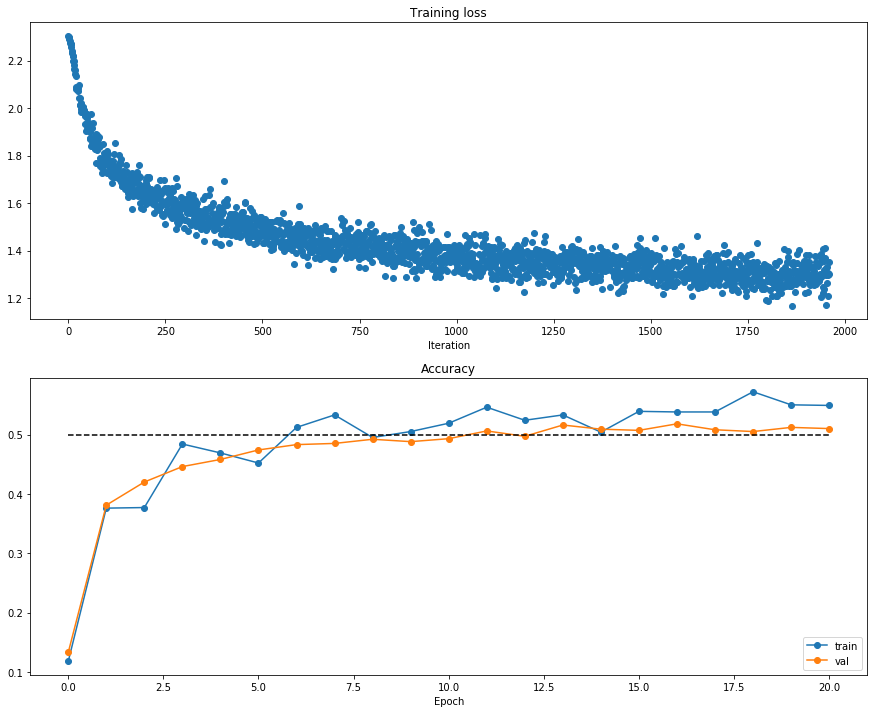

In [16]:
# Run this cell to visualize training loss and train / val accuracy

plt.subplot(2, 1, 1)
plt.title('Training loss')
plt.plot(solver.loss_history, 'o')
plt.xlabel('Iteration')

plt.subplot(2, 1, 2)
plt.title('Accuracy')
plt.plot(solver.train_acc_history, '-o', label='train')
plt.plot(solver.val_acc_history, '-o', label='val')
plt.plot([0.5] * len(solver.val_acc_history), 'k--')
plt.xlabel('Epoch')
plt.legend(loc='lower right')
plt.gcf().set_size_inches(15, 12)
plt.show()

# Réseau de neurones multi-couches
Maintenant vous devez implanter un réseau ayant un nombre arbitraire de couches.

Pour ce faire, prenez connaissance de la classe `FullyConnectedNeuralNet` du fichier `ift725/classifiers/fc_net.py`.

Vous devez implanter **l'initialization, la propagation avant et la rétro-propagation**. Pour le moment, ne vous souciez pas de dropout ni de batch norm.

##  Fonction de perte et vérification du gradient

La prochaine cellule effectue une vérification dilligente.  Exécutez la cellule afin de vous assurez que la loss avec et sans régularisation fonctionne. 

In [17]:
from ift725.classifiers.fc_net import *
N, D, H1, H2, C = 2, 15, 20, 30, 10
X = np.random.randn(N, D)
y = np.random.randint(C, size=(N,)) 

for reg in [0, 3.14]:
  print('Running check with reg = ', reg)
  model = FullyConnectedNeuralNet([H1, H2], input_dim=D, num_classes=C,
                            reg=reg, weight_scale=5e-2, dtype=np.float64)

  loss, grads = model.loss(X, y)
  print('Initial loss: ', loss)
    
  # Relative error should be below 1e-5
  for name in sorted(grads):
    f = lambda _: model.loss(X, y)[0]
    grad_num = eval_numerical_gradient(f, model.params[name], verbose=False, h=1e-5)
    print('%s relative error: %.2e' % (name, rel_error(grad_num, grads[name])))

Running check with reg =  0
Initial loss:  2.301352201322501
W1 relative error: 2.38e-07
W2 relative error: 1.89e-07
W3 relative error: 3.48e-07
b1 relative error: 3.44e-09
b2 relative error: 2.21e-09
b3 relative error: 1.39e-10
Running check with reg =  3.14
Initial loss:  7.095643040405841
W1 relative error: 3.84e-07
W2 relative error: 6.35e-08
W3 relative error: 9.62e-08
b1 relative error: 9.42e-06
b2 relative error: 1.37e-09
b3 relative error: 2.52e-10


## Question 1:

Pourquoi croyez-vous que les résultats de la cellule précédentes font foi d'une bonne fonction de perte?
     
**Votre réponse:** On peut faire quelques 'sanity check'. 
Sans régularistation, on est sensé obtenir l'équivalent d'un résultat aléatoire, soit le "pire" possible : -log(1/nb_classes) soit -log(1/10) dans notre cas :
$$ -log(1/10) = 2,302585093 $$
Cette valeur correspond assez bien au réslutat que nous obtenons donc ce premier 'sanity check' est validé.
Avec une régularisation, la loss est sensée augmenter puisqu'on rajoute un terme à la loss :
$$ \lambda * \| W \| _2 $$
Vis à vis de ça, on obtient bien une loss plus grande lorsqu'on rajoute ce terme. Ce deuxième 'sanity check' est donc validé.
Ces deux 'sanity check' font ainsi foi d'une bonne fonction de perte.

Autre vérification diligente, assurez-vous que votre code peut "overfitter" sur un petit ensemble de 50 images. Pour ce faire, essayons un réseau à 3 couches cachées ayant chacune 100 neurones. Une recherche d'hyper-paramètres sera effectué pour trouver le bon taux d'apprentissage (learning rate) ainsi que le `weight_scale`.  Vous devriez être capable d'atteindre une justesse en entraînement de 100% avec 20 epochs.

In [18]:
num_train = 50
small_data = {
  'X_train': data['X_train'][:num_train],
  'y_train': data['y_train'][:num_train],
  'X_val': data['X_val'],
  'y_val': data['y_val'],
}

best_weight_scale = 0.
best_learning_rate = 0.
best_training_acc = 0.

##############################################################################
# TODO: Utilisez une instance de Solver pour entrainer un réseau à 3 couches #
#  et 100 neurones par couche à overfitter 50 images de CIFAR10.  Il est     #
#  suggéré d'effectuer une recherche d'hyperparamètres pour trouver le bon   #
#  `learning_rate` et le bon `weight_scale`.                                 #
##############################################################################

input_d  = 32 * 32 * 3
hidden_n = [100, 100, 100]
output_c = 10

weight_scales = np.arange(1e-2, 1e-1, 1e-2)
learning_rates = np.arange(1e-3, 1e-2, 1e-3)

results = {}

for w in weight_scales:
    for l in learning_rates:
        model = FullyConnectedNeuralNet(hidden_n,
                                        input_dim = input_d,
                                        num_classes = output_c,
                                        weight_scale = w,
                                        dtype = np.float64)
    
        solver = Solver(model,
                        small_data,
                        update_rule = 'sgd',
                        optim_config = {'learning_rate': l},
                        lr_decay = 0.90,
                        num_epochs = 20, 
                        batch_size = 500,
                        verbose = False)
        solver.train()
    
        train_acc = solver.train_acc_history[-1]
    
        if train_acc > best_training_acc:
            best_weight_scale  = w
            best_learning_rate = l
            best_training_acc  = train_acc
            
        results[(w, l)] = train_acc

##############################################################################
#                             FIN DE VOTRE CODE                              #
##############################################################################

print('The best learning_rate, weight_scale and training accuracy are',best_weight_scale, best_learning_rate, best_training_acc)

/home/julien/Documents/USherbrooke/Hiver/IFT725/TP2/ift725/layers.py:768: RuntimeWarning: divide by zero encountered in log
  loss = - np.sum(np.log(softmax[np.arange(N), y])) / N
/home/julien/Documents/USherbrooke/Hiver/IFT725/TP2/ift725/layers.py:764: RuntimeWarning: overflow encountered in exp
  exps = np.exp(x)
/home/julien/Documents/USherbrooke/Hiver/IFT725/TP2/ift725/layers.py:765: RuntimeWarning: invalid value encountered in true_divide
  softmax = exps / np.sum(exps, axis=1)[:,np.newaxis]
/home/julien/Documents/USherbrooke/Hiver/IFT725/TP2/ift725/layers.py:108: RuntimeWarning: invalid value encountered in greater
  out = np.where(x > 0, x, 0)
/home/julien/Documents/USherbrooke/Hiver/IFT725/TP2/ift725/layers.py:113: RuntimeWarning: invalid value encountered in greater
  cache = x > 0


The best learning_rate, weight_scale and training accuracy are 0.03 0.009000000000000001 1.0


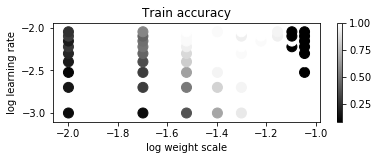

In [19]:
# Visualize the cross-validation results
# import math
marker_size = 100
x_scatter, x_label = [np.log10(x[0]) for x in results], 'log weight scale'
y_scatter, y_label = [np.log10(x[1]) for x in results], 'log learning rate'

# plot validation accuracy
colors = [results[x] for x in results] # default size of markers is 20
plt.subplot(2, 1, 2)
plt.scatter(x_scatter, y_scatter, marker_size, c=colors)
plt.colorbar()
plt.xlabel(x_label)
plt.ylabel(y_label)
plt.title('Train accuracy')
plt.show()

Maintenant, faites la même chose pour un réseau à 5 couches.

0.025683803911710525 0.00025788095927884054 

final loss: 2.29491010908539  train_acc: 0.16


0.015234744289476361 0.009083087049437348 

final loss: 2.2830504546256294  train_acc: 0.16


0.011559015104012341 0.00021951997606717348 

final loss: 2.3029372430705846  train_acc: 0.12


0.040487757840660256 0.0010873492845817018 

final loss: 1.2147396295985398  train_acc: 0.78


0.051575769160984046 0.006169543947673185 

final loss: 0.05769576146828883  train_acc: 1.0


0.024997144271788594 0.0009413620723130041 

final loss: 2.2254994890396658  train_acc: 0.18


0.03803283673939058 0.0006350682121608371 

final loss: 1.8812180736503996  train_acc: 0.38


0.0316102246919718 0.00028484613633481107 

final loss: 2.2678576439873943  train_acc: 0.22


0.07483836523461919 0.0008035735304635726 

final loss: 0.0072098070139620715  train_acc: 1.0


0.04038830171414724 0.0037427208932735837 

final loss: 0.40011197439709817  train_acc: 0.98


0.010275032727102618 0.002267680919411289 

final los

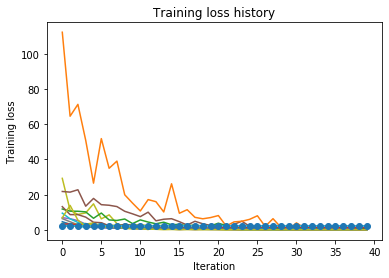

The best learning_rate, weight_scale and training accuracy are 0.03 0.009000000000000001 1.0


In [20]:
num_train = 50
small_data = {
  'X_train': data['X_train'][:num_train],
  'y_train': data['y_train'][:num_train],
  'X_val': data['X_val'],
  'y_val': data['y_val'],
}

##############################################################################
# TODO: Utilisez une instance de Solver pour entrainer un réseau à 5 couches #
#  à 100 neurones à overfitter 50 images de CIFAR10.  Il est suggérer de     #
#  d'effectuer une recherche d'hyperparamètres pour trouver le bon           #
#  `learning_rate` et le bon `weight_scale`.                                 #
##############################################################################

def uniform(minv, maxv):
    return np.random.rand() * (maxv - minv) + minv

results = {}
for _ in range(40):
    weight_scale = 10 ** uniform(-2, -1)
    learning_rate = 10 ** uniform(-4, -2)
    print(weight_scale, learning_rate, '\n')
    
    model = FullyConnectedNeuralNet([100, 100, 100, 100],
                  weight_scale=weight_scale, dtype=np.float64)
    solver = Solver(model, small_data,
                    print_every=10, num_epochs=20, batch_size=25,
                    update_rule='sgd',
                    optim_config={
                      'learning_rate': learning_rate,
                    }, verbose=False)
    solver.train()
    train_acc = solver.train_acc_history[-1]
    print('final loss:', solver.loss_history[-1], ' train_acc:', train_acc)
    print('\n')
    plt.plot(solver.loss_history)
    results[(weight_scale, learning_rate)] = train_acc

plt.plot(solver.loss_history, 'o')
plt.title('Training loss history')
plt.xlabel('Iteration')
plt.ylabel('Training loss')
plt.show()



##############################################################################
#                             FIN DE VOTRE CODE                              #
##############################################################################
#best_weight_scale = 0.
#best_learning_rate = 0.
#best_training_acc = 0.
print('The best learning_rate, weight_scale and training accuracy are',best_weight_scale, best_learning_rate, best_training_acc)

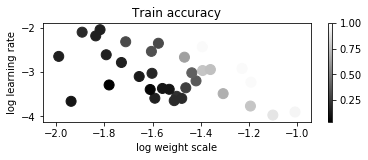

In [21]:
# Visualize the cross-validation results
# import math
marker_size = 100
x_scatter, x_label = [np.log10(x[0]) for x in results], 'log weight scale'
y_scatter, y_label = [np.log10(x[1]) for x in results], 'log learning rate'

# plot validation accuracy
colors = [results[x] for x in results] # default size of markers is 20
plt.subplot(2, 1, 2)
plt.scatter(x_scatter, y_scatter, marker_size, c=colors)
plt.colorbar()
plt.xlabel(x_label)
plt.ylabel(y_label)
plt.title('Train accuracy')
plt.show()

# Descente de gradient ++
Jusqu'à présent nous avons utilisé l'algorithmes de base de la descente de gradient (SGD-stochastic gradient descent). Ici nous testerons d'autres algorithmes plus sophistiqués.

# SGD+Momentum
SGD+momentum est très largement utilisé.  Ouvrez  `ift725/optim.py` et prenez connaissance du code et implémentez la fonction `sgd_momentum` et exécutez la cellule que voici. Votre erreur devrait être inféreieure à 1e-6.

In [22]:
from ift725.optim import sgd_momentum

N, D = 4, 5
w = np.linspace(-0.4, 0.6, num=N*D).reshape(N, D)
dw = np.linspace(-0.6, 0.4, num=N*D).reshape(N, D)
v = np.linspace(0.6, 0.9, num=N*D).reshape(N, D)

config = {'learning_rate': 1e-3, 'velocity': v}
next_w, _ = sgd_momentum(w, dw, config=config)

expected_next_w = np.asarray([
    [-0.39994,    -0.34737526, -0.29481053, -0.24224579, -0.18968105],
    [-0.13711632, -0.08455158, -0.03198684,  0.02057789,  0.07314263],
    [ 0.12570737,  0.17827211,  0.23083684,  0.28340158,  0.33596632],
    [ 0.38853105,  0.44109579,  0.49366053,  0.54622526,  0.59879   ]])
expected_velocity = np.asarray([
    [-0.06 ,       0.00684211,  0.07368421,  0.14052632,  0.20736842],
    [ 0.27421053,  0.34105263,  0.40789474,  0.47473684,  0.54157895],
    [ 0.60842105,  0.67526316,  0.74210526,  0.80894737,  0.87578947],
    [ 0.94263158,  1.00947368,  1.07631579,  1.14315789,  1.21      ]])

# Error should be below 1e-06
print('next_w error: ', rel_error(next_w, expected_next_w))
print('velocity error: ', rel_error(expected_velocity, config['velocity']))

v : [[0.5406     0.55475789 0.56891579 0.58307368 0.59723158]
 [0.61138947 0.62554737 0.63970526 0.65386316 0.66802105]
 [0.68217895 0.69633684 0.71049474 0.72465263 0.73881053]
 [0.75296842 0.76712632 0.78128421 0.79544211 0.8096    ]]
next_w : [[-0.4        -0.34736842 -0.29473684 -0.24210526 -0.18947368]
 [-0.13684211 -0.08421053 -0.03157895  0.02105263  0.07368421]
 [ 0.12631579  0.17894737  0.23157895  0.28421053  0.33684211]
 [ 0.38947368  0.44210526  0.49473684  0.54736842  0.6       ]]
next_w error:  1.0
velocity error:  1.0


Maintenant, excécutez cette cellule.  Normalement, le réseau à 6 couches devrait s'entraîner plus rapidement avec SGD+momentum qu'avec SGD.

running with  sgd
(Iteration 1 / 400) loss: 2.670739
(Epoch 0 / 10) train acc: 0.125000; val_acc: 0.141000
(Iteration 11 / 400) loss: 2.162439
(Iteration 21 / 400) loss: 2.135150
(Iteration 31 / 400) loss: 2.060196
(Epoch 1 / 10) train acc: 0.262000; val_acc: 0.244000
(Iteration 41 / 400) loss: 2.010708
(Iteration 51 / 400) loss: 2.030522
(Iteration 61 / 400) loss: 1.917636
(Iteration 71 / 400) loss: 1.821898
(Epoch 2 / 10) train acc: 0.331000; val_acc: 0.282000
(Iteration 81 / 400) loss: 1.994742
(Iteration 91 / 400) loss: 1.798296
(Iteration 101 / 400) loss: 1.734540
(Iteration 111 / 400) loss: 1.795487
(Epoch 3 / 10) train acc: 0.394000; val_acc: 0.320000
(Iteration 121 / 400) loss: 1.788331
(Iteration 131 / 400) loss: 1.817048
(Iteration 141 / 400) loss: 1.770063
(Iteration 151 / 400) loss: 1.650797
(Epoch 4 / 10) train acc: 0.395000; val_acc: 0.320000
(Iteration 161 / 400) loss: 1.776247
(Iteration 171 / 400) loss: 1.557835
(Iteration 181 / 400) loss: 1.768008
(Iteration 191 / 400

v : [[ 7.01798650e-04 -2.52877217e-04 -1.27445848e-04  3.32460564e-04
   2.64481583e-04 -4.09030064e-04 -5.84767782e-04  5.19575493e-04
  -7.22624172e-05 -3.71932751e-04]
 [ 9.95189603e-03  2.33062077e-04 -5.08501614e-03  6.33886456e-03
   6.71479106e-03 -5.48753142e-03 -2.25176476e-02  8.19924660e-03
  -1.69649371e-03  3.34883342e-03]
 [ 2.41288799e-03  2.01930059e-04 -1.42829726e-03  1.00817403e-03
   1.57902297e-03 -2.08864198e-03 -4.02574986e-03  1.46747928e-03
  -6.68892229e-04  1.54208927e-03]
 [ 1.66367774e-03 -5.69951837e-04  4.63731121e-04  1.39764021e-03
   3.19695653e-04 -1.66890817e-03 -2.95799831e-03  1.87070342e-03
  -7.18626077e-04  2.00037728e-04]
 [ 7.84131349e-04  1.20267156e-03 -9.74743045e-04  7.44398509e-04
   1.74731307e-03 -3.53651878e-04 -3.71778989e-03  1.01909484e-03
  -1.02616125e-03  5.74737671e-04]
 [ 2.94285637e-05  5.21394031e-05  7.37837545e-05 -3.62152787e-05
   1.30378627e-04 -1.09767978e-04  1.13173825e-04  1.19262135e-04
  -2.00203140e-04 -1.71979933

v : [[ 4.44751407e-04  3.72351380e-04  3.86417087e-04 -2.09883976e-04
  -2.97261227e-04 -4.98349546e-04 -3.61602957e-04  2.67713156e-04
  -9.66997613e-05 -7.43547571e-06]
 [ 4.39660065e-03 -2.86614522e-04  1.91731961e-04  6.86006621e-04
   2.78062397e-03 -1.62642961e-03 -1.54318232e-02  3.85252270e-03
   4.51218628e-04  4.98616975e-03]
 [-1.06881745e-03 -4.63572156e-04  1.13176263e-03 -1.90005731e-03
  -3.66988126e-04  9.79450415e-05 -6.85020234e-04  2.42956856e-04
  -3.48304719e-04  3.36009520e-03]
 [-7.39496434e-04 -2.10000551e-03  2.81238370e-03  4.55974950e-05
  -1.09446817e-03  6.54268428e-04 -1.28402049e-03  2.87488918e-04
  -2.64699804e-04  1.68295298e-03]
 [ 1.09540211e-04  8.62730376e-04 -1.98917216e-04  9.61202750e-05
   1.17688486e-03 -5.51240926e-04 -2.35848874e-03  7.84649223e-04
  -7.74601533e-04  8.53324309e-04]
 [-8.77097482e-05  1.30703469e-04  2.70506571e-04 -1.23320409e-04
   9.33362244e-05 -1.35573966e-04  1.67544713e-04 -4.60775555e-05
  -2.53314065e-04 -1.60952477

next_w : [-4.85744677e-05 -9.83771868e-04 -1.54805137e-04  9.97416209e-05
 -3.09229072e-04 -5.42130510e-05  2.16001543e-04  2.09053993e-04
 -7.87897909e-04 -9.79902456e-04 -3.61278711e-04  1.14781265e-04
 -7.65277509e-05 -6.74049195e-04 -5.19057103e-05  0.00000000e+00
 -1.65004676e-04  1.88011509e-05  3.13746743e-04  1.16497817e-04
  9.73928618e-05 -2.46365380e-06  2.33442566e-04 -2.74078280e-04
 -1.26008556e-04 -1.76167814e-04  2.04467215e-05 -2.46803802e-06
  7.47872546e-05  2.51652848e-04  2.78947584e-04  1.33453534e-04
 -3.57119483e-04 -4.21355653e-04 -7.27643259e-04 -2.13891835e-04
 -4.02376754e-04  1.96746711e-04  0.00000000e+00 -1.20149547e-04
  3.56641482e-04  1.19866228e-04 -1.16906594e-05 -1.77198293e-04
 -3.53871947e-05 -5.02667041e-04  9.91673187e-06  4.38781644e-05
 -1.49044470e-04 -2.04642856e-04 -1.68634127e-04  2.43747781e-04
 -2.39686546e-04 -2.85791684e-05  7.87860918e-05 -3.36114113e-04
 -4.65174729e-04 -6.72002847e-04 -1.06262672e-03  1.43028767e-04
  1.91348881e-05

v : [[ 1.84722897e-03 -7.32161803e-04  4.96079796e-04  6.03552267e-04
  -8.34193896e-04 -1.35628809e-03  7.45833036e-04  8.33774917e-04
  -1.22127985e-03 -3.82545346e-04]
 [ 4.43377811e-03 -1.72539870e-03  1.03267026e-04  4.81217867e-04
  -7.23093399e-06 -1.41494197e-03 -9.29546729e-03  3.00044427e-03
   9.85714258e-04  3.43862409e-03]
 [-1.33832928e-03 -6.36359677e-04  9.20534774e-04 -1.82701845e-03
  -1.21115474e-03  2.03761645e-03  4.98525915e-04 -3.34153214e-04
  -5.27808617e-04  2.41814693e-03]
 [ 8.28510383e-04 -2.75052385e-03  2.57074228e-03  6.38405094e-04
  -2.66801403e-03 -2.14214320e-04  1.10395427e-03  6.85097824e-04
  -5.98464510e-04  4.04507213e-04]
 [-1.32920803e-04  6.39429840e-04 -1.61716976e-04  5.49353354e-05
   5.21782553e-04 -2.81213608e-04 -1.02802261e-03  2.91419856e-04
  -6.83689723e-04  7.79996626e-04]
 [-2.66926945e-04 -1.61391567e-04  2.73005338e-04 -7.04937775e-05
  -4.90753773e-05 -2.97344115e-04  5.06208104e-04  4.56820635e-05
  -2.78804189e-04  2.99140374

v : [[-9.9665471e-05 -4.4972374e-05  6.6143824e-05 ... -3.6695797e-05
   1.0410980e-04  1.2262040e-04]
 [-1.0160123e-04 -4.7524678e-05  5.3780241e-05 ... -2.8647311e-05
   1.0305419e-04  1.2260249e-04]
 [-9.5975694e-05 -5.1160634e-05  4.3811375e-05 ... -1.7317281e-05
   1.1453664e-04  9.5582633e-05]
 ...
 [-1.2311069e-04  1.8682107e-05  3.0376059e-05 ...  1.4325045e-04
  -1.8671128e-05  6.8803645e-05]
 [-1.2096169e-04  2.3003888e-05  4.0154835e-05 ...  1.4358677e-04
  -1.2249047e-05  7.0861453e-05]
 [-8.9143345e-05  3.0959480e-05  3.4338271e-05 ...  1.3024091e-04
  -1.7354994e-05  9.0667629e-05]]
next_w : [[-0.00521655  0.01890071  0.01434452 ... -0.08015019  0.07565189
   0.04242472]
 [-0.06493107  0.03888608  0.0405204  ... -0.07118737 -0.07143267
  -0.00956866]
 [ 0.00159817 -0.11727459  0.06734385 ... -0.06789613 -0.08564316
   0.01009773]
 ...
 [ 0.01768687 -0.03188209 -0.02445696 ... -0.00876063  0.06856114
   0.1134702 ]
 [-0.0801395   0.01954605  0.02444941 ... -0.01064578  0.0

v : [[ 3.02234502e-03  3.99540993e-04 -1.85691670e-03 -4.82596981e-04
   9.66329244e-04  1.21356291e-03 -5.16160275e-04 -1.90968596e-04
  -1.97140104e-03 -5.83733025e-04]
 [ 5.54512255e-03 -5.71058248e-04 -3.38989263e-03  9.65089770e-04
  -8.96634243e-04  6.99425524e-04 -6.74035400e-03  1.11784937e-03
   1.48634461e-03  1.78411207e-03]
 [-6.37335761e-04 -5.15556079e-04  3.51935712e-04 -1.14520406e-03
  -5.95211459e-04  1.25083700e-03  1.81271971e-04  1.44904494e-04
  -5.44096110e-04  1.50845433e-03]
 [ 2.83677131e-03 -1.27450272e-03  4.75305133e-05  2.21534647e-04
  -8.51269229e-04  1.90141564e-03 -4.42744931e-05 -7.46497535e-04
  -1.52779522e-03 -5.62912319e-04]
 [-4.76708927e-04  6.21596584e-04  2.38455774e-04 -3.54518386e-04
   5.75405487e-04  3.39320861e-04 -9.28895432e-04  1.82475487e-04
  -7.07053696e-04  5.09922684e-04]
 [-2.71160359e-04  9.33444426e-07  1.10564230e-04 -8.10379715e-05
  -5.98588667e-05  2.99405219e-05  2.38324516e-04  9.68168933e-06
  -3.12307704e-04  3.34920420

v : [[-2.0063912e-05 -8.1175167e-05 -3.6830941e-05 ... -4.1518884e-05
   6.4532709e-05  7.8451776e-05]
 [-2.2220884e-05 -7.9918434e-05 -4.0037474e-05 ... -2.6081841e-05
   5.2968346e-05  7.6065066e-05]
 [-8.4902003e-06 -7.6766177e-05 -3.7000398e-05 ... -6.1923711e-06
   7.0116206e-05  5.4898432e-05]
 ...
 [-4.0590439e-05 -8.9100809e-05  5.2758052e-05 ...  2.7553455e-05
  -1.5682028e-05  5.1057286e-05]
 [-4.9206134e-05 -6.8068999e-05  6.1182342e-05 ...  4.2092492e-05
  -7.5658645e-06  6.2478779e-05]
 [-1.8889932e-05 -3.6436486e-05  4.2009946e-05 ...  4.3383661e-05
  -1.5845508e-05  8.9273250e-05]]
next_w : [[-0.00543571  0.01884948  0.01449551 ... -0.08023233  0.07594357
   0.04284852]
 [-0.06516731  0.03880014  0.04063052 ... -0.07121301 -0.07116026
  -0.00916607]
 [ 0.00141428 -0.11736159  0.06743223 ... -0.06783946 -0.08534313
   0.01041326]
 ...
 [ 0.0173241  -0.03189228 -0.02436662 ... -0.00834064  0.06855913
   0.11360092]
 [-0.08052699  0.01956317  0.02458776 ... -0.01021913  0.0

v : [[-2.32380698e-05 -9.64008650e-05 -7.42381872e-07 ... -4.47988532e-05
   5.81766835e-05  4.02649457e-05]
 [-2.38992670e-05 -9.81247722e-05  1.87669093e-06 ... -4.33693785e-05
   5.19371060e-05  8.99802762e-06]
 [-6.66456981e-06 -1.02314312e-04  1.04619912e-05 ... -2.96688104e-05
   6.32735901e-05 -1.94255517e-05]
 ...
 [-6.29556162e-05 -1.92895259e-05  1.61189055e-05 ...  2.10239268e-05
  -1.51753375e-05  1.87499827e-05]
 [-8.90957308e-05 -1.83097982e-05  4.10318644e-05 ...  2.76312694e-05
  -3.08184099e-07  1.58096409e-05]
 [-5.71362907e-05  1.92879997e-06  2.95625814e-05 ...  7.53271115e-06
  -5.46714728e-06  3.07753580e-05]]
next_w : [[-0.00547177  0.01866253  0.01446671 ... -0.08036608  0.07607485
   0.04288147]
 [-0.06520561  0.03861562  0.04059619 ... -0.07131419 -0.07105324
  -0.00913408]
 [ 0.0014061  -0.11754964  0.06740263 ... -0.06790575 -0.08520669
   0.01040133]
 ...
 [ 0.01724541 -0.03202786 -0.02428962 ... -0.00830125  0.06856353
   0.11365815]
 [-0.08063027  0.01944

next_w : [[ 1.89596713e-02 -3.42898071e-02  9.19186175e-02 -6.94297627e-03
  -6.75112940e-04  5.64620132e-03  2.28054840e-02 -3.93206850e-02
   4.86915978e-03  5.57121709e-02]
 [ 4.13702726e-02 -1.87910236e-02  3.40837874e-02  4.06171456e-02
  -6.39826953e-02 -5.14738299e-02 -9.22019109e-02  4.70339730e-02
   6.24304935e-02  9.91522670e-02]
 [-5.11231786e-03 -7.13107781e-03 -4.26403992e-02 -2.07784493e-02
   1.12034203e-02  1.00958031e-02 -2.58169286e-02  1.86899137e-02
   7.54134962e-03 -2.86870766e-02]
 [ 8.01777542e-02  3.56708504e-02  7.85842761e-02  1.94778182e-02
   1.20876245e-02 -1.44446827e-02  2.13260613e-02  5.51710762e-02
   1.49347661e-02 -1.17406817e-02]
 [-4.35109809e-02 -4.28007245e-02 -5.21085151e-02  1.17184361e-02
  -1.33646745e-02 -4.65465263e-02  5.48358075e-02  8.38364959e-02
  -1.00022340e-02  7.94956647e-03]
 [ 1.60351731e-02  1.67635754e-02 -2.24937405e-03  1.88925434e-02
   1.04006650e-02  1.24575924e-02 -9.56668705e-02 -6.98571606e-03
   4.25239187e-03  2.047

v : [[ 9.21166211e-04  1.77284033e-04 -4.99885064e-04 -7.70162442e-04
   2.32108985e-03  1.38856412e-03  6.78404875e-04 -5.64980786e-04
  -2.00920738e-03 -1.64227211e-03]
 [ 1.13211898e-03 -1.73620880e-03 -8.85415240e-04  7.63507793e-04
   3.22513748e-03  1.53894071e-03 -2.40969541e-03  3.85404797e-04
  -4.21322999e-04 -1.59246381e-03]
 [-2.82555207e-04 -1.36935298e-04  1.00842764e-04 -4.92273015e-04
  -6.90290472e-04 -2.53361039e-04  5.97564387e-04  5.28560719e-04
  -1.68137864e-04  7.96584995e-04]
 [ 2.98176019e-05  2.09129270e-04  7.73500244e-04  3.79058591e-04
  -5.01416740e-04  9.28726164e-04 -7.47665908e-05 -6.55781361e-04
  -3.30283219e-04 -7.57983478e-04]
 [-1.58349183e-04  5.65339811e-04 -1.25889947e-05 -9.36714496e-05
   4.07183339e-04  3.34248238e-04 -4.38260526e-04  2.92637909e-04
  -8.36732797e-04 -5.98061888e-05]
 [ 2.42211885e-04 -1.22360920e-03 -6.96134666e-05  5.42581605e-04
   4.05219907e-04  2.81033252e-04  8.51482910e-05  5.21964277e-04
  -5.58653031e-04 -2.26283344

  3.70535476e-04  1.38892152e-04 -1.41925539e-03 -3.55105498e-04]
v : [[ 7.53414701e-04 -7.11207103e-04 -8.51077319e-04 -1.07344764e-03
   2.24446249e-03  2.59863539e-03 -6.95392955e-05 -7.82321848e-04
  -1.08156935e-03 -1.02734985e-03]
 [ 1.02444168e-03 -4.71585616e-03 -1.66143302e-03  1.10683520e-03
   2.84214434e-03  2.40762555e-03 -1.74496905e-03  1.07925385e-03
   6.12561125e-04 -9.50600486e-04]
 [-1.69052699e-04 -1.41442113e-04 -1.19670665e-04 -4.50955005e-04
  -5.19506459e-04  2.79469095e-04  3.34435055e-04  3.16152844e-04
  -1.44615711e-04  6.15185767e-04]
 [ 3.52182338e-04 -1.65368590e-04 -1.33312540e-04  4.73377062e-04
  -4.06704086e-04  1.17325340e-03 -2.20177353e-05 -5.38161257e-04
  -1.42406294e-04 -5.90841984e-04]
 [ 7.91079801e-05  1.66342943e-07 -5.47901436e-07 -1.43283367e-04
   4.91095416e-04  2.31625600e-04 -2.42170907e-04  4.32647706e-04
  -8.20551941e-04 -2.80887980e-05]
 [ 3.08398565e-04 -1.65534648e-03 -9.84519284e-05  3.78570199e-04
   3.72261537e-04  1.37741386

v : [[-3.7742961e-05 -3.9693248e-04 -1.7702644e-04 ...  4.6492070e-05
  -6.3292726e-05 -4.0714938e-05]
 [-2.6898622e-05 -6.0327016e-05  3.6719688e-05 ...  1.7581857e-05
   5.1013144e-06 -1.0239247e-06]
 [-1.9057852e-04 -7.5395132e-04  4.7126139e-04 ... -3.6460330e-04
  -4.4282491e-04 -3.8119461e-04]
 ...
 [-5.5861106e-04  3.4886462e-04 -2.8478765e-04 ... -2.3966738e-04
  -3.5419132e-04  4.3220123e-05]
 [-6.7731726e-06 -7.3880088e-05  5.6502362e-05 ...  9.4304523e-06
  -6.5044354e-05  5.3299027e-06]
 [-2.9552844e-04  3.2688514e-04  4.8958510e-04 ... -8.7173896e-05
  -3.0217913e-04 -6.0466511e-05]]
next_w : [[-1.0182650e-01 -3.4870319e-02 -5.0768685e-02 ... -4.3647625e-02
   1.9506732e-02 -9.3669724e-03]
 [ 2.0042746e-03  2.4306634e-02 -1.2562285e-01 ...  6.1075552e-03
  -1.2448512e-02 -4.7710534e-02]
 [-3.3722136e-02  6.4229503e-02  2.3963196e-02 ... -3.5162747e-02
   1.5983678e-02  3.9022140e-02]
 ...
 [-1.2018532e-02  3.7326161e-02 -1.1531013e-02 ... -7.9198696e-02
   6.7581015e-05  4

v : [[-3.00750835e-05  1.85035969e-05 -3.57340832e-06 ... -5.13705272e-05
   1.65462261e-05 -8.71983866e-05]
 [-4.58159993e-05  8.95744779e-06  3.90201967e-06 ... -6.47240886e-05
   3.17113154e-05 -1.09254426e-04]
 [-3.01615364e-05 -1.15706862e-05  8.13868428e-06 ... -5.60595545e-05
   2.12803916e-05 -1.28274682e-04]
 ...
 [ 2.97565275e-05  6.88075579e-06  4.40688018e-05 ... -1.11324618e-04
   1.30873144e-04 -1.61605029e-04]
 [ 8.04332922e-06  1.35999617e-05  5.21802212e-05 ... -8.83133980e-05
   1.35967406e-04 -1.65765261e-04]
 [ 2.64833179e-05  2.32233833e-05  3.41296982e-05 ... -7.61713018e-05
   1.25321429e-04 -1.70015905e-04]]
next_w : [[-0.00538819  0.01819617  0.01419336 ... -0.08085122  0.07583456
   0.04257045]
 [-0.06520358  0.03814873  0.04045006 ... -0.07200183 -0.07119592
  -0.00963568]
 [ 0.00156115 -0.11809349  0.06735339 ... -0.06857838 -0.08535571
   0.00968083]
 ...
 [ 0.01688002 -0.03211773 -0.02395914 ... -0.0085405   0.06904453
   0.11287997]
 [-0.08112117  0.01936

v : [[ 2.4950993e-04  4.4204737e-04  4.6544825e-04 ... -9.0657605e-04
   5.6475874e-06 -2.9975492e-05]
 [ 5.5760850e-04  3.9115251e-04  6.8028283e-04 ... -5.3385843e-04
  -3.8156541e-06 -5.8873958e-04]
 [ 5.6052697e-04 -5.6979876e-05  1.0897690e-04 ... -6.8422043e-05
   3.2258275e-04 -2.0337735e-04]
 ...
 [ 3.6035239e-04  8.5338470e-05  1.0533282e-03 ... -2.3720320e-04
  -5.1597672e-06 -9.7897311e-04]
 [-2.3372592e-04  8.9166235e-05  2.1261888e-04 ... -5.3029967e-04
   4.4805784e-04 -2.6356993e-04]
 [ 4.3844467e-04  1.1320182e-05  2.7810669e-04 ... -2.3508901e-04
  -4.8207614e-05 -7.0712523e-04]]
next_w : [[-0.01047456  0.00998175 -0.00323853 ... -0.02457918 -0.04848047
   0.0211257 ]
 [ 0.05340002  0.01968413 -0.07460652 ... -0.00432779 -0.0014052
   0.06073367]
 [ 0.00656285  0.01014301 -0.01815885 ... -0.0206831   0.02950983
   0.06291137]
 ...
 [ 0.00509519  0.01803812 -0.02411511 ... -0.05360432  0.00919383
  -0.00993638]
 [-0.01292664  0.02131298  0.00231785 ...  0.06278824  0.00

v : [[-3.61369894e-05  6.59357524e-04 -1.14426063e-03 -3.36180994e-04
   6.00446947e-06  4.88733116e-04 -6.14413511e-05  2.52539525e-04
   9.21497995e-05  7.92352366e-05]
 [-7.22880883e-04  2.70536449e-03 -1.67187373e-03  1.57457357e-03
  -2.00294948e-04 -7.19568285e-04 -1.95428892e-03  1.28192478e-05
   1.14722922e-03 -1.71078485e-04]
 [-6.55547410e-05  4.41285738e-06 -2.39744608e-04 -6.18227714e-05
  -7.32799410e-04  8.45309478e-06  2.03759715e-04  7.94257096e-04
  -1.35750903e-04  2.24789765e-04]
 [ 1.24383240e-03 -1.89620332e-04 -1.44940117e-04  4.68606304e-04
   8.07690085e-05 -1.15161667e-04 -1.78674032e-04 -5.01305272e-04
  -3.83591338e-04 -2.79914675e-04]
 [-1.31340712e-04  1.61549740e-03 -9.89773907e-05 -4.22037410e-04
  -2.11838575e-04 -2.70799763e-04 -3.29354662e-04  9.24154185e-04
  -6.19524653e-05 -1.01335044e-03]
 [ 3.41150240e-04 -5.15865278e-04 -1.77271344e-04  9.89358086e-05
   1.16509385e-04 -4.73238106e-05  2.21884002e-05  2.72748119e-04
  -1.06833839e-04 -4.23759411

v : [[ 1.94726163e-05  4.38826450e-04  4.74956178e-05 ...  1.76466157e-04
  -6.28717316e-05  5.40517736e-04]
 [ 1.33562047e-04 -5.00816095e-04  1.31579873e-05 ...  3.82211816e-04
  -6.67534596e-06  9.88620814e-05]
 [ 1.55705507e-04 -1.22554149e-04 -4.06267936e-05 ...  1.06382016e-04
  -1.38485905e-06  4.17295290e-04]
 ...
 [-1.03128885e-04  4.90000457e-06 -7.21726465e-05 ... -2.18481582e-04
  -3.81182181e-05  1.67389677e-04]
 [-3.80029701e-06 -3.64185944e-05  8.44431634e-06 ...  1.86529905e-06
  -7.56637775e-08  5.05319258e-06]
 [-1.45363656e-05 -7.28954183e-06  5.59239015e-06 ... -1.02327776e-05
  -3.67179405e-06 -1.41571581e-05]]
next_w : [[ 0.03262828  0.07513908 -0.05549907 ... -0.04386915 -0.02595785
  -0.0784241 ]
 [-0.05276288 -0.05245116 -0.0703374  ... -0.01615283 -0.02280286
   0.06042606]
 [ 0.01245011  0.04087705  0.003679   ...  0.04085033 -0.01074445
   0.00862163]
 ...
 [-0.09703609  0.00016861 -0.02742739 ...  0.05496176  0.02783207
   0.05339568]
 [ 0.0066258  -0.04775

next_w : [[ 2.53598522e-02 -3.00640576e-02  8.13550577e-02 -1.48309926e-02
   7.23439083e-03  1.80337317e-02  2.41698045e-02 -4.09422368e-02
  -4.27639252e-03  5.26435822e-02]
 [ 4.49097492e-02 -2.41508074e-02  1.45213259e-02  5.61953485e-02
  -4.77234945e-02 -4.79945727e-02 -1.20286793e-01  4.35644202e-02
   7.82954991e-02  1.00907832e-01]
 [-7.65321264e-03 -8.65890644e-03 -4.34497334e-02 -2.38739755e-02
   2.39151763e-03  1.00822393e-02 -2.15765294e-02  2.66920067e-02
   5.65333385e-03 -2.22425070e-02]
 [ 9.22188237e-02  3.49362381e-02  7.92309642e-02  2.42722537e-02
   8.75255000e-03 -7.73860933e-03  1.93284228e-02  4.84486260e-02
   1.00497892e-02 -1.82542279e-02]
 [-4.62015159e-02 -3.19228768e-02 -5.28649352e-02  8.51526298e-03
  -1.21566383e-02 -4.66216169e-02  5.05492985e-02  8.84305835e-02
  -1.62075143e-02  8.48663226e-03]
 [ 1.86290033e-02  4.43235226e-03 -3.79672577e-03  2.26367097e-02
   1.31424135e-02  1.29625276e-02 -9.50215831e-02 -2.49178079e-03
   2.64839898e-03  2.123

v : [[-4.79824899e-04 -8.86941329e-04  8.28027958e-04  1.02321646e-05
   9.07786598e-04 -2.71138560e-06 -2.99425534e-04 -4.36943112e-04
   1.40014352e-04  2.19784983e-04]
 [-3.47660342e-03 -1.61950511e-03  2.66191945e-03  1.08213897e-03
  -1.73739088e-03  4.87765181e-04 -2.32063606e-03 -8.54320300e-04
   4.75610653e-03  1.02052628e-03]
 [ 6.58915860e-06  2.85705959e-04  4.98066947e-06 -9.09735172e-05
  -4.32640489e-04 -1.09664601e-04  9.42701809e-05  2.45442119e-04
  -9.97174939e-05  9.60080069e-05]
 [ 1.05640502e-04 -3.78702622e-04  8.80529988e-04  5.83157991e-04
   4.41588636e-05 -2.81730376e-04 -1.57664181e-04 -4.53758461e-04
   5.41417976e-05 -3.95773328e-04]
 [-4.82935866e-04  1.02649629e-03 -1.15479321e-04 -3.16960562e-04
  -7.56009540e-04 -2.37556262e-04 -3.75488249e-04  3.30018898e-04
  -2.59307737e-04  1.18722231e-03]
 [-8.56413462e-05 -5.74656588e-04  1.85030061e-04  1.17162726e-05
  -2.01649178e-04 -1.17823591e-04 -4.13688285e-05  1.24693543e-04
   4.63127741e-04  2.36571825

v : [[-2.96800717e-04 -7.07754865e-04  8.98486236e-04  9.17698024e-04
   5.29181561e-04 -5.22093382e-04 -3.46323242e-04 -5.21143258e-04
   9.53992421e-05 -4.66497149e-05]
 [-5.38258441e-03  5.91291813e-04  3.29763372e-03  2.04189075e-03
  -2.32387334e-03 -6.40032522e-05 -1.82254834e-03  8.00859299e-04
   1.82254054e-03  1.03879278e-03]
 [ 7.73238753e-08  2.50091951e-04 -8.74087891e-06 -9.92754722e-05
  -4.12635156e-04 -1.07751475e-04  1.89100378e-04  1.96254608e-04
  -9.09373775e-05  8.38161068e-05]
 [-2.93710473e-04 -2.66859686e-04  1.18427409e-03  6.78576529e-04
   1.35262362e-05 -5.44189126e-04  9.00476298e-05 -9.00645973e-05
  -3.18114617e-04 -4.53485845e-04]
 [-3.60027305e-04  9.82840313e-04 -1.31046661e-04 -2.30875201e-04
  -7.30285130e-04 -1.66443744e-04 -3.53957294e-04  2.18360568e-04
  -3.59822472e-04  1.13125681e-03]
 [-3.09225725e-04 -2.53037811e-04  2.67130672e-04 -2.23807947e-05
  -2.26854550e-04 -1.36335206e-04 -1.47161882e-05  9.25864442e-05
   2.79159576e-04  3.23673594

v : [[-2.4343710e-05 -4.8218582e-05 -8.7701614e-05 ...  2.4073877e-05
  -3.1862575e-05 -9.9766767e-06]
 [-2.2256214e-05 -9.4512507e-06  3.5066623e-05 ...  2.0321942e-05
   6.8647628e-06 -1.7988228e-05]
 [-3.5254518e-04 -1.4059924e-04  1.9980002e-04 ... -1.0083078e-04
  -9.1053327e-05 -1.5342688e-04]
 ...
 [-3.3921184e-04  5.8989832e-04  2.6145353e-04 ...  8.3104664e-05
  -3.3407916e-05  1.1970009e-05]
 [-9.2765171e-05  1.5871764e-04  1.7852877e-04 ... -1.0866454e-04
  -5.4309574e-05 -1.4612460e-05]
 [-3.5717656e-04  7.2501221e-04  2.8354180e-04 ... -3.3239572e-05
   3.1707375e-04  2.1540796e-05]]
next_w : [[-0.10177481 -0.03846832 -0.05150904 ... -0.0432329   0.01900761
  -0.00952573]
 [ 0.00178589  0.02400213 -0.12499657 ...  0.00650254 -0.0124096
  -0.04794931]
 [-0.0381828   0.05029204  0.03031597 ... -0.03114311  0.01296843
   0.038309  ]
 ...
 [-0.01972482  0.0402263  -0.01059403 ... -0.08062865 -0.00201245
   0.04698552]
 [-0.02512146 -0.03494376 -0.08839566 ... -0.00710973 -0.00

v : [[ 1.67139957e-03  3.71051487e-04  6.36460725e-04  1.14225026e-04
   1.24720368e-03 -5.29264915e-04 -1.77822995e-03 -1.56701572e-04
  -9.74071037e-04 -6.02073269e-04]
 [ 4.34269570e-03  6.64043473e-05  1.35870150e-03 -9.46003245e-04
   2.03003082e-03 -8.61650333e-04 -1.24101189e-03  1.91080756e-03
  -3.66321951e-03 -2.99675483e-03]
 [-3.15552734e-06  2.05310935e-04 -2.40973932e-05 -4.16317744e-05
  -2.99922918e-04 -5.59680448e-05  1.10975467e-04  1.17940494e-04
  -6.77335920e-05  5.82823595e-05]
 [ 5.95660938e-04 -3.67276836e-04  6.15446188e-04  2.08035606e-04
   5.51054312e-04 -8.44493101e-04  1.75259702e-05 -1.53455694e-05
  -2.70260032e-04 -4.90347564e-04]
 [ 5.38120512e-04  4.80801886e-04  6.60928490e-05 -4.03136044e-04
  -4.25280828e-04 -2.12480227e-04 -3.11545387e-04  4.48016450e-04
   1.16965966e-04 -2.97555234e-04]
 [ 7.88046513e-04 -2.72741367e-04  4.48231265e-04 -2.01572315e-04
   2.06098062e-04 -9.47773151e-05 -2.04108710e-06  1.24616810e-04
  -9.03776730e-04 -9.20837047

v : [[-7.09228516e-06  6.73449395e-05  2.00884278e-05 ... -4.48529499e-05
  -6.14916789e-05 -7.55769433e-05]
 [-1.97015343e-05  5.95197052e-05  2.85611532e-05 ... -6.16550897e-05
  -7.40461473e-05 -1.07557615e-04]
 [-2.09427708e-05  6.75389092e-05  4.15485010e-06 ... -6.32971933e-06
  -8.53012389e-05 -9.06386049e-05]
 ...
 [ 4.04062339e-05  1.50430078e-05  1.15504350e-04 ...  3.24468638e-05
   2.04574389e-05 -7.08721564e-05]
 [-3.00550528e-06  5.33417187e-06  1.21000397e-04 ...  4.92064864e-05
   3.84376108e-05 -4.99260896e-05]
 [-3.25254587e-05  7.98581914e-06  1.00008372e-04 ...  6.07846268e-05
   3.60919003e-05 -4.29381435e-05]]
next_w : [[-0.00504385  0.01891058  0.01409032 ... -0.08113648  0.07579105
   0.04086299]
 [-0.06497718  0.03872735  0.0405175  ... -0.07273551 -0.07107732
  -0.01158868]
 [ 0.00194155 -0.11773359  0.06732887 ... -0.06911772 -0.08523796
   0.00771953]
 ...
 [ 0.01750486 -0.03225419 -0.02235508 ... -0.00957131  0.07026935
   0.1113681 ]
 [-0.08097053  0.01917

next_w : [[ 2.82093082e-02 -3.12656946e-02  8.58185589e-02 -1.27314972e-02
   1.54120736e-02  1.41862500e-02  1.55853955e-02 -4.14390042e-02
  -6.07311260e-03  5.09804487e-02]
 [ 3.75082046e-02 -1.88011322e-02  3.28373611e-02  5.73215894e-02
  -5.00239506e-02 -5.40348589e-02 -1.36973888e-01  4.92051616e-02
   8.16794708e-02  9.95205268e-02]
 [-7.65718985e-03 -6.72900164e-03 -4.38054129e-02 -2.44596805e-02
  -1.03513815e-03  9.66580585e-03 -2.04062127e-02  2.84246411e-02
   4.89208335e-03 -2.15256587e-02]
 [ 9.54615101e-02  3.18467617e-02  8.51844996e-02  2.80938912e-02
   1.20995855e-02 -1.32375304e-02  1.86579227e-02  4.79107611e-02
   7.90929236e-03 -2.26818603e-02]
 [-4.67107072e-02 -2.34235320e-02 -5.30254953e-02  4.94059175e-03
  -1.74832903e-02 -4.84909788e-02  4.72107828e-02  9.06793326e-02
  -1.69190653e-02  1.32290544e-02]
 [ 2.02473104e-02  9.82949277e-04 -1.07959821e-03  2.16872469e-02
   1.26692010e-02  1.21582672e-02 -9.51738730e-02 -1.57103222e-03
   1.99425942e-03  2.245

v : [[-1.20298471e-03 -5.49621938e-04 -3.37665202e-04 -5.11378341e-04
   1.97633356e-03  4.85519849e-04 -1.38317980e-03  2.06922297e-03
   5.44718932e-06 -5.51693782e-04]
 [-2.80020060e-03  9.57439304e-04  1.70526817e-03 -1.89369614e-03
   2.12028669e-03 -2.13682695e-04 -1.43957359e-03  1.59090513e-03
   1.67223951e-03 -1.69898616e-03]
 [-6.40425151e-06  1.12528272e-04 -2.67001342e-05 -4.06990366e-05
  -1.60944241e-04 -8.72597047e-06  8.67622439e-05  5.73678626e-05
  -4.30595428e-05  2.98748091e-05]
 [-1.05016585e-03 -7.85668846e-04  1.20557111e-03 -6.49582435e-05
   5.67739655e-04 -5.04800875e-04  1.60274591e-04  7.67157180e-04
   1.88329373e-04 -4.83478187e-04]
 [ 5.28509205e-04  3.82059079e-04  5.21356123e-05 -2.71891302e-04
  -1.23602440e-04 -1.80525167e-04 -4.39781928e-04  7.86755409e-05
   5.05802105e-04 -5.31380763e-04]
 [-1.40981190e-03 -2.72167876e-04  7.88125210e-04 -4.30229731e-04
   6.71150745e-04 -4.48968276e-05 -6.62723833e-05  1.44844147e-04
   7.67571270e-04 -1.48313164

v : [[-3.53692631e-05 -6.00464118e-05  5.32191298e-05 ... -1.11244866e-04
   1.95614575e-05  1.41264863e-05]
 [-3.48009271e-05 -7.57242888e-05  6.37720368e-05 ... -1.40377379e-04
   1.79287181e-05  7.63262506e-06]
 [-4.12118898e-05 -5.48657954e-05  5.49850083e-05 ... -8.61804801e-05
   1.37672068e-05 -3.13953933e-06]
 ...
 [-7.98867495e-06 -4.59824369e-05  8.89850126e-05 ... -1.37782627e-06
   1.02712060e-04  2.11225470e-05]
 [-3.92177390e-05 -4.56810376e-05  6.48628629e-05 ...  2.24825872e-05
   1.14705785e-04  4.33220339e-05]
 [-6.27245463e-05 -4.43562858e-05  6.29106216e-05 ...  3.68656692e-05
   1.20262594e-04  7.78494868e-05]]
next_w : [[-0.00507459  0.01881861  0.01428288 ... -0.0815354   0.07568146
   0.04041074]
 [-0.06500968  0.03854949  0.04074332 ... -0.07322507 -0.07126807
  -0.01216199]
 [ 0.00191205 -0.11786909  0.06747532 ... -0.069336   -0.08546133
   0.00720221]
 ...
 [ 0.01767047 -0.03235571 -0.02178863 ... -0.00962624  0.07053694
   0.1111332 ]
 [-0.08097824  0.01903

next_w : [[ 2.34557837e-02 -3.35553922e-02  8.17491785e-02 -1.53769879e-02
   2.26071328e-02  1.59115344e-02  1.14370491e-02 -3.17081437e-02
  -3.85149894e-03  4.80140708e-02]
 [ 2.88193747e-02 -1.55744078e-02  3.48970257e-02  4.69183251e-02
  -3.94073501e-02 -5.62803634e-02 -1.43892258e-01  5.64912632e-02
   9.08850208e-02  9.53818560e-02]
 [-7.65174907e-03 -6.17069099e-03 -4.39427793e-02 -2.46418864e-02
  -1.83040486e-03  9.62940883e-03 -2.00249180e-02  2.87110582e-02
   4.66339430e-03 -2.13771928e-02]
 [ 9.24803466e-02  2.81522907e-02  8.88188258e-02  2.79425122e-02
   1.58211719e-02 -1.60848163e-02  1.94232389e-02  5.13308160e-02
   8.45614821e-03 -2.50957105e-02]
 [-4.45758067e-02 -2.20317449e-02 -5.30565195e-02  3.51696834e-03
  -1.83976721e-02 -4.90699485e-02  4.52665165e-02  9.12297666e-02
  -1.38739515e-02  1.09991059e-02]
 [ 1.42220287e-02 -6.78826182e-05  8.52394383e-04  1.97857283e-02
   1.52547844e-02  1.20629966e-02 -9.55634415e-02 -1.42711040e-03
   6.05044421e-03  2.320

v : [[-9.77677992e-05 -9.98140677e-05  1.05956693e-04 ... -5.63291906e-06
  -6.14776727e-05  6.32609153e-05]
 [-6.96946081e-05 -1.06349129e-04  1.18168115e-04 ... -3.74180308e-05
  -5.45241746e-05  4.44857324e-05]
 [-5.67561401e-05 -7.77620007e-05  9.36103970e-05 ...  3.18667044e-05
  -7.04015256e-05  3.35295917e-05]
 ...
 [-5.34412175e-05 -7.72095809e-05  8.96764323e-05 ... -6.09708422e-06
   1.08055247e-05  5.17791850e-05]
 [-8.06194730e-05 -8.85092159e-05  7.90873746e-05 ... -3.06976981e-05
   6.05455825e-05  4.27842097e-05]
 [-8.53697129e-05 -1.03882136e-04  9.88577813e-05 ... -4.73150903e-05
   9.33038245e-05  6.00223502e-05]]
next_w : [[-0.00528638  0.01834878  0.01473008 ... -0.08179551  0.07561833
   0.04076264]
 [-0.0651678   0.03804849  0.0412093  ... -0.0736087  -0.07131632
  -0.01182668]
 [ 0.00175893 -0.11826726  0.06787281 ... -0.06946293 -0.08553129
   0.00752422]
 ...
 [ 0.01761159 -0.03268403 -0.02131435 ... -0.00970729  0.07076053
   0.11118513]
 [-0.08115727  0.01869

  -0.04854884]]
v : [ 9.4041513e-07 -6.9337580e-07 -4.9619971e-06 -2.4368180e-07
  4.0336636e-06  3.0950002e-07  2.6076179e-07 -1.1104402e-07
  1.1267987e-06  2.3392281e-06 -1.9907443e-06  8.0934251e-07
  1.6705178e-06 -3.0562674e-06 -1.1227598e-06 -1.5347368e-06
  3.4135890e-06 -4.0257373e-07 -9.9054353e-07  2.0391676e-06
 -3.9229803e-07  1.7191230e-06  1.4312971e-06 -8.8076631e-06
  2.3322436e-06 -1.2300997e-06  3.2214632e-06  1.6107748e-07
  2.0154562e-06 -1.4710648e-06  6.0744247e-07  4.7870174e-07
 -1.8427727e-08 -4.8704453e-07 -1.4277487e-07  5.7150646e-07
  2.6811429e-07  2.7091755e-07 -2.9867495e-06 -1.0510377e-06
 -1.0058006e-06 -1.1115690e-06  1.0762392e-06 -2.1914211e-06
 -1.7286238e-06 -8.0090524e-07 -3.7342322e-06 -1.2762226e-06
 -1.7860168e-06  4.2494466e-06 -1.4955696e-06 -2.8462596e-06
 -4.0482544e-07 -1.1073622e-06  8.9775722e-07  5.9017402e-06
 -3.8295939e-06  2.1220912e-06  4.4673266e-07  2.6784546e-06
  8.9054259e-07  9.1028978e-06  1.5715614e-07  3.6641859e-07
 -2.

next_w : [[ 2.16320194e-02 -3.82800102e-02  8.04058462e-02 -1.42593691e-02
   1.98287014e-02  2.00456381e-02  7.37208361e-03 -2.25872491e-02
  -2.41608685e-03  4.69411463e-02]
 [ 3.99925523e-02 -1.58852898e-02  2.98795346e-02  4.07339744e-02
  -2.77224835e-02 -6.36446849e-02 -1.51787966e-01  6.20209426e-02
   8.63541514e-02  9.82977301e-02]
 [-7.87321106e-03 -5.83137199e-03 -4.44250517e-02 -2.47712824e-02
  -2.91001471e-03  9.85587016e-03 -1.94992702e-02  2.97791660e-02
   4.33728751e-03 -2.12978814e-02]
 [ 9.78745520e-02  2.38270480e-02  8.79670978e-02  2.86385566e-02
   2.19179709e-02 -1.89604592e-02  2.02708375e-02  5.38305081e-02
   3.25341383e-03 -2.73747090e-02]
 [-4.38096337e-02 -2.08978932e-02 -5.36177829e-02  2.67060101e-03
  -1.97606366e-02 -4.95804809e-02  4.34628725e-02  9.19576585e-02
  -1.24386344e-02  1.20206410e-02]
 [ 1.68951917e-02  9.23379324e-04 -1.94060570e-03  1.69839095e-02
   1.75141450e-02  1.10971285e-02 -9.63751078e-02 -3.81505908e-03
   8.12611263e-03  2.496

v : [[-1.8926683e-05  3.1471729e-05  9.4182906e-05 ...  8.4913518e-06
  -1.1624921e-04  8.3536841e-05]
 [ 1.1179554e-06  3.2706979e-05  9.8913719e-05 ... -9.6239364e-06
  -1.2290567e-04  7.8031342e-05]
 [ 2.0389907e-05  4.5898480e-05  6.1266161e-05 ...  5.1804993e-05
  -1.5301800e-04  9.2707276e-05]
 ...
 [ 3.9471925e-05 -3.6279675e-05  2.7615806e-05 ... -1.6461356e-05
  -4.9453607e-05  2.7214344e-05]
 [ 3.4270030e-05 -2.6272930e-05  2.7931697e-05 ... -2.9023535e-05
  -2.6010097e-05  1.3917597e-05]
 [ 4.2135678e-05 -2.0422000e-05  1.6856071e-05 ... -9.3696144e-06
   5.5334276e-06  2.8689872e-05]]
next_w : [[-0.00554733  0.01798999  0.01511613 ... -0.08189803  0.07514842
   0.04129056]
 [-0.0653295   0.0376673   0.0416544  ... -0.07384641 -0.07181099
  -0.01137343]
 [ 0.00168573 -0.1185282   0.06816834 ... -0.06936966 -0.08615648
   0.00797464]
 ...
 [ 0.01741287 -0.03305262 -0.0210672  ... -0.0097851   0.07056525
   0.11162242]
 [-0.08145075  0.01832718  0.02786945 ... -0.01127259  0.0

v : [[-4.66536963e-04 -9.01388121e-04  9.64960898e-04  4.49875952e-04
  -9.86174447e-04 -2.31709564e-04 -2.30108155e-04  1.45584752e-04
   1.57249183e-03 -3.16996360e-04]
 [ 2.53095967e-03 -6.06671849e-04 -1.09797833e-03 -1.80527882e-03
  -1.55115314e-03 -9.07209469e-05 -7.37723545e-04  3.97248514e-05
   3.74971260e-03 -4.30870394e-04]
 [-3.99692435e-05  9.82667334e-05  2.53498001e-05  1.35913448e-04
  -3.04143876e-04  3.21730506e-04  2.09690566e-04 -9.54331481e-05
  -2.59518478e-04 -9.18862643e-05]
 [ 6.89662760e-04 -4.68567421e-04 -6.85489867e-05 -2.18371817e-04
  -1.02595426e-04 -1.68944185e-04  1.90109364e-04 -1.57495379e-06
   5.98434184e-04 -4.49603191e-04]
 [-8.85942572e-05 -1.35211987e-04  1.72016036e-04  4.56394919e-04
  -1.53886635e-04 -1.45082595e-04 -2.76284263e-04  8.45670002e-05
  -5.63418434e-04  6.49500405e-04]
 [ 1.13885885e-03 -1.18025870e-04 -4.55118890e-04  2.68900312e-05
  -9.03643202e-04 -5.80474152e-04  1.23321224e-05 -8.03367351e-04
   1.82867807e-03 -1.46130275

next_w : [-1.54213092e-04  8.15777981e-04  2.59418623e-04 -3.26692571e-05
 -6.96149073e-04 -1.01253996e-03  2.63785496e-05 -3.61014041e-04
 -5.66712522e-04 -6.85719308e-04 -4.84130607e-04 -4.45537822e-04
 -5.12861239e-04 -3.47677938e-04 -1.70934305e-03 -4.58431052e-04
 -1.19195800e-04  1.23199460e-03 -1.03799801e-03  1.12860301e-03
 -4.01703030e-04 -7.65954319e-04 -6.19155937e-04 -3.22689972e-04
 -3.32262745e-04  4.97776455e-05  1.57750284e-04 -1.64687145e-03
  1.49169682e-05 -1.10631529e-03 -6.40411105e-04  3.55428601e-05
 -4.82150121e-04 -1.11872063e-03 -8.32565944e-04 -2.68372445e-04
 -3.21534579e-04  3.02639353e-04 -7.61593110e-04 -2.90907483e-04
 -7.55916059e-04 -4.41576383e-04  2.48028111e-04 -4.50087246e-04
 -7.03015903e-05 -7.09797780e-04 -1.45994651e-03  5.63714944e-04
 -1.95929897e-04  8.10923462e-04 -6.76986019e-05  6.67414512e-04
 -4.89798331e-05  6.80804151e-05  1.91192760e-03 -5.58959611e-04
  1.15340005e-03  1.04245765e-03 -1.38446499e-04 -1.31159090e-03
 -3.58363613e-04

v : [[ 4.38779534e-06 -6.18763501e-04  1.40352524e-03  2.33734725e-04
   7.03174970e-04 -8.26373580e-04 -6.53761526e-05 -9.33283882e-04
  -2.66544783e-04  3.65518150e-04]
 [ 3.09045915e-03  4.64354467e-04  2.80476233e-04 -1.82751869e-03
  -7.78212619e-04  3.02984583e-04 -8.18449422e-04 -8.37743282e-04
   5.53520862e-04 -4.29871376e-04]
 [-1.48171253e-04  2.48408469e-04 -2.98539642e-04  5.68355143e-04
  -2.81262619e-05  7.79906521e-04 -1.53031389e-04 -7.83169642e-04
  -2.12564773e-04  2.69325465e-05]
 [ 3.43869586e-04 -1.70678919e-04  3.72701848e-04 -2.67876894e-04
   7.49101528e-05 -2.41404006e-04  9.91516572e-06 -3.64099862e-04
   4.45534359e-04 -2.02871190e-04]
 [-4.10614652e-04 -9.46626242e-05  1.56089198e-04  2.67576746e-04
  -2.79575906e-04 -3.99036886e-04 -1.81024632e-04  1.82314601e-04
  -8.22458183e-04  1.58139248e-03]
 [ 2.92529119e-03  7.29111372e-04  1.45337035e-05 -1.17580581e-04
  -3.88432585e-04 -5.54219878e-04 -1.29178952e-04 -9.06878966e-04
  -1.65714393e-03  8.44978495

next_w : [[ 0.01769868 -0.0421712   0.08702493 -0.01203304  0.01691658  0.01825606
   0.00383953 -0.02177761  0.00678414  0.04414466]
 [ 0.0548952  -0.01627239  0.02624869  0.02776415 -0.0344451  -0.06413278
  -0.15765512  0.06064109  0.11031741  0.09087728]
 [-0.00836939 -0.00453071 -0.04522673 -0.02394869 -0.00405977  0.01343348
  -0.01903963  0.02787677  0.00283903 -0.02161011]
 [ 0.10113485  0.02080529  0.08888038  0.02737196  0.02226334 -0.02089207
   0.02121781  0.05387892  0.00665757 -0.03007323]
 [-0.04437225 -0.0203201  -0.05315686  0.00510457 -0.02105972 -0.05068186
   0.04173543  0.09222493 -0.01595904  0.01649159]
 [ 0.02699266  0.00321531 -0.00380679  0.0165171   0.01326153  0.00743681
  -0.09663192 -0.00981388  0.01543081  0.02177177]
 [-0.00680421 -0.05992894  0.07445379  0.04092159  0.0830389  -0.02268344
   0.00309881 -0.02842162 -0.04445488  0.01285165]
 [-0.08474664 -0.04581667  0.06579565  0.04341123 -0.00642664  0.07478371
  -0.0443739   0.06709845 -0.12244626  0.0

v : [[-2.13001476e-04 -2.26423763e-05  1.26119109e-03  2.62012647e-04
  -1.52540253e-03 -4.27002175e-04 -2.95127335e-04 -4.16183175e-04
   9.05342575e-04  4.70812432e-04]
 [-1.95034663e-03  1.86094560e-03 -7.45051657e-04 -1.51226320e-03
  -7.55494460e-04  3.92528629e-04  3.64550069e-05 -2.13203195e-04
   3.47379223e-03 -5.87362563e-04]
 [ 1.04600113e-05  4.38930379e-04 -4.26461833e-04  4.88290389e-04
  -3.56168384e-05  4.53326269e-04 -4.70701954e-04 -2.76315375e-04
  -1.39300129e-04 -4.26112092e-05]
 [-3.42119078e-04 -1.62135417e-04  1.09574583e-04 -3.42989115e-05
  -6.77305943e-05 -1.97803543e-04  1.48469582e-04 -4.96674620e-04
   9.70387482e-04  7.23306148e-05]
 [-3.75017553e-04  6.53473078e-04  6.35573408e-04  4.26309562e-04
  -5.86432056e-04  2.86686205e-04 -1.32044312e-04 -6.32951742e-06
  -4.86265053e-04 -4.15953516e-04]
 [-4.62604978e-04  1.00445002e-03 -4.80584742e-04 -7.47663289e-05
  -3.90177389e-04 -2.59467837e-04  2.77991465e-04 -5.67418349e-04
   1.02686847e-03 -7.42903721

v : [[-1.84133439e-03 -4.38720279e-04  1.72427855e-03 -9.41154431e-04
  -2.07681581e-03  1.54870620e-03 -1.38687366e-03  2.36789393e-03
   4.69619932e-04  5.74400241e-04]
 [-4.10611276e-03  1.65693881e-03  5.32059581e-04 -1.64711289e-03
  -9.23979969e-04  2.54880753e-04  5.42643575e-05  2.43515987e-03
   1.40011567e-03  3.43785854e-04]
 [-9.83486971e-05  3.76895798e-04 -4.77326161e-04 -5.62926522e-04
   6.02074870e-05 -1.81662908e-05  1.85718935e-04  4.44536912e-04
  -6.09891504e-05  1.50397318e-04]
 [-1.24971906e-03 -6.64390682e-05  6.35867065e-04 -1.82758668e-05
  -1.72244298e-04 -1.89964281e-04  1.65046818e-04  4.55626257e-04
   4.64500918e-04 -2.43986142e-05]
 [-6.44221378e-04  4.57672548e-04  7.16684503e-04 -1.13888309e-04
  -1.01286231e-03  3.78834433e-04 -3.91184411e-04  9.81511781e-04
  -5.89732314e-04  2.17185705e-04]
 [-1.07889448e-03  4.26751591e-04  4.87187936e-05 -1.51261847e-05
  -3.68979789e-04  3.20050196e-04  2.20313654e-04 -2.16631452e-05
   6.63975254e-04 -1.95145694

v : [[-3.7792026e-05 -5.2963795e-05  3.8918621e-05 ...  1.6569774e-04
   2.5654392e-04  2.8330833e-04]
 [-2.7737409e-05 -4.7525369e-05  6.3094951e-05 ...  1.4144741e-04
   2.0329823e-04  2.9718311e-04]
 [-3.6349305e-05 -3.3314191e-05  4.5826517e-05 ...  1.7623825e-04
   1.5396917e-04  3.0427979e-04]
 ...
 [-2.4723231e-05  2.4767636e-05 -1.1972671e-04 ...  7.4746968e-06
  -3.8342041e-05 -1.3579796e-05]
 [-2.4741370e-05  2.9790299e-05 -1.2072790e-04 ...  1.8146009e-05
  -1.0064888e-05 -3.1008778e-05]
 [-2.5155708e-05  1.2571234e-05 -1.2376638e-04 ...  2.3272391e-05
  -1.5945781e-05  5.5881173e-06]]
next_w : [[-0.00510244  0.01818654  0.01617983 ... -0.08170927  0.07547863
   0.04166147]
 [-0.06482822  0.03792986  0.04285215 ... -0.07363925 -0.07163405
  -0.01083103]
 [ 0.00220901 -0.11819333  0.06911324 ... -0.06865208 -0.08638069
   0.00878434]
 ...
 [ 0.01746614 -0.0337291  -0.02117215 ... -0.00970132  0.07067602
   0.11192674]
 [-0.08143922  0.01775848  0.02779192 ... -0.01116986  0.0

v : [-1.03353741e-05 -7.46943169e-06  2.44612238e-05 -4.96439952e-07
 -4.96612665e-06  1.65011545e-06 -8.06305979e-06  3.68055089e-06
  1.14187087e-05  3.50635020e-07 -9.28168504e-07  8.42190502e-07
 -1.24019843e-05 -5.47871423e-06 -4.88286969e-06 -1.18453563e-05
 -4.30336695e-06 -2.40715599e-06 -1.52996563e-05  3.97353961e-06
 -1.70404928e-05 -1.44877959e-07  6.82242808e-06 -7.94226798e-06
 -8.20778223e-06  4.54198016e-06  1.68003789e-05  3.00615011e-06
 -6.86211479e-07 -1.63455588e-05  1.40407201e-06  1.31597517e-05
 -2.19129765e-06  3.21689254e-06  7.42356588e-06 -6.41464112e-06
  4.02057321e-06 -4.56047610e-06 -7.48140019e-06 -6.78097376e-06
 -1.15084131e-05  1.73859826e-05  3.87936325e-07  6.98196254e-06
  6.26033943e-06  1.20351979e-06 -3.82734470e-07  3.07540176e-06
 -3.72731374e-05 -2.90664066e-05  4.12882855e-06  1.26383802e-05
 -6.80683883e-08 -7.90169452e-06  1.13008955e-05 -4.93121161e-06
  3.42060343e-06 -1.99524811e-06  2.03151080e-06  7.60443982e-06
 -1.51157919e-05 -9.9

v : [[ 1.95865566e-03 -5.03092771e-04 -1.79066812e-03 -2.44563934e-03
   1.71393307e-03  6.94080663e-04  3.23154381e-04  4.50470194e-04
  -2.81112676e-04 -1.19780190e-04]
 [ 2.61621969e-03  2.76832492e-04 -9.91302542e-04 -1.88842509e-03
   1.10918982e-03 -8.44350317e-04 -4.96164663e-04  3.10038740e-04
   4.81396564e-04 -5.73435565e-04]
 [ 1.01752761e-04  2.31501908e-04 -3.64208361e-04 -1.67124672e-05
  -1.31983834e-04 -1.37187378e-03  9.91168199e-04  1.92963693e-04
   2.62383837e-04  1.05007428e-04]
 [ 1.90237630e-03  1.58224895e-04 -2.52702070e-04 -4.37908602e-04
  -4.67807695e-05 -2.64912320e-04 -3.80428799e-04 -3.28442897e-04
  -2.28287536e-04 -1.21138481e-04]
 [ 4.29684151e-04 -3.30015318e-05 -9.41034232e-05 -7.12230103e-04
   7.12751294e-04 -2.99042702e-04 -2.48709752e-04 -1.54694077e-04
   3.59226804e-04  4.01188154e-05]
 [ 7.53884320e-04  1.11363534e-05 -3.09425930e-04 -9.25771310e-05
   4.81600000e-05  1.92519758e-04  5.62474706e-05  9.37152363e-05
  -2.41424714e-05 -7.29517196

v : [ 1.59800056e-05  3.64790822e-06 -2.63711208e-05  1.23552192e-04
 -1.04690436e-04  1.94849472e-05  1.01224206e-04 -3.34890647e-05
 -8.84539168e-06  4.42263554e-05 -2.94212305e-06 -1.82619551e-05
  7.09263040e-05 -1.70043641e-05  7.24459969e-05  4.50762091e-05
 -1.13084752e-04  1.34923812e-05  4.83663753e-05  2.94902875e-05
  4.08156120e-05  2.28946028e-05  4.01517900e-05 -2.70765013e-05
 -1.38002952e-05  2.54227198e-05  1.07362575e-04  2.20507500e-05
  2.74478116e-05 -7.80374685e-05 -2.22604540e-05 -1.20694822e-05
 -1.15026676e-04 -4.12848203e-05  7.76080014e-07  3.82828475e-05
 -2.31442186e-06  6.93662223e-05  1.97679128e-06 -4.24587961e-05
 -5.60676453e-05 -4.70204322e-05  1.44538237e-04 -1.19512260e-05
 -2.18917539e-05  1.58910425e-05 -6.51839218e-05  2.06367004e-05
 -9.20176171e-06  2.70701748e-05 -3.27721136e-05  1.27477266e-04
  1.34285772e-04  1.86584148e-05  7.73328939e-05  5.47580748e-06
  3.73559815e-05  7.19257969e-07  8.38828782e-07  2.47634089e-05
 -2.53645449e-05  1.3

v : [[ 2.6712887e-04 -7.6827488e-04 -4.1167979e-04 ...  3.2733829e-04
  -8.3636900e-07  8.8584394e-04]
 [-3.3588585e-05 -4.9551993e-05 -2.5546258e-05 ...  3.3732312e-04
  -8.8800675e-08  6.1145396e-04]
 [ 1.5722122e-04  1.9065406e-04 -5.4672146e-05 ... -2.4280198e-05
  -1.8422476e-08 -4.5668447e-04]
 ...
 [ 4.2381034e-06  7.4392286e-05  5.4710516e-05 ... -1.6710470e-05
  -5.0707820e-07  4.4807894e-06]
 [-1.2224048e-04 -1.8811718e-04 -1.7468052e-05 ... -2.9584704e-04
  -1.0065385e-09  2.3363193e-04]
 [-3.5172303e-05 -1.6195688e-04  1.1326178e-05 ...  9.7518852e-05
  -4.8845070e-08  5.6209949e-05]]
next_w : [[ 2.07198486e-02  5.97498827e-02 -5.63468449e-02 ... -2.28371937e-02
  -2.65782066e-02 -5.20649143e-02]
 [-5.18188626e-02 -5.78228869e-02 -7.21764043e-02 ... -8.43785889e-03
  -2.28687301e-02  5.88463545e-02]
 [ 1.29490560e-02  4.26338650e-02  1.93526666e-03 ...  4.37282361e-02
  -1.07581122e-02  8.55909474e-03]
 ...
 [-9.73241851e-02 -1.10689725e-05 -2.89523080e-02 ...  5.29160462e-

v : [[ 8.9923407e-05  1.4334640e-05  3.3175918e-05 ...  2.1760447e-05
  -2.0044536e-06  1.0905063e-04]
 [ 8.2105194e-05  6.3942080e-06  3.6391917e-05 ...  2.9993398e-05
  -1.2570083e-05  1.5947199e-04]
 [ 9.1167436e-05  9.5840414e-06  1.9010637e-05 ...  3.9569997e-05
  -3.3126555e-05  1.4625012e-04]
 ...
 [ 1.4978847e-05  7.0363649e-06 -1.2767410e-05 ...  3.7127687e-05
   2.7602779e-05 -2.3983477e-05]
 [ 1.0629152e-05  1.7878019e-05 -1.5770875e-05 ...  5.1587747e-05
   7.3854128e-05 -4.2067801e-05]
 [-1.2742748e-06  1.2795458e-05 -1.4259767e-05 ...  4.8181362e-05
   5.9267113e-05 -2.2041546e-05]]
next_w : [[-0.00471308  0.01868439  0.01611686 ... -0.08091875  0.07618727
   0.04359974]
 [-0.06438842  0.03843767  0.04290874 ... -0.07303822 -0.07124583
  -0.00877476]
 [ 0.00265002 -0.11755978  0.06910215 ... -0.06789845 -0.08613444
   0.0107891 ]
 ...
 [ 0.01670007 -0.0335208  -0.02181787 ... -0.0095675   0.07049929
   0.11216787]
 [-0.08218037  0.01809538  0.02712588 ... -0.01093295  0.0

v : [[-3.82122700e-04 -1.53100886e-03  1.91018207e-03 -7.40003306e-04
   2.08387361e-03  1.85320911e-04 -1.04771426e-03 -8.76892533e-04
   6.42015424e-04 -2.43649905e-04]
 [-1.59191363e-03 -2.05229945e-03  4.89953731e-04 -4.19870281e-04
   2.66629795e-05  2.77790299e-04 -6.04761764e-04 -1.56174545e-04
   4.20432631e-03 -1.73714361e-04]
 [-3.62960040e-04 -3.64330539e-04  7.89925049e-04 -6.64289109e-05
  -4.62072785e-06  6.85680076e-04 -4.34147543e-04  1.28608983e-04
  -1.28221058e-04 -2.43505274e-04]
 [ 7.59750837e-05 -4.18845273e-04  7.14682101e-04 -7.12171430e-04
   3.75525560e-05 -3.84313287e-04  7.46341306e-04 -2.83495523e-04
   9.73834598e-04 -7.49559898e-04]
 [-3.81537393e-06 -2.90209730e-03  5.23358409e-04  8.92430398e-05
   1.45524275e-03 -1.67364400e-04 -3.85488616e-04 -3.34508833e-04
   8.80758569e-04  8.44671507e-04]
 [-1.88249483e-04 -5.81278218e-05  2.28084260e-04 -2.02019393e-04
  -3.79856065e-05 -3.75634372e-05  1.35375798e-04  1.24975602e-04
   4.91558312e-05 -1.36456838

v : [[ 4.33882466e-04 -1.96018955e-04  1.30869402e-03 -3.59189959e-04
   4.33501613e-04  7.95059314e-04 -8.93563614e-04 -1.15547760e-03
  -8.00762209e-05 -2.86810915e-04]
 [ 2.70631048e-03 -1.35266839e-03 -2.12894141e-04  5.93383214e-04
  -1.31173362e-03 -4.27713472e-04 -1.23295409e-03  2.58982036e-04
   9.55461059e-04  2.38261637e-05]
 [-3.07472452e-04 -2.05104792e-04  4.98846755e-04  6.05533947e-04
  -2.41365371e-04  6.67477376e-04 -6.67285116e-04  3.26161899e-05
  -1.51746295e-04 -2.31500264e-04]
 [ 8.04801064e-04 -2.79136875e-05  4.48200764e-04 -6.71902846e-04
  -5.39284316e-04 -8.31073994e-05  1.13949180e-04 -7.95412227e-04
   9.91465407e-04 -2.40795518e-04]
 [ 8.72022865e-05 -1.80184958e-03  2.68110016e-04  3.12149699e-04
   9.49096982e-04 -2.29148427e-05 -2.79961270e-04 -3.44903296e-04
   3.66127439e-04  4.66942380e-04]
 [-1.00429803e-04  1.18547723e-04  1.32516405e-04 -8.39633285e-05
  -7.73888241e-05 -5.89285555e-05  5.31441583e-05  6.13441007e-05
   5.82270259e-05 -1.03068800

next_w : [[ 1.55535070e-02 -5.20936213e-02  9.63349938e-02 -3.40816937e-02
   2.75458619e-02  3.01953927e-02 -4.00123186e-03 -2.08839234e-02
   9.25207604e-03  5.08613773e-02]
 [ 4.32806648e-02 -8.01692344e-03  2.23781485e-02  4.51068068e-03
  -4.06030640e-02 -6.69178590e-02 -1.63905650e-01  6.59102201e-02
   1.42941624e-01  9.86605734e-02]
 [-1.20671391e-02 -2.27434118e-03 -4.45503145e-02 -2.30540782e-02
  -4.90906835e-03  9.98528674e-03 -1.73508730e-02  3.21887769e-02
   2.18117959e-03 -2.27851979e-02]
 [ 1.07271813e-01  1.87525749e-02  9.94261205e-02  2.07061749e-02
   1.73684414e-02 -2.54098456e-02  2.59066708e-02  4.59195077e-02
   1.57287754e-02 -3.44253890e-02]
 [-4.67864685e-02 -3.09621133e-02 -4.87528406e-02  2.61293072e-03
  -1.28956856e-02 -5.24992906e-02  3.73567976e-02  8.85146558e-02
  -1.52968476e-02  2.87155211e-02]
 [ 2.69812942e-02  9.86138731e-03 -3.72131751e-03  1.38909640e-02
   1.06433732e-02  8.15000478e-03 -9.41462442e-02 -1.12298168e-02
   1.73299145e-02  1.661

  4.48763330e-07 -6.27436293e-07 -1.47547792e-06  3.38909513e-06]
next_w : [-4.22208977e-05 -8.69192154e-05 -1.46124861e-04  2.40933205e-05
 -9.40440150e-05  4.99449452e-05 -4.87985744e-05 -5.35979416e-06
 -1.10989989e-04  8.21710546e-06  2.33255578e-05 -9.75372532e-05
 -1.14242990e-04 -1.57829527e-05 -1.62048324e-04  1.13716575e-04
 -1.51700697e-05 -9.81979174e-05 -2.99000458e-05 -4.20839206e-05
 -1.04449449e-04  3.76133812e-07  4.69715815e-05 -2.09343270e-04
 -2.74094564e-05 -6.82656537e-05  6.11134674e-05  1.48897798e-05
 -1.52302659e-04 -2.92309705e-04  1.82463045e-05  5.52453421e-05
  7.16607465e-05 -2.89972068e-05  2.65855124e-05  8.19331945e-06
 -7.87360113e-06 -4.54810979e-05 -1.83335796e-04 -7.33797569e-05
 -6.95312701e-05 -1.09120469e-04  2.96322341e-05 -3.89600282e-05
 -1.94785316e-04 -8.91328600e-05 -2.77335901e-04 -1.00722893e-04
 -2.40912050e-04  4.99103153e-05  4.54132241e-05  9.71447371e-05
  1.55915317e-04 -1.60941890e-05  2.44603405e-04  2.90348515e-04
 -1.29433844e-0

  -1.5798098e-05  2.6950984e-06]]
next_w : [[-0.00862698 -0.02089737 -0.02182102 ...  0.04517063 -0.00018286
   0.01473716]
 [ 0.06996745  0.02931468 -0.15187067 ... -0.0293731  -0.03752407
   0.04652817]
 [ 0.07899705  0.05970414  0.06385828 ...  0.05133291 -0.0765465
   0.05672327]
 ...
 [-0.12282328 -0.01910319 -0.0644784  ... -0.01227081  0.13331968
  -0.02000546]
 [-0.00810436 -0.00476074 -0.07341801 ...  0.01008214  0.03823721
  -0.05360366]
 [ 0.04287642 -0.00950686 -0.01492596 ...  0.0269681   0.0621752
   0.05682292]]
v : [-5.40572037e-05  3.04419755e-05  1.86605248e-05 -1.94998647e-05
  7.24643598e-07  1.20600816e-05 -1.75210243e-06 -1.86605416e-06
 -8.04775118e-06  3.16345449e-06  5.21109869e-05 -6.50549237e-06
 -7.09820524e-05 -7.92448304e-07  4.18637683e-07 -1.13758404e-06
 -3.90515652e-06  3.39386897e-05  7.67128131e-06  8.29598866e-06
  1.11466416e-05 -8.48227319e-06  8.78430183e-06  1.70957392e-05
  7.48045181e-07 -2.51491874e-05 -1.16652700e-05 -1.75205023e-05
  3.2195

next_w : [[ 1.43241463e-02 -4.71907705e-02  9.62121487e-02 -3.89601588e-02
   2.88593844e-02  2.94092130e-02 -1.32321601e-03 -2.39601005e-02
   7.22114323e-03  5.40909357e-02]
 [ 4.68779244e-02  5.18660294e-03  2.97569353e-02 -1.27025309e-03
  -4.80602197e-02 -7.30962455e-02 -1.65849835e-01  7.28326514e-02
   1.32483497e-01  9.93773639e-02]
 [-1.32727586e-02 -3.32570658e-03 -4.23249342e-02 -2.03039125e-02
  -5.92960091e-03  1.14043420e-02 -1.93496719e-02  3.29684876e-02
   1.03819231e-03 -2.35402044e-02]
 [ 1.10784546e-01  1.88272111e-02  1.04737006e-01  1.53805017e-02
   1.35358730e-02 -2.78462190e-02  3.36152315e-02  4.15031053e-02
   1.60816927e-02 -3.53741050e-02]
 [-4.75013703e-02 -3.27537991e-02 -4.84129973e-02  2.37629935e-03
  -1.02232639e-02 -5.32037988e-02  3.56795862e-02  8.77334327e-02
  -1.56555399e-02  3.19681093e-02]
 [ 2.80372053e-02  1.06390780e-02 -2.66775326e-03  1.35277333e-02
   1.03618708e-02  8.01578350e-03 -9.43972692e-02 -1.14805130e-02
   1.66945532e-02  1.564

next_w : [[ 1.37572531e-02 -4.55838740e-02  9.53170210e-02 -3.98023985e-02
   3.01066507e-02  2.99463272e-02 -1.81929208e-03 -2.61325706e-02
   7.02817272e-03  5.58654293e-02]
 [ 5.13737984e-02  1.64012914e-03  3.33341509e-02 -2.73036305e-03
  -4.95170355e-02 -7.50839785e-02 -1.66689321e-01  7.37291425e-02
   1.30530789e-01  1.01651125e-01]
 [-1.36908656e-02 -3.76565917e-03 -4.17070687e-02 -1.93751603e-02
  -6.34809630e-03  1.22529529e-02 -2.00666543e-02  3.31735387e-02
   6.17361744e-04 -2.37261169e-02]
 [ 1.11025803e-01  1.87543482e-02  1.06894858e-01  1.31085869e-02
   1.26286848e-02 -2.82882284e-02  3.61192636e-02  3.97866331e-02
   1.67481843e-02 -3.55332866e-02]
 [-4.78156172e-02 -3.40410732e-02 -4.83232699e-02  2.15694658e-03
  -9.58555192e-03 -5.29084206e-02  3.49306799e-02  8.75087678e-02
  -1.60486959e-02  3.41328867e-02]
 [ 3.05794347e-02  7.59470556e-03 -2.47340882e-03  1.38505232e-02
   1.06458124e-02  9.61078610e-03 -9.45610553e-02 -1.17426943e-02
   1.53620997e-02  1.550

v : [[-3.76566350e-05 -6.07909260e-06 -4.00444014e-06 ...  6.08260143e-06
  -1.03434504e-05 -3.61855678e-06]
 [-1.67065155e-04 -1.01064921e-04  1.34925840e-05 ...  1.45380705e-04
  -1.01749305e-04 -3.54968215e-05]
 [ 2.89984018e-04  1.65973499e-04  1.05245796e-04 ... -2.75716811e-05
   2.34979059e-04 -6.00753992e-05]
 ...
 [-3.83754203e-04 -2.36171079e-04 -2.09955833e-05 ... -1.50088408e-06
  -5.16731088e-05 -2.74754886e-04]
 [-1.42846300e-04  3.42637824e-04  2.71067809e-04 ...  1.60146628e-05
   4.86893754e-04 -5.41544250e-05]
 [-3.34283322e-05 -9.63598068e-05  9.45316606e-06 ...  1.65625679e-05
   5.11219478e-05 -1.70478335e-04]]
next_w : [[-0.00889945 -0.02095096 -0.02185579 ...  0.04522426 -0.00026565
   0.01471734]
 [ 0.06938338  0.02881248 -0.1517664  ... -0.0294528  -0.0377214
   0.04707647]
 [ 0.0790863   0.06022393  0.06365836 ...  0.05050185 -0.07619793
   0.05707682]
 ...
 [-0.12379447 -0.02076615 -0.06510456 ... -0.01228404  0.13434206
  -0.02031603]
 [-0.00935495 -0.005123

v : [[-7.47199374e-05  2.61648966e-04  1.45050304e-04 -5.66705712e-04
  -1.34678179e-04 -3.88435321e-04  7.86616642e-04 -1.69612642e-03
   9.57552809e-04  7.09796324e-04]
 [-7.20864744e-04  1.02431932e-03 -4.91592276e-04  4.36520408e-04
  -6.94748014e-04 -7.97288783e-04 -9.81283229e-05 -9.32143768e-04
   3.36003141e-03 -1.08610559e-03]
 [-2.45972013e-04 -1.69521300e-04 -9.13173644e-05  5.79133513e-04
   4.10604058e-04 -2.23308685e-04 -3.52121831e-04 -6.15542522e-04
   5.83524758e-04  1.24521292e-04]
 [ 3.91876791e-04 -8.40958455e-05 -6.00689964e-05 -5.39115630e-04
  -7.43739656e-05 -5.68400137e-05  7.32119952e-04 -9.34684300e-04
   5.23264811e-04  1.01917190e-04]
 [-9.92976638e-05  4.85482975e-04 -1.81678799e-04  5.26250747e-04
   9.49064415e-05 -7.38017261e-04  1.33864203e-04 -3.07247043e-04
   9.37698860e-05 -8.03329749e-06]
 [-1.65263191e-05  1.17572187e-03 -5.30474470e-04  9.14696080e-04
  -2.71105091e-04 -1.18400971e-03 -1.16185503e-04 -5.39538567e-04
   1.50355720e-03 -9.36136115

v : [[ 2.41015750e-05 -2.37909248e-04 -8.85913832e-05 ... -1.20087338e-04
   2.89070944e-04  6.05562673e-05]
 [ 5.81462737e-05 -2.38708686e-04 -8.69375290e-05 ... -1.26759289e-04
   2.89695570e-04  2.02566298e-05]
 [ 4.52752938e-05 -2.52038531e-04 -1.28360844e-04 ... -1.13988652e-04
   3.08881718e-04  6.43914973e-06]
 ...
 [-2.70194898e-04 -2.07321456e-04  4.68349026e-05 ... -1.45285579e-04
   1.70171144e-04 -1.25100587e-05]
 [-2.63590395e-04 -1.88874823e-04  8.98444268e-05 ... -1.19727614e-04
   1.77696929e-04 -1.64272751e-05]
 [-2.58741173e-04 -1.98642214e-04  1.18559823e-04 ... -1.21475256e-04
   1.80574090e-04  1.84582823e-05]]
next_w : [[-0.00332625  0.01951208  0.01562764 ... -0.0802705   0.07399003
   0.04712615]
 [-0.06275405  0.03912133  0.04247975 ... -0.07244873 -0.07310245
  -0.00542365]
 [ 0.00434831 -0.11704835  0.06849585 ... -0.06740972 -0.08787261
   0.01373493]
 ...
 [ 0.01556241 -0.03376663 -0.02313081 ... -0.01071964  0.06870292
   0.11121367]
 [-0.08327524  0.01813

v : [ 1.0999044e-06 -2.0823561e-06 -4.2247129e-07  2.0362407e-07
 -8.9201563e-07 -1.0453731e-06  6.3475693e-07 -3.3128651e-06
  7.5701485e-07 -5.8834581e-07  2.4786175e-06 -6.0580942e-07
 -5.1679513e-07  3.0202278e-07  4.3665025e-08 -4.6353244e-07
 -5.3133926e-06 -3.0867423e-07  2.0796797e-06  7.3400633e-07
 -4.9397153e-07 -2.6718931e-06  1.9457409e-06 -1.1273942e-06
 -1.5030029e-06 -1.9593367e-06 -4.5214379e-06 -2.6390812e-06
  2.6263715e-06  6.1734306e-07  1.9179579e-06 -1.6424513e-06
 -1.5041505e-06 -8.4986550e-07 -2.2119145e-06  1.6555038e-06
  4.2198644e-07 -1.9557865e-07  1.7931396e-06 -1.6717830e-06
 -5.8119673e-07  9.3270449e-07 -1.9240360e-06  7.4942909e-07
 -6.7246185e-07  3.6609729e-06  2.4504882e-06 -5.5932701e-06
 -2.1092464e-07  8.3376881e-07  1.3934235e-06 -6.5799020e-07
 -1.3242367e-06  1.3815969e-06  1.2687818e-06  3.3039651e-06
 -1.5295980e-06 -1.1526010e-06  2.6428438e-06 -1.2146573e-06
  1.2558764e-06 -2.6880056e-07 -2.6753091e-07 -2.5058059e-06
 -3.1454306e-07 -5.3

  5.6429549e-06  8.8094077e-07  1.2541900e-06  5.9932440e-06]
next_w : [-6.75318588e-05 -8.52939338e-05 -1.60191616e-04  3.00835618e-05
 -1.46351085e-04  9.35568823e-05 -5.05388271e-05 -2.51248257e-05
 -9.74984505e-05 -8.22065249e-06  1.64383382e-05 -9.85637598e-05
 -1.14680770e-04 -6.29406495e-05 -1.76012763e-04  1.08513101e-04
 -5.96808459e-05 -1.84938181e-04 -2.74820068e-05 -2.04129101e-05
 -1.57091999e-04  4.55436639e-05  7.47063750e-05 -2.71496654e-04
 -4.03209488e-05 -7.42221891e-05  9.12434334e-05 -5.23896160e-05
 -2.34113279e-04 -2.76619685e-04  7.33051711e-05  9.00923114e-05
  1.33579510e-04 -4.33761343e-05  1.12733505e-05  1.17879335e-05
 -2.03102190e-05 -4.37623021e-05 -2.71247322e-04 -7.90813938e-05
 -4.71713502e-05 -1.20959987e-04 -5.93307013e-05 -9.21857463e-06
 -2.61988665e-04 -8.50151118e-05 -2.97897466e-04 -8.28310585e-05
 -2.73199286e-04  3.33553908e-05  1.18471526e-05  1.80914009e-04
  2.27820696e-04 -3.59329624e-06  3.42326879e-04  3.42221378e-04
 -2.52660015e-04 -2

v : [[-7.47388985e-05 -3.09067436e-05  7.77135836e-04 -1.12169352e-03
   6.58028235e-04 -4.80006478e-04  6.98563061e-04 -6.70703826e-04
   8.49248499e-06  2.35829590e-04]
 [ 1.36764208e-03  1.74469047e-03  2.23839306e-04 -7.25649588e-04
  -6.03411347e-04 -9.34053736e-04 -8.94748591e-05  8.37538275e-04
  -1.23766181e-03 -5.83458925e-04]
 [-7.96120366e-05 -5.35319959e-05 -1.24726328e-04 -9.11828829e-05
  -4.27922467e-04  1.07192388e-03 -3.79865989e-04 -2.55770952e-04
   4.14475624e-04 -7.37868613e-05]
 [-3.04654415e-04 -2.48473138e-04  8.71302327e-04 -3.89065535e-04
   8.35918938e-04 -5.81265660e-04 -1.86645615e-04 -1.00896636e-04
   7.65700242e-05  2.72095822e-05]
 [-3.72896611e-05  2.47260672e-03 -6.48140849e-05 -1.20635785e-03
  -4.65520046e-04 -2.51123041e-04  2.31151847e-04  1.12493371e-03
  -7.22802361e-04 -1.08078495e-03]
 [ 1.85110475e-05  1.91593810e-03 -7.57273519e-04 -5.75514860e-04
  -3.66858992e-04  9.62539634e-05  1.70486412e-04  9.07562440e-04
   7.97024259e-05 -1.48880703

v : [[-3.64151565e-05  4.05579558e-05  9.01868043e-05 ... -1.08791006e-04
   3.89142588e-05  5.36639745e-05]
 [ 4.67480277e-07  6.29763235e-07  7.84110161e-05 ... -1.03715574e-04
  -4.18151649e-06  1.74840316e-05]
 [ 2.54082806e-05 -2.64093051e-05  8.32827209e-05 ... -1.10125060e-04
  -1.79527378e-05  2.99284529e-05]
 ...
 [-6.82788377e-05  2.42078750e-06  1.10228095e-04 ... -2.61818117e-04
   3.45654698e-05  1.66401842e-05]
 [-9.31086106e-05  1.03148959e-05  1.70183281e-04 ... -2.12896630e-04
   9.38963422e-05  5.76282364e-05]
 [-1.46612801e-04  2.03673699e-05  1.92187377e-04 ... -1.56132257e-04
   1.07158674e-04  6.82632308e-05]]
next_w : [[-0.00311511  0.01910533  0.01583337 ... -0.08106095  0.07500329
   0.04791822]
 [-0.06243303  0.03858938  0.04269594 ... -0.07311248 -0.072081
  -0.00496302]
 [ 0.0045649  -0.11779095  0.06851999 ... -0.06800742 -0.08681455
   0.01433267]
 ...
 [ 0.01440494 -0.0346385  -0.02236961 ... -0.01243711  0.06953746
   0.11158162]
 [-0.08452695  0.0173853

v : [[ 2.6933454e-05  7.2340874e-05 -9.9006153e-05 ... -1.3908770e-04
   1.0916807e-05  9.5824020e-05]
 [ 6.1010349e-05  3.1663836e-05 -1.1290320e-04 ... -1.4984481e-04
  -3.5811576e-05  8.2881845e-05]
 [ 1.0066693e-04  1.2207902e-06 -1.0367670e-04 ... -1.6823929e-04
  -3.8997823e-05  9.8580931e-05]
 ...
 [-2.8208633e-05  1.7254883e-05  3.4078148e-06 ... -2.6666105e-04
   3.9615952e-05 -4.9703685e-05]
 [-5.4378546e-05  3.4807959e-05  4.5443605e-05 ... -2.1600560e-04
   9.1525493e-05 -2.1798845e-05]
 [-1.1053996e-04  3.8439732e-05  3.9396888e-05 ... -1.6821167e-04
   9.6329932e-05 -6.2982763e-06]]
next_w : [[-0.00315105  0.01923772  0.01599654 ... -0.08130599  0.075101
   0.04805797]
 [-0.06239792  0.03863654  0.04283079 ... -0.07336991 -0.072071
  -0.00487693]
 [ 0.00466026 -0.11780163  0.06867538 ... -0.06828084 -0.08681466
   0.01444885]
 ...
 [ 0.01429268 -0.03461165 -0.02219295 ... -0.01295973  0.06951526
   0.11162221]
 [-0.08468721  0.01742931  0.0278002  ... -0.01342968  0.03106

v : [[ 1.42831224e-04 -6.40598664e-05 -1.51110042e-04 ...  6.45704058e-05
  -4.21512887e-05  2.93773719e-05]
 [-2.14697735e-04  6.71473099e-05 -3.85769890e-05 ...  1.18918178e-04
   8.87902861e-05  9.22236723e-06]
 [-6.46137749e-04 -5.74735866e-04 -4.49618237e-05 ... -8.62851448e-06
   1.73656139e-04  6.99922966e-05]
 ...
 [ 1.80379851e-04 -1.45290513e-04  4.46578742e-05 ... -8.03256080e-06
  -7.02755642e-05 -6.03434673e-05]
 [-5.95618738e-04  3.41229083e-04 -6.93150723e-05 ... -4.75616216e-05
  -3.73390008e-04 -4.06246727e-06]
 [-1.65075820e-04 -1.04633684e-04  6.48523128e-05 ... -5.14671774e-05
   5.57617786e-05 -5.98974657e-05]]
next_w : [[-0.00890144 -0.02091748 -0.02191797 ...  0.04577211 -0.00043535
   0.01493449]
 [ 0.0702335   0.02690116 -0.15182628 ... -0.02736202 -0.03865022
   0.04715384]
 [ 0.07870261  0.05403829  0.06560402 ...  0.04834884 -0.07421579
   0.05769719]
 ...
 [-0.12206925 -0.02317307 -0.06172878 ... -0.01215168  0.1300192
  -0.02294774]
 [-0.01370179  0.001583

v : [[ 3.5104185e-05  7.6973323e-05 -1.3660242e-04 ... -1.2299382e-04
  -7.7274753e-06 -1.4752335e-05]
 [ 5.8011556e-05  5.4333228e-05 -1.6724845e-04 ... -9.9014083e-05
  -5.4389558e-05 -1.9798279e-05]
 [ 9.8341072e-05  3.5660159e-05 -1.8060856e-04 ... -1.3245313e-04
  -9.9750330e-05 -1.8842249e-05]
 ...
 [-5.3088013e-05  7.8660712e-05 -3.2748096e-05 ... -1.5491925e-04
  -5.9566282e-06 -6.6992900e-05]
 [-8.9262205e-05  1.0216747e-04  4.0821105e-06 ... -1.0668172e-04
   4.8631973e-05 -5.2780961e-05]
 [-1.4996421e-04  1.0172228e-04 -8.4672211e-06 ... -5.7706216e-05
   9.5707343e-05 -2.2207194e-05]]
next_w : [[-0.00303325  0.01951742  0.01575257 ... -0.08166801  0.0750991
   0.04827414]
 [-0.06219375  0.03879     0.0425067  ... -0.07373638 -0.0721911
  -0.00468388]
 [ 0.004976   -0.11772637  0.06835171 ... -0.06872483 -0.08700387
   0.01469249]
 ...
 [ 0.01420162 -0.03445122 -0.0221215  ... -0.01378742  0.06956557
   0.11135086]
 [-0.08486565  0.01765142  0.027982   ... -0.01410434  0.031

v : [[ 1.72272092e-03 -1.10588316e-03  1.54571462e-04 -7.06371269e-04
  -4.78804432e-05 -4.64431825e-04  1.55026757e-03 -3.66955792e-04
  -7.20585405e-04 -1.54523295e-05]
 [ 5.15751354e-03 -8.82714405e-04  5.60492481e-05  5.91263641e-04
   3.27059242e-05  5.84117253e-04  6.21456347e-05 -2.84261256e-03
  -2.09544064e-03 -6.63026178e-04]
 [ 1.15337825e-04 -1.12493362e-04 -6.48603527e-05 -8.94027398e-05
  -4.85302444e-04  4.46410384e-04  2.91713455e-04 -4.32225061e-05
   4.82833639e-06 -6.30085415e-05]
 [ 3.01253935e-03 -1.45776386e-04 -2.01800212e-04 -7.09668966e-05
   2.44846102e-04 -1.74902438e-04  1.56953902e-04 -3.78761732e-04
  -2.22710776e-03 -2.15024425e-04]
 [ 8.60271335e-04 -8.69410695e-04  2.07341422e-04  1.18502940e-04
  -1.01351659e-04 -4.31026856e-04  3.12910357e-04 -1.20412291e-03
   9.06104979e-04  2.00781244e-04]
 [ 1.30879099e-03  4.71552776e-04 -4.05325118e-04 -2.48501776e-04
  -3.23425862e-04 -1.65911741e-04  4.37568015e-05  1.41419907e-04
  -7.18991680e-04 -1.03364750

v : [[-1.56710212e-05  8.97996943e-05 -1.69307517e-04 ... -1.42037141e-04
   4.63217875e-05  1.36808827e-04]
 [-3.66948279e-06  7.50129111e-05 -1.86508987e-04 ... -1.08401066e-04
   1.25923307e-05  1.28848696e-04]
 [ 3.47847963e-05  4.66982965e-05 -2.14402971e-04 ... -1.26153362e-04
  -1.48882464e-05  1.20088371e-04]
 ...
 [ 6.28164271e-05  4.30572836e-05 -2.66098396e-05 ... -8.09637859e-05
  -3.43264219e-06  1.80954867e-05]
 [ 3.45110202e-05  5.36104162e-05  1.64408411e-05 ... -2.98577543e-05
   5.97146063e-05  2.56581170e-05]
 [-6.17234400e-06  4.99674607e-05 -1.87560527e-05 ... -3.19077662e-06
   8.87353890e-05  6.94577393e-05]]
next_w : [[-0.00304782  0.01976116  0.01527433 ... -0.08205862  0.07509693
   0.04855735]
 [-0.06214128  0.03897305  0.04195409 ... -0.0740426  -0.0723355
  -0.00443242]
 [ 0.0051629  -0.11760495  0.06776079 ... -0.06912351 -0.08727219
   0.01493007]
 ...
 [ 0.0142138  -0.03437293 -0.02232079 ... -0.01424105  0.06955913
   0.11129137]
 [-0.08496416  0.017785

v : [[-2.28083786e-03 -7.69170932e-04 -5.16991364e-04 -2.36069725e-04
   3.59438767e-04 -6.10936433e-04  1.13699678e-03  9.63832252e-04
   7.91741884e-04  1.16199651e-03]
 [-8.50587734e-04 -5.00136230e-04 -3.25875269e-04  1.12497713e-03
  -6.07309164e-04 -8.12373837e-05 -1.21225195e-04 -9.83258011e-04
   1.40200555e-03  9.42647515e-04]
 [ 1.11438050e-04 -3.73014082e-05 -2.98999130e-05  1.09642395e-04
  -2.22516828e-04 -2.20745176e-04  2.87149101e-04  4.23942656e-05
  -9.99842632e-06 -3.01622240e-05]
 [-3.92752932e-04  1.75460184e-04 -5.30633784e-04  5.04420022e-04
   1.18908203e-04 -5.06192795e-04 -6.57582568e-05  6.66354434e-04
   1.87683501e-04 -1.57489078e-04]
 [ 1.05922954e-04  3.21600761e-04 -9.02174215e-05  6.54536052e-05
  -5.79681946e-04 -4.64103738e-04 -2.07633449e-04 -3.55288270e-04
   6.41372753e-04  5.62574889e-04]
 [-1.35416724e-03  7.08039559e-04  3.63305968e-04 -1.30090208e-04
  -9.67282904e-06 -1.48575826e-04 -2.91044154e-04  5.66509669e-04
   6.85078732e-04 -3.89383640

v : [[-2.07467913e-03 -1.03755004e-03 -9.77830205e-05  2.31318016e-04
   3.64287756e-04 -2.04006501e-04  7.21243559e-04  3.87292675e-04
  -2.23685638e-05  1.73224544e-03]
 [-1.36906840e-03 -1.23073219e-03 -2.04844328e-04  8.37191066e-04
  -5.19383699e-04 -2.65164155e-04 -3.55332362e-04 -7.15546426e-04
   6.05874753e-04  3.21700657e-03]
 [ 8.55738763e-05 -6.10417846e-05  1.48651034e-05  1.70310668e-04
  -1.59158095e-04 -1.25482635e-04  1.34573202e-04  2.30192218e-05
  -3.84723135e-05 -4.41873926e-05]
 [-9.61460057e-04  1.89138751e-04  6.35629927e-04  7.83895230e-05
   2.80435605e-04 -5.21604263e-04  5.39089204e-04  2.93912191e-04
  -1.90533479e-04 -3.42997548e-04]
 [-1.52188033e-04 -4.45247628e-04  7.84806689e-05  2.02186020e-05
  -5.24550152e-04 -3.26746114e-04 -3.07982322e-04 -4.40164986e-05
   4.32521309e-04  1.26951025e-03]
 [-6.74715091e-04 -2.46281270e-04  6.27091620e-04 -2.72626436e-04
  -7.44022982e-05  7.11667599e-06 -1.49682150e-04  4.99451417e-04
   4.82882431e-04 -1.98835012

v : [[-9.33386618e-05 -2.00719915e-05 -5.77697996e-04 ... -7.20026583e-05
  -2.14872998e-05 -7.46183214e-05]
 [-4.66181882e-05 -8.53390447e-05 -6.23268832e-04 ... -6.04154600e-04
  -1.15825433e-05  4.50303982e-04]
 [-5.27017051e-04  8.12206126e-05  3.61784972e-04 ... -4.06457228e-04
  -3.30456882e-04  1.62930155e-04]
 ...
 [ 6.66070409e-05 -1.21001125e-04 -9.78979049e-04 ... -3.67979461e-04
   9.96235849e-06 -1.21634337e-04]
 [-5.03307732e-04 -1.35742113e-04 -1.76547619e-05 ...  2.11201957e-04
   2.18189525e-04  6.07043854e-04]
 [-9.22726686e-05  2.82132532e-06 -5.22232731e-05 ...  4.78381582e-04
  -9.63267084e-05 -1.49025436e-05]]
next_w : [[ 0.00578755  0.01120255  0.00305436 ... -0.01801918 -0.05312758
   0.02945716]
 [ 0.05824119  0.01877004 -0.0771298  ... -0.01569931 -0.01666602
   0.05709647]
 [ 0.00628488  0.00856469 -0.02397453 ...  0.01644899  0.00235785
   0.07636987]
 ...
 [ 0.00754673  0.01548145 -0.04662026 ... -0.05191065 -0.00858505
  -0.02699208]
 [-0.0226865   0.01563

next_w : [[ 3.59516824e-03 -6.03792742e-02  1.09843001e-01 -5.87047376e-02
   4.49150652e-02  1.35081932e-02  2.11471617e-02 -4.49212044e-02
   1.08665833e-02  7.88127780e-02]
 [ 7.48648122e-02 -5.52865211e-03  2.89610978e-02  1.78512209e-03
  -5.94082102e-02 -7.59922117e-02 -1.70571819e-01  5.96163049e-02
   1.23113796e-01  1.21398218e-01]
 [-1.47362081e-02 -7.62447622e-03 -4.55929451e-02 -1.44329015e-02
  -9.96471755e-03  2.33766101e-02 -2.31578462e-02  2.75443923e-02
   6.76747132e-03 -2.48151533e-02]
 [ 1.13458388e-01  1.78523883e-02  1.17659055e-01  5.17563429e-03
   2.21744496e-02 -4.14174274e-02  4.99866344e-02  2.81359609e-02
   1.60081573e-02 -3.77883762e-02]
 [-4.41443063e-02 -2.85648089e-02 -5.14314435e-02 -1.48009218e-03
  -1.45986974e-02 -6.38971478e-02  3.88560966e-02  9.26269516e-02
  -1.58367362e-02  3.84768173e-02]
 [ 3.52799781e-02  2.87895054e-02 -1.36780245e-02  1.18335551e-02
   3.04232305e-03  4.86037089e-03 -9.22424421e-02  8.44545139e-04
   1.91653334e-02 -3.521

v : [[ 2.20588618e-03 -1.00464991e-03  2.48353137e-03 -7.87657627e-04
   1.32846282e-04 -6.49592330e-05 -5.50238648e-04  5.71826473e-04
  -2.01190123e-03 -9.74683790e-04]
 [ 2.25722301e-03  6.80837082e-04  1.09420868e-03 -1.60300080e-03
   1.71916341e-04  3.05068737e-04 -4.05155821e-04  7.81879178e-04
  -3.25952820e-03 -2.34475447e-05]
 [ 4.40629228e-05 -1.28733940e-04  8.59210413e-05 -5.01731876e-04
   1.06311214e-04  5.42135211e-04 -2.12153449e-04  9.07969152e-05
  -4.19361022e-05  1.53278488e-05]
 [-2.50143697e-04  1.55853995e-04  1.24050980e-03 -4.42284916e-04
  -4.32692177e-04 -3.40655097e-05  5.59293607e-04 -2.11453880e-06
  -3.14423145e-04 -4.79933951e-04]
 [ 4.82332951e-04 -6.22293330e-04  1.06555747e-03 -4.50407271e-04
   2.64369475e-04  1.24292434e-04 -8.17763794e-04 -2.13209714e-05
  -1.05880361e-04  8.11135396e-05]
 [-9.99978511e-07  8.07089382e-04  2.70536926e-04 -3.58314486e-04
  -6.94877817e-05  3.24558991e-04 -3.16426100e-04  4.12809641e-05
  -3.44260276e-04 -3.53977986

v : [[ 6.66871259e-04  3.58058605e-06  1.90027617e-03 -7.71486317e-04
   1.12657226e-03 -1.46068720e-04  1.02170801e-04  4.81969560e-04
  -2.13580858e-03 -1.22807734e-03]
 [-3.87182168e-04  3.19201965e-03  1.71350734e-03 -1.82681950e-03
   1.27892231e-03  6.88893255e-04 -5.34440391e-04  2.50304496e-04
  -4.06354293e-03 -3.11661046e-04]
 [ 1.16959418e-04 -1.50273467e-04  3.18227976e-04 -6.03871187e-04
  -8.38298001e-06  6.23689150e-04 -1.10274646e-04 -1.71285676e-04
   8.21215508e-06 -2.30008282e-05]
 [-2.75821541e-03  1.76428747e-03  1.55903597e-03 -5.84091991e-04
   8.63734385e-06  2.00200157e-04  5.24915231e-04 -3.03092558e-04
   3.82500148e-05 -4.49926243e-04]
 [ 1.20195298e-04  2.78674124e-05  1.39099918e-03 -4.67030128e-04
   3.50188842e-04  5.79467451e-05 -8.51628429e-04  2.08298094e-04
  -1.80536561e-04 -6.56300457e-04]
 [-2.94173369e-04  1.23682863e-03  4.08680993e-04 -2.99808220e-04
   2.71099008e-04  2.60209636e-04 -3.71412054e-04 -2.71052886e-05
  -9.12407995e-04 -2.71911762

v : [[ 9.47604305e-04  6.76789728e-04 -3.70056921e-04 -2.36058928e-04
   1.39332842e-03 -6.57780562e-04  5.97202044e-04 -7.13112415e-04
  -1.58819917e-03 -4.97163273e-05]
 [-8.32090154e-05  2.49153282e-03 -1.09563174e-04 -1.37377391e-03
   1.33172877e-03  1.91111612e-04 -6.09800278e-04 -4.17916046e-04
  -3.56748793e-03  2.14737724e-03]
 [ 1.13609072e-04 -8.52909652e-05  2.64308910e-04 -2.76746985e-04
  -1.56411086e-04  5.19745983e-04 -5.04874188e-05 -2.49363278e-04
  -2.77563122e-05 -5.16080254e-05]
 [-1.35841849e-03  1.56145007e-03  5.88262803e-04 -2.76798528e-04
   7.04569975e-05  6.41502629e-05  6.84022380e-04 -7.18936615e-04
  -4.64224053e-04 -1.49965199e-04]
 [ 1.20770914e-04 -8.17623077e-05  8.69709766e-04 -5.04714320e-04
   3.81637190e-04 -5.43211427e-05 -7.03926198e-04  4.40737604e-05
  -7.25410064e-05  1.07343658e-06]
 [-2.40070018e-04  3.20792373e-04  4.81677707e-05 -3.72526323e-04
   3.56115546e-04  3.05937312e-04 -3.32526688e-04 -6.47826455e-05
  -3.51222872e-04  3.30114999

v : [[ 4.37756971e-05  5.78008367e-05  1.81307405e-06 ... -6.90431625e-05
   1.87920567e-04  1.04088467e-05]
 [ 4.48923965e-05  2.62869398e-05  5.14402418e-05 ... -8.50084180e-05
   1.81666677e-04 -9.71468398e-06]
 [ 7.67586680e-05 -9.68903805e-06  9.06780697e-05 ... -1.14345516e-04
   1.31605804e-04 -5.00218011e-05]
 ...
 [-4.11356414e-05 -9.96158087e-06 -2.17760433e-04 ...  4.26835686e-05
  -3.79055055e-05  4.38258576e-05]
 [-4.00760473e-05  2.07512912e-05 -1.67176811e-04 ...  7.73460124e-05
  -1.56300375e-05  1.78994906e-05]
 [-2.96805665e-05  6.50293805e-05 -1.68649291e-04 ...  9.26939974e-05
   3.94363415e-05  3.21927582e-05]]
next_w : [[-0.00211303  0.0213849   0.01305246 ... -0.08250233  0.07559569
   0.04913887]
 [-0.06127338  0.04024765  0.04018267 ... -0.07473487 -0.07191307
  -0.00388486]
 [ 0.00627544 -0.11659607  0.06633402 ... -0.07010109 -0.08759931
   0.01513217]
 ...
 [ 0.01422622 -0.03437838 -0.02313057 ... -0.01425026  0.0685176
   0.11134905]
 [-0.08525775  0.017828

v : [[ 7.53217610e-04 -3.86550411e-04 -5.53138671e-04  5.72915946e-04
   1.49834878e-03 -9.48716013e-04 -1.06582977e-03  2.65982118e-04
   1.31224631e-04 -2.67454045e-04]
 [ 1.33214460e-04  2.49451463e-04 -9.67826345e-04 -3.17167898e-04
   1.24368840e-03 -5.83310786e-04 -7.84222910e-04 -2.88166368e-04
   5.06936922e-05  1.26364594e-03]
 [ 5.13384468e-04 -1.73343200e-04  8.94294499e-06 -1.54100810e-04
  -2.34676685e-04 -3.18243867e-04 -2.26528791e-04  4.09861153e-04
   3.28222086e-05  1.41882425e-04]
 [ 5.97292441e-04  7.92543695e-04 -1.61802815e-03  7.76403875e-04
   7.41791329e-04 -2.23305251e-04 -3.78429191e-04 -1.65328529e-04
  -1.67820996e-04 -3.55119264e-04]
 [-1.47595565e-04 -2.68278673e-04  8.19580688e-04 -2.40501933e-04
   2.34814797e-04 -2.94785568e-04 -4.89742612e-04  1.67259146e-04
   5.59448526e-05  1.63304881e-04]
 [ 5.63826412e-04 -5.52123296e-04 -1.72858534e-04 -1.10431225e-04
   3.91972513e-04 -1.48816456e-04 -2.97681603e-04 -4.15707800e-05
   4.39277414e-04 -7.15947826

next_w : [ 0.00675123 -0.00722228 -0.00222973  0.00343953  0.00035604 -0.0003785
  0.00888261  0.00527958  0.00474155  0.00031292 -0.00051248 -0.00131993
 -0.00037735 -0.00278726  0.00178227  0.00056424 -0.00311744  0.00095396
 -0.00382052 -0.00086913  0.00510714 -0.00059459  0.01354486  0.00035459
  0.00853968  0.01868006 -0.00330849  0.00033938  0.00461125 -0.00190132
  0.00011206 -0.0113948  -0.00612448 -0.00519599 -0.00514225  0.00095498
 -0.00255294  0.00393453 -0.0022519  -0.00643646 -0.00482675 -0.0035621
  0.01289311 -0.00206629 -0.00140483 -0.00193571  0.00265726 -0.00532709
 -0.00381953  0.00151769  0.00126167  0.02243242  0.00581862 -0.00024669
  0.00651333 -0.00113464  0.00049471 -0.0041533  -0.00363359 -0.00651674
 -0.00129553 -0.00047912  0.00114264  0.00640066 -0.00260985  0.00017744
 -0.00218112 -0.00230846 -0.0018118  -0.0022081   0.00314266 -0.00242442
  0.0002654   0.00287593 -0.00302751 -0.00298814 -0.00301115 -0.00192612
  0.00731279 -0.00313669 -0.00401149 -0.0012

v : [[ 3.39417893e-04  8.43679300e-04 -8.97623366e-04  1.54572568e-04
   1.64014346e-03 -6.29818242e-04 -8.15765641e-04 -3.62551422e-04
   1.17848010e-03 -1.45053468e-03]
 [ 3.16767109e-04  1.58836250e-03 -9.99741722e-04  1.48676685e-04
   8.48248485e-04 -4.34078742e-04 -6.29520160e-04 -7.58455833e-04
   1.22157205e-03 -1.30183017e-03]
 [ 2.71137455e-04  2.61491077e-05 -4.98152440e-05 -4.14061578e-05
  -2.96123442e-04  8.18419649e-05 -2.54730374e-04  4.27855819e-04
  -1.44501391e-04 -2.04077878e-05]
 [ 1.57042546e-03  6.92918547e-04 -1.14930246e-03  1.84274424e-04
   4.22851037e-04 -3.63011291e-04  1.14769500e-06 -1.62679164e-04
  -6.87324267e-04 -5.09299571e-04]
 [-1.61846270e-04  7.89537560e-04  5.62495436e-04  2.34559397e-04
   1.05076935e-04 -2.72858015e-04 -4.67990496e-04 -4.46659396e-06
  -2.46124953e-04 -5.38383145e-04]
 [ 6.86054642e-04 -6.43303967e-04 -2.97260238e-04  9.00793675e-05
   1.50091655e-04 -2.94382480e-05 -2.16596745e-04 -7.25892387e-05
   9.90133733e-04 -6.57171127

v : [[-3.90353380e-05  9.77057498e-04 -7.75878318e-04 -1.38885051e-04
   6.89786219e-04 -6.56739809e-04  2.69725133e-04  1.31992885e-04
  -2.67466501e-04 -1.90556602e-04]
 [ 1.46493840e-04  1.63844239e-03 -2.19193811e-04  5.33456368e-05
  -1.50281019e-04 -4.52673587e-04  1.52803535e-04 -5.92166471e-05
  -3.60251311e-03  2.49279290e-03]
 [ 6.57956989e-05 -8.59715874e-06  3.57342738e-04 -5.26746619e-04
  -3.59635567e-04  4.08657215e-04 -2.83776142e-04  7.04114209e-04
  -3.03204695e-04 -5.39495959e-05]
 [ 1.09293661e-03  6.02169312e-04  3.34361452e-04 -3.26253561e-04
   8.19676206e-05 -1.11802656e-04  7.56530440e-04 -1.32205852e-04
  -1.80863659e-03 -4.89066006e-04]
 [-3.63833038e-04  4.33970097e-04  3.11196753e-04  3.33486605e-05
  -7.13911431e-05 -2.37247645e-04 -1.78883027e-04  5.16578766e-05
  -3.90003552e-04  4.11184883e-04]
 [ 1.02863740e-03 -1.30450004e-04  1.13912567e-04  3.02605360e-04
  -2.18399073e-04 -8.23842056e-05 -1.34334143e-04 -1.31103967e-04
  -4.41936951e-04 -3.06547212

v : [[ 9.98000760e-05  2.74128135e-04 -1.64733661e-04 ... -1.08966859e-04
  -1.20409262e-04 -1.58622570e-04]
 [ 1.04217906e-04  2.55367631e-04 -1.44521473e-04 ... -1.08823151e-04
  -9.82249840e-05 -1.21696146e-04]
 [ 1.01571764e-04  2.31565296e-04 -1.24424172e-04 ... -9.46192449e-05
  -1.55917776e-04 -1.36063230e-04]
 ...
 [-4.09493041e-05  1.11966358e-04 -1.66779675e-04 ...  2.11727420e-05
  -1.51937827e-04 -3.55636548e-05]
 [-3.12678712e-05  1.26363928e-04 -1.49982516e-04 ...  3.40392398e-05
  -1.44324658e-04 -4.74285553e-05]
 [-1.52388102e-05  1.83803015e-04 -1.54860361e-04 ...  5.08214434e-05
  -1.13792827e-04 -2.66758798e-05]]
next_w : [[-0.00129675  0.0231667   0.01283366 ... -0.08319201  0.07660515
   0.04879993]
 [-0.06047689  0.04193515  0.0402399  ... -0.07545232 -0.07086401
  -0.00419925]
 [ 0.00721228 -0.11517052  0.06660321 ... -0.07098823 -0.08704735
   0.01456   ]
 ...
 [ 0.01404019 -0.03396673 -0.02401603 ... -0.01393146  0.06828491
   0.11155263]
 [-0.08546768  0.01848

next_w : [-2.18525459e-03  2.73135118e-03  1.20190904e-03 -1.58437830e-03
 -9.84029612e-04 -8.84766632e-04 -6.91495603e-04 -2.93291028e-04
 -1.16142759e-03 -3.13253666e-04  5.18794288e-04 -7.87910190e-04
 -1.80495775e-03 -2.69718090e-04 -1.81309273e-03 -3.11926065e-04
 -2.32041639e-04  5.89280296e-03 -1.16974872e-03  2.00253143e-03
  7.11677014e-04 -1.32677436e-03 -1.23495713e-03  1.86348116e-04
  1.17159587e-04 -1.54412142e-03  1.88442151e-04 -2.11776188e-03
  1.59340940e-04 -1.65699667e-03  9.79517470e-04  5.58813394e-04
  6.86198706e-04 -1.35115359e-03 -1.41438725e-03 -3.39831365e-03
 -1.70210877e-03 -1.00297551e-03 -4.51288361e-04 -7.60744268e-04
 -1.11525867e-03 -1.03399926e-03  1.18477817e-03 -2.96536309e-04
 -1.64081226e-04 -2.41703499e-04 -1.53997866e-03  2.25427328e-03
  1.67309889e-04  1.85747212e-03 -8.64318106e-04  2.53940350e-03
  6.09362214e-05  8.22492177e-04  7.38356356e-03 -7.48550112e-04
  3.82590527e-03  4.43916395e-03  2.12647181e-04 -2.91924318e-03
 -3.02352360e-04

next_w : [ 6.3763852e-03 -6.9838502e-03 -2.1335431e-03  3.5554755e-03
  4.8692379e-04 -2.7792246e-04  8.7352153e-03  6.3360436e-03
  4.8990864e-03  7.8230642e-04 -9.0072461e-04 -9.3072961e-04
  9.8540433e-05 -2.9969525e-03  2.0399464e-03  3.7126863e-04
 -3.5534627e-03  1.1886904e-03 -3.5201118e-03 -8.1066706e-04
  5.3293249e-03 -6.8589603e-04  1.4842061e-02  5.3933484e-04
  9.5679918e-03  1.9493153e-02 -2.7874608e-03  5.1324529e-04
  5.2423538e-03 -1.6520922e-03  2.7548088e-04 -1.2081212e-02
 -6.2058768e-03 -5.0145835e-03 -5.6001102e-03  8.7100238e-04
 -2.6457058e-03  3.6338852e-03 -2.4405047e-03 -6.3447873e-03
 -4.6306122e-03 -3.6675094e-03  1.4123670e-02 -1.8884237e-03
 -1.4205240e-03 -1.6063347e-03  2.5733032e-03 -4.8737680e-03
 -3.6343711e-03  1.0710326e-03  2.1211768e-03  2.3816280e-02
  6.8117776e-03 -2.4967510e-04  7.2804638e-03 -8.1622665e-04
  6.1217631e-04 -4.4452287e-03 -3.5520282e-03 -5.9116408e-03
 -1.2924166e-03 -3.6290119e-04  2.3538587e-03  6.9696927e-03
 -2.5815805e-03

 -0.00060966  0.00416764 -0.00140349  0.00356871]
v : [[-4.05757979e-04  1.91625048e-04  4.58651280e-04  8.65194947e-04
   1.24700484e-04 -3.11516458e-04 -7.81766314e-04 -3.62846651e-04
   4.70626692e-04 -2.48911121e-04]
 [-3.29919858e-04 -5.59760199e-04  1.21214718e-03  1.45747792e-04
  -1.16725243e-03  1.94968376e-03 -8.35852872e-04  6.63354294e-05
   1.00857124e-03 -1.48970017e-03]
 [-1.70187617e-04  1.00711804e-05  2.34460895e-04 -1.58482231e-04
   1.27254942e-04  2.71647645e-04 -2.96732120e-04  2.31241516e-04
  -2.27739161e-04 -2.15351756e-05]
 [ 9.73710092e-04  1.09516055e-04 -8.51754739e-05 -2.86990195e-04
  -7.11208486e-05  6.77481992e-04 -1.00166700e-03  9.29448754e-04
  -7.71885097e-04 -4.73317603e-04]
 [ 7.02807447e-05 -8.80198320e-04 -4.14589886e-06  6.96652860e-05
  -2.96778395e-04  8.30178033e-05 -9.04082772e-05 -1.54153007e-04
   1.22178590e-03 -1.90658611e-05]
 [-2.87305651e-04 -3.67070548e-04  6.92981179e-04  5.95146965e-04
  -6.26638124e-04  7.61524207e-05 -1.49350279

v : [[ 1.19217650e-04  8.51023360e-05 -8.46211769e-05 ... -7.20749540e-06
  -4.44731777e-05  6.11507494e-05]
 [ 9.82162601e-05  8.04147276e-05 -4.87576181e-05 ... -3.30247312e-05
   9.34379204e-06  7.00853489e-05]
 [ 1.25340448e-04  6.22582738e-05 -3.42725980e-05 ... -3.58082034e-05
  -2.67373307e-05  6.58031495e-05]
 ...
 [-6.49541107e-05 -1.03980405e-04 -1.89997227e-04 ... -1.24133483e-04
  -8.45372851e-05 -5.73153375e-06]
 [-8.66554547e-05 -1.21980906e-04 -2.09944963e-04 ... -1.20574652e-04
  -9.09127848e-05 -6.16157195e-06]
 [-5.34103237e-05 -1.00679812e-04 -2.61870679e-04 ... -1.34994189e-04
  -7.79901238e-05 -1.38816176e-05]]
next_w : [[-0.00044889  0.0251069   0.01269524 ... -0.08461964  0.07669481
   0.0484194 ]
 [-0.05969017  0.04373191  0.04042808 ... -0.07704622 -0.07027359
  -0.00431185]
 [ 0.00812485 -0.11354304  0.06681702 ... -0.07238825 -0.08687281
   0.01446588]
 ...
 [ 0.01413147 -0.03376698 -0.02490178 ... -0.01447111  0.06754068
   0.11146536]
 [-0.08550278  0.01874

v : [[-1.10626838e-03 -1.11388072e-04  6.02116692e-04  1.90735038e-04
  -2.40391833e-04 -3.96794843e-04 -6.44490821e-04  5.70023491e-04
   2.98599625e-04  8.37859290e-04]
 [ 1.21476478e-04 -4.55343572e-04  7.61042698e-04 -2.03657604e-04
  -5.93494799e-04  1.24978879e-03 -8.52200552e-04  2.96842249e-04
  -5.76230290e-04  2.51776655e-04]
 [-1.14020077e-04 -6.76647614e-05  3.57977522e-04  2.71048921e-05
  -1.78186630e-04  4.60595111e-05 -5.12928120e-04  7.17118091e-04
  -9.39084566e-05 -1.81552183e-04]
 [ 1.64154533e-03 -2.28200457e-04 -3.01780528e-04 -2.48459866e-04
  -2.52322585e-04  1.29345251e-04 -3.46553396e-04  3.14514036e-04
  -2.12998712e-04 -4.95088636e-04]
 [-1.66430807e-04 -4.89013328e-04  1.70752624e-04  1.26697356e-04
  -2.29761339e-04 -1.69058039e-04 -6.01079955e-05  4.46220802e-04
   1.66883969e-04  2.03816817e-04]
 [-2.51237379e-05  3.06504488e-04  6.13684766e-04  1.79876341e-04
   4.40721560e-05 -1.92563457e-04 -1.05204083e-04 -1.62521348e-04
  -1.66939659e-04 -4.91785817

v : [-3.0708661e-06 -3.9759678e-07  2.3108996e-06 -4.9569603e-06
 -1.2053291e-06 -1.4397312e-06  2.2423276e-06 -1.8866010e-06
 -1.1136851e-06  3.0571340e-07  1.0175206e-06  1.3265735e-06
 -4.3157044e-07 -1.1046723e-06 -2.7258229e-06 -8.5634582e-07
 -3.1070554e-06  8.5467622e-07 -3.6770484e-07 -1.2259209e-06
  7.2043349e-07  4.0999655e-07  3.1186617e-06 -1.3387929e-06
 -3.4039006e-06  1.3702097e-06  2.1999313e-07 -2.7725446e-07
 -1.5539854e-08  1.4918628e-06 -2.7972869e-06 -2.7299814e-07
 -8.9069198e-07 -1.9569536e-06 -2.0596549e-06  5.9002656e-07
 -2.3273053e-06  1.0970435e-06 -1.1535128e-06 -1.9574252e-06
 -2.9106586e-06  1.5554209e-06  9.0894088e-07 -3.2352998e-06
 -1.0189335e-06  5.6395465e-06  7.1235888e-08 -3.0043518e-06
 -4.7514266e-07  3.2699731e-06  2.8116972e-06  7.9304931e-07
  2.9740329e-07 -2.1895848e-06  1.2828976e-06  2.4488511e-06
 -1.9609329e-06 -9.1251627e-07  1.5984440e-06  6.1432411e-07
  5.0022265e-08 -2.3547918e-06 -2.0265311e-06 -3.5371709e-06
 -6.3383141e-07 -7.3

next_w : [-2.27958648e-04 -2.98526400e-04  8.96512298e-04 -1.74255605e-04
  2.03281437e-04 -6.46115441e-05  1.08102708e-04 -4.76067726e-05
  4.72278683e-04 -2.23545343e-04 -1.65810212e-04 -1.43332472e-05
 -5.67805720e-04 -7.11805478e-04  4.72984713e-04 -3.86444590e-04
  1.32093610e-05 -4.66355094e-04 -8.27903976e-04 -5.38788954e-05
 -9.10109899e-04  1.41150507e-04 -1.37620489e-04 -1.25921739e-04
  2.58094660e-04  1.89076512e-04  4.25734295e-04 -6.05014757e-05
 -6.83444887e-05 -3.37131525e-04 -8.99467268e-05  8.17745342e-04
 -3.16971156e-04  2.19787378e-03 -4.74321969e-05 -5.95169695e-05
  7.65211124e-04 -6.54085015e-04 -6.55015407e-04 -1.75731242e-04
 -4.03320650e-04  1.63194665e-04 -3.70725320e-04 -1.38516771e-04
  1.90565959e-04 -5.33256331e-04 -4.42970340e-04  3.64023981e-05
 -1.19611993e-03 -9.63987084e-04 -4.18575801e-04  1.55485130e-03
 -6.58101344e-04 -3.85802967e-04  1.19522517e-03 -3.84260318e-04
  1.90044288e-03 -5.43705071e-04 -5.31212754e-05 -8.59873326e-05
 -3.56672535e-04

v : [[-3.64534499e-04  2.88619776e-06 -4.49821964e-04 -4.52332635e-04
  -1.02122815e-03  1.07559969e-03  1.09179411e-03 -1.62597134e-04
  -6.01279957e-04  8.81514745e-04]
 [ 2.21529801e-04  2.84028472e-04  1.17703527e-03  1.07782944e-06
  -5.75574348e-04  1.84409495e-04 -5.47958189e-04 -8.28168821e-04
  -5.85504691e-04  6.69125177e-04]
 [-3.15926591e-04  1.39776326e-04 -1.10970061e-04  8.79827712e-05
  -3.58065241e-04  2.03613483e-04 -2.34189836e-04  5.72886027e-04
   2.97791048e-05 -1.48860599e-05]
 [-6.05450652e-04 -6.19887505e-05  2.64504529e-03 -2.94275058e-04
   2.70653400e-05  1.83542827e-04 -4.54651657e-04 -5.67134703e-04
  -4.32394620e-04 -4.39758558e-04]
 [-3.90519235e-05 -4.17413539e-05 -1.62671320e-04  1.71067368e-04
  -3.24988621e-04 -9.24931155e-05  1.85320416e-04 -1.46173741e-04
  -2.24593357e-04  6.75325748e-04]
 [ 6.06804388e-05  2.12102255e-04  6.95114664e-04  2.37574481e-04
   2.78536871e-04 -2.57306354e-04 -1.77283073e-04 -5.60497065e-05
  -6.31527510e-04 -3.61841870

next_w : [[-1.51997665e-03 -6.00386970e-02  1.28534108e-01 -6.01998828e-02
   6.04267679e-02  3.92289460e-03  7.39486655e-03 -4.27098200e-02
   8.36424809e-03  7.45082572e-02]
 [ 7.01846778e-02  1.23000834e-02  4.66708988e-02 -1.27154198e-02
  -6.11512326e-02 -6.12078905e-02 -1.91543058e-01  5.53121902e-02
   1.01446614e-01  1.38941601e-01]
 [-1.69189554e-02 -9.10212379e-03 -3.35526057e-02 -2.14737058e-02
  -1.64976697e-02  2.87155733e-02 -3.37848403e-02  4.27762158e-02
   3.61922430e-03 -2.64168978e-02]
 [ 1.19290151e-01  3.07956822e-02  1.36220515e-01 -3.56072420e-03
   2.71696299e-02 -3.50769833e-02  4.01796475e-02  2.92276889e-02
   2.42646260e-04 -5.32434061e-02]
 [-4.68113609e-02 -3.85922827e-02 -3.75239402e-02 -3.07641854e-03
  -1.67003497e-02 -6.81022257e-02  2.87870709e-02  9.46877897e-02
  -9.56189632e-03  4.69002351e-02]
 [ 3.76371555e-02  3.07933334e-02 -2.99130334e-03  1.49237877e-02
   7.07004732e-03  3.04306322e-03 -9.99313742e-02 -2.60273507e-03
   2.10926719e-02 -1.466

 -9.50152535e-05 -2.81089102e-04 -2.46822074e-05  5.18483284e-04]
v : [[ 7.1419869e-08  9.0725334e-06 -2.4479696e-05 ... -1.7396553e-05
   1.3418206e-05  1.7121676e-05]
 [ 3.7697559e-06  1.7472965e-05 -1.0090731e-04 ... -1.8141585e-04
  -1.5206315e-04  5.9219565e-06]
 [-2.4877765e-04  2.6387218e-04 -3.4997304e-04 ... -1.5263991e-04
  -1.7753606e-04  6.8679255e-05]
 ...
 [-4.1968108e-04  3.7424848e-04  3.4290430e-04 ...  1.9277009e-05
  -8.8315492e-04  1.9999836e-05]
 [ 1.5351863e-05 -1.1945864e-04 -4.6442521e-05 ... -8.8831985e-06
   2.9401738e-06  2.6786938e-05]
 [ 2.1201660e-04 -2.4547687e-04 -1.0580374e-03 ... -2.3977985e-04
  -2.0272148e-04 -6.8039895e-05]]
next_w : [[-0.10186839 -0.04089991 -0.03925719 ... -0.03830531  0.01849793
  -0.01246319]
 [ 0.00140599  0.02329952 -0.12960687 ...  0.01042529 -0.01574555
  -0.04699653]
 [-0.04433778  0.02435149  0.04960358 ...  0.00152932  0.00269652
   0.03192057]
 ...
 [-0.03057577  0.02634174  0.00993966 ... -0.08792473 -0.01254305
   0.04

next_w : [-2.0212507e-04 -2.9424319e-04  9.4417558e-04 -1.7924979e-04
  1.9190159e-04 -3.2267759e-05  1.5144347e-04 -5.0726667e-05
  6.1539415e-04 -2.7579576e-04 -1.8198608e-04  8.6271903e-06
 -5.1590620e-04 -7.2419940e-04  5.3242699e-04 -2.7316279e-04
  9.6952564e-05 -4.6510212e-04 -8.3053630e-04 -3.3316399e-05
 -8.8882499e-04  1.4376870e-04 -1.6902824e-04 -2.1178149e-04
  4.4639342e-04  2.2263266e-04  4.1935689e-04 -1.1776564e-04
 -8.3137689e-05 -3.1711280e-04 -7.2608404e-05  8.2054728e-04
 -3.3954234e-04  2.4093527e-03 -7.3307368e-05 -1.4460062e-04
  9.3126082e-04 -6.8084261e-04 -7.4974744e-04 -1.6467000e-04
 -4.1578006e-04  4.2116917e-05 -4.0706136e-04  6.7639121e-08
  2.6708879e-04 -4.7719895e-04 -5.2030588e-04  2.3258533e-05
 -1.1658367e-03 -9.6871244e-04 -4.1756668e-04  1.6868416e-03
 -6.5748719e-04 -3.9274339e-04  1.3044031e-03 -3.0215050e-04
  2.1083392e-03 -5.5814988e-04  1.0566259e-05 -1.4339777e-04
 -3.1556704e-04  8.4137529e-05  2.5442598e-04  8.4048993e-04
  2.4797930e-04

v : [[-4.00003453e-04 -1.17080155e-04 -2.39877496e-04 -6.07145019e-04
  -1.20607775e-03  1.15661684e-03 -7.08480831e-04  1.50580483e-04
  -1.10261003e-03  3.07407812e-03]
 [ 1.22291734e-04 -3.31389048e-04 -1.54344062e-03 -2.62056128e-03
  -9.11065901e-04  1.35903107e-03  1.20505400e-04  3.25117493e-03
  -3.61680868e-03  4.17026319e-03]
 [-1.69788007e-04 -7.80737246e-05  5.28251403e-05 -1.25649851e-04
  -9.31197428e-06  3.83500010e-05  8.50751530e-05  6.71305315e-05
   5.18377819e-05  8.76047197e-05]
 [ 3.17420490e-05  1.78829287e-04 -7.04678998e-04  8.88191804e-04
  -8.89382267e-04  3.10840493e-04 -1.37275973e-04  1.06555177e-03
  -4.34961141e-04 -3.08857503e-04]
 [ 3.39304068e-04 -2.09471502e-04 -9.80783952e-04 -2.67475407e-04
  -1.15623698e-03  2.50485726e-04  3.38607701e-04  1.39196659e-03
  -7.88894598e-04  1.08249881e-03]
 [-1.19285309e-04  2.01666800e-04 -2.59908586e-04 -3.52670395e-05
  -2.11022241e-04  3.23058106e-04 -2.50658108e-04  1.68123777e-04
  -1.51353655e-04  3.34646291

v : [[-2.63132097e-06 -9.21902756e-05 -1.90072387e-04 ...  1.05950669e-04
  -1.86886275e-04  2.22064002e-04]
 [ 5.41431727e-05 -1.17157324e-04 -1.10355919e-04 ...  4.53989815e-05
  -1.13807226e-04  1.66365804e-04]
 [-2.58945438e-05 -9.46617729e-05 -1.11570676e-04 ...  6.54703472e-05
  -1.30697154e-04  1.72296292e-04]
 ...
 [-2.20375496e-05 -1.16997406e-04 -6.11295836e-05 ...  1.25442548e-05
   1.75078632e-04  6.35186516e-05]
 [-3.65314008e-05 -1.03851286e-04 -6.15518366e-05 ... -2.98329251e-05
   1.44415826e-04  4.72355314e-05]
 [-5.82598659e-07 -1.00445206e-04 -5.03030460e-05 ... -8.63290115e-05
   7.42133998e-05  2.93620615e-05]]
next_w : [[ 0.0005349   0.02508957  0.01352916 ... -0.08350255  0.07583251
   0.04926234]
 [-0.05853113  0.04336079  0.04192239 ... -0.07676447 -0.07032234
  -0.00363325]
 [ 0.009429   -0.11394631  0.06880212 ... -0.07225135 -0.08709273
   0.01502702]
 ...
 [ 0.01290155 -0.03450036 -0.02866134 ... -0.0121786   0.06465252
   0.11121731]
 [-0.08731029  0.01808

v : [ 1.20631019e-04  1.07272717e-05 -4.12588088e-06  1.82275398e-04
  5.59919936e-05 -3.55773809e-05 -1.12293174e-05  6.63885367e-05
  6.81912934e-05  6.07281945e-05  3.26684603e-05 -1.78258360e-05
 -1.19405027e-04 -3.04469813e-05  5.00084498e-05  3.59166421e-07
  9.73700007e-05 -3.95165007e-05 -1.94939057e-04 -7.07135314e-07
 -2.35708358e-05 -1.79939036e-06  3.78558034e-05  1.55576054e-05
  1.36503513e-04  1.95539425e-04 -9.34456912e-05  8.02915019e-06
  4.28094318e-05  4.47047496e-05  3.52010175e-05 -1.67788385e-04
  1.10016845e-05 -6.46177650e-05 -2.55815467e-05 -6.45444306e-05
 -3.45008229e-05 -2.49641653e-05  4.84404263e-05  4.06783583e-05
 -7.19399686e-05  2.79721735e-05  2.92166311e-04 -2.01136972e-05
 -9.04890112e-06 -1.90280363e-04 -8.72576129e-05 -4.80065755e-05
 -3.91736576e-05  5.41303780e-05  9.66668176e-06  1.11101937e-04
  1.38774543e-04  2.10874950e-05  1.23659236e-04 -5.28533883e-06
 -4.33243185e-05 -9.58139281e-05 -3.57518256e-05 -3.06750648e-04
 -2.23685383e-05  2.5

next_w : [[-3.57641093e-03 -6.31088093e-02  1.46052659e-01 -6.38851449e-02
   5.48956357e-02  1.39404545e-02  1.13626337e-03 -5.71992844e-02
   1.66126643e-03  8.87661874e-02]
 [ 8.78684670e-02 -6.56316429e-03  5.21912724e-02 -2.59949509e-02
  -7.00136721e-02 -5.54257967e-02 -1.95089266e-01  6.61647767e-02
   1.05372176e-01  1.39728591e-01]
 [-1.86328907e-02 -1.03301182e-02 -3.17473076e-02 -2.06803698e-02
  -1.87816210e-02  3.05136889e-02 -3.27140503e-02  3.96094732e-02
   5.73578756e-03 -2.56083906e-02]
 [ 1.21839195e-01  2.98310351e-02  1.49573356e-01  4.15726239e-03
   1.65303443e-02 -3.28371860e-02  3.77239808e-02  2.93025542e-02
  -6.61021424e-03 -5.82654886e-02]
 [-4.08786088e-02 -4.26420681e-02 -3.90034989e-02 -5.63671207e-03
  -2.51935441e-02 -6.77712634e-02  3.31295282e-02  1.01338513e-01
  -6.28919527e-03  4.29534651e-02]
 [ 4.05046195e-02  2.54889075e-02  1.58459111e-03  1.71212200e-02
   5.43469470e-03  4.05290863e-03 -1.02823377e-01 -6.95142522e-03
   2.36424040e-02 -1.368

   1.59673335e-04 -1.77819864e-04]]
next_w : [[ 0.00028327  0.02426163  0.01279282 ... -0.08362679  0.07622209
   0.04997497]
 [-0.05840086  0.04237323  0.04166621 ... -0.07720258 -0.06970076
  -0.00333012]
 [ 0.00956499 -0.11489381  0.06844859 ... -0.07270648 -0.08670211
   0.01516548]
 ...
 [ 0.01275205 -0.03517648 -0.02872134 ... -0.01240452  0.06670956
   0.11127218]
 [-0.08759392  0.01744609  0.02222973 ... -0.01228645  0.02897201
  -0.0592156 ]
 [-0.06662108  0.0426492   0.00123342 ... -0.01551032 -0.01689203
  -0.03829752]]
v : [-3.39976259e-06  8.38208734e-07 -8.53889333e-07 -2.26104839e-06
 -3.53789756e-06 -2.42278270e-06 -1.29006833e-06  4.92808908e-07
  8.14374516e-07 -6.59791169e-07  1.07635333e-06  7.70467977e-07
  1.12115367e-06 -1.73751937e-06 -1.41131295e-07 -3.07635048e-07
 -2.49305458e-06 -6.03447063e-07  5.13689656e-07 -1.98975795e-06
 -2.98391092e-06 -7.29027192e-07  5.38296376e-07  2.05711103e-06
 -1.47000196e-06  1.01276214e-07  6.88622492e-08 -2.41369003e-06
  2.

next_w : [-2.3109382e-03  3.6329939e-03  1.0091763e-03 -1.1536059e-03
 -8.6543040e-04 -9.4582350e-04 -5.9071061e-04 -7.8365672e-04
 -1.3588987e-03 -4.0879648e-04  1.0695128e-03 -5.2503927e-04
 -1.0717793e-03 -5.7689974e-04 -2.3405596e-03 -5.2071380e-04
 -3.7558773e-04  8.1177372e-03 -1.2891176e-03  3.4853122e-03
  1.1867301e-03 -1.5026497e-03 -1.4997293e-03  6.7705323e-04
  9.3241740e-04 -2.5344901e-03  1.5566949e-04 -2.7228836e-03
  1.9206903e-04 -2.0134139e-03  9.0282439e-04  1.0741578e-03
  1.7993977e-04 -1.3969842e-03 -2.2350857e-03 -3.7613681e-03
 -1.9970832e-03 -1.3452566e-03 -3.4104026e-04 -7.0173154e-04
 -1.3370338e-03 -1.5616479e-03  1.7968897e-03 -6.3485792e-04
 -4.0008349e-04 -4.5191395e-04 -1.6624262e-03  3.0328205e-03
  1.9782194e-04  2.0289989e-03 -1.2440430e-03  3.5661489e-03
  3.4963407e-04  9.5538906e-04  1.0178083e-02 -1.4178088e-03
  4.9372488e-03  5.4089138e-03  1.8597438e-04 -4.0058433e-03
 -3.8910637e-04 -1.5220279e-04 -1.1367798e-03 -9.2393899e-04
  3.8708996e-03

next_w : [ 9.3681570e-03 -6.7948378e-03 -1.6890916e-03  6.0811350e-03
  2.4240974e-03  4.3295487e-04  9.8979184e-03  7.9862410e-03
  6.3702166e-03  2.2363951e-03 -1.7724959e-03 -1.7997518e-03
  1.8355368e-03 -3.2564746e-03  3.2792676e-03  2.5004349e-05
 -4.1318662e-03  2.2653830e-03 -4.1956976e-03 -4.2766164e-04
  6.0874876e-03 -8.5499202e-04  2.0406587e-02  1.2308350e-03
  1.3412815e-02  2.4198396e-02 -3.8336532e-03  1.6060121e-03
  6.9429711e-03 -1.1178642e-03  6.8900507e-04 -1.3701500e-02
 -5.8649066e-03 -5.7169208e-03 -6.3429559e-03  9.9508464e-04
 -3.4225499e-03  2.9186609e-03 -2.6841077e-03 -5.7979054e-03
 -4.5968560e-03 -3.7070939e-03  1.8149553e-02 -1.8579226e-03
 -1.8644420e-03 -2.3621880e-03  2.4636539e-03 -5.7571423e-03
 -3.5024134e-03  1.3402141e-04  2.3156228e-03  2.8918222e-02
  1.0047484e-02  1.2400636e-04  9.3583027e-03 -9.8932046e-04
  3.4480754e-04 -4.9038203e-03 -3.9225416e-03 -6.4961738e-03
 -1.5575388e-03  3.8245943e-04  3.8864149e-03  9.1191744e-03
 -2.4351263e-03

v : [-9.85880688e-05  1.07045111e-04  3.90870400e-06  1.34503443e-06
  8.05407217e-06 -2.04887078e-06  5.87537124e-06  2.67617943e-05
  3.95972393e-06 -1.17763157e-05  2.89004056e-05  4.10096936e-06
  1.21085131e-05 -1.27808626e-05  2.88798474e-05 -1.48355175e-05
 -2.37302884e-05  4.75671513e-05  7.72622388e-06  7.06922583e-06
  2.89616237e-05 -7.50374465e-06  1.27564872e-05  1.83526463e-05
  1.40907223e-05 -2.35035714e-06  8.12365215e-07 -2.28669051e-05
  8.35300034e-06  3.14584304e-06 -2.05114611e-05  1.94085005e-05
  7.03917831e-05 -4.63456581e-06 -4.26720871e-05  7.56858162e-06
  4.97667543e-07  1.26814784e-05  3.23597624e-06 -1.51913537e-06
 -3.64704210e-05  4.93572270e-06  2.30195528e-05 -1.93724809e-05
 -2.07486810e-05  7.57329326e-06 -3.30816283e-06  1.94554941e-05
 -1.46645943e-05  1.48418376e-05  2.58402088e-05  3.52754141e-05
  2.21358164e-06  3.80456040e-05  5.31438964e-05  5.55503175e-06
  5.32699196e-05  8.81599408e-05  8.90478532e-06  2.95336577e-07
 -3.93040227e-06  2.7

   0.02964643]]
v : [ 7.50199688e-05  1.64376397e-05  1.60921263e-06  1.17814845e-04
  3.64037805e-06 -3.70236703e-05  5.79455445e-05  9.97864117e-05
  7.88481266e-05 -5.80735214e-05  2.12928389e-05  5.23639028e-06
 -5.68475880e-05 -3.69860463e-05  6.60069418e-06  2.33822925e-06
 -1.19038712e-04 -6.13011871e-05  4.45241130e-05  5.24229617e-05
  6.12920703e-05  2.16816843e-05  1.15192204e-04 -1.05894753e-04
  9.29003218e-05  1.72411295e-04 -2.65650560e-05 -7.20229582e-06
  4.80365488e-05  5.28957244e-05  7.33423512e-05 -2.46168434e-04
  6.18431586e-05 -2.66936622e-05 -1.01563282e-05  5.50823097e-05
  2.03624859e-06  1.01016820e-04 -5.92527385e-06  4.78455659e-05
 -3.69931076e-05  1.68079678e-05  1.57465707e-04 -4.03508056e-05
 -1.80317293e-05  4.47728344e-05  1.92170075e-04  1.74444387e-04
 -3.54660187e-06  1.26597486e-04  1.04401188e-04  2.90239375e-04
  3.37156729e-04 -1.86738034e-05  9.25299901e-05  1.74415327e-05
  4.81417301e-05 -6.53800817e-05 -1.88104550e-05  6.63774845e-05
  7.7

next_w : [[-1.23267444e-02 -5.31028844e-02  1.64777309e-01 -5.86438291e-02
   6.65963143e-02  1.25654927e-02 -2.98455991e-02 -5.46290427e-02
  -8.52090027e-03  9.18126926e-02]
 [ 9.89809558e-02  2.89247222e-02  2.47109476e-02 -2.36633420e-02
  -5.97645454e-02 -6.07200675e-02 -1.92954451e-01  5.54172285e-02
   8.34641457e-02  1.43842831e-01]
 [-1.88207962e-02 -1.22773973e-02 -3.35221775e-02 -2.10572872e-02
  -2.17421371e-02  3.36538106e-02 -3.17035690e-02  4.06597778e-02
   7.17203785e-03 -2.49980483e-02]
 [ 1.38775587e-01  2.79300958e-02  1.44962192e-01  1.23385787e-02
   2.23530401e-02 -3.49737629e-02  3.30667682e-02  2.19979193e-02
  -1.11445719e-02 -6.40610158e-02]
 [-4.41015214e-02 -3.63949761e-02 -4.56251614e-02 -1.19625707e-03
  -2.75728703e-02 -6.94987997e-02  3.77002507e-02  1.07164733e-01
  -1.34671172e-02  4.29983474e-02]
 [ 3.63501683e-02  3.15395147e-02 -3.01768025e-03  1.77996047e-02
   8.34678486e-03  4.23538219e-03 -1.05035439e-01 -1.34969093e-02
   2.20131725e-02 -4.361

next_w : [-1.47614584e-04 -5.62527675e-05 -2.49248609e-04 -4.91633455e-06
 -1.87513841e-04  1.97145448e-04 -2.56422099e-05 -5.73894104e-05
 -1.38007936e-05 -4.43326535e-05 -3.38078917e-06 -1.66200974e-04
 -2.18721019e-04  5.17600238e-05 -1.77392503e-04  3.05317255e-04
 -1.25266277e-04 -4.01877885e-04 -2.78266107e-05 -1.47443743e-05
 -8.67675553e-05  1.86563339e-05  1.23366306e-04 -3.79501842e-04
 -2.48408032e-04 -1.70126208e-04  2.80567154e-04 -5.87538525e-05
 -4.30436659e-04 -3.13388824e-04  1.78147267e-04  3.61018974e-05
  1.19599499e-04  5.67823690e-06 -1.04042294e-04 -4.70113491e-06
 -1.34923845e-04 -6.67834538e-05 -4.15210699e-04 -5.11807775e-05
 -9.87998501e-05 -1.35478273e-04 -1.35954077e-04  6.87727515e-05
 -3.33959295e-04 -7.86550518e-05 -5.67315088e-04 -5.72717981e-05
 -4.79622307e-04 -1.03988110e-04  9.00684463e-05  5.72299468e-04
  4.99361136e-04  1.19652177e-04  6.86587126e-04  6.37419289e-04
 -4.89807106e-04 -9.11251773e-05  6.18174890e-05  3.88644607e-04
  9.42881616e-06

v : [[ 1.8863053e-04 -2.2076376e-05 -1.3677316e-04 ...  2.2436533e-04
  -6.4872867e-05  1.4395964e-04]
 [ 1.9811475e-04 -7.0707254e-05 -1.7894623e-04 ...  2.1213357e-04
  -4.5132540e-05  1.1704009e-04]
 [ 2.3666487e-04 -8.0188634e-05 -1.3471639e-04 ...  2.0626791e-04
  -1.6088619e-05  8.9960173e-05]
 ...
 [ 2.3592605e-05  1.2603622e-04 -6.4639593e-05 ...  2.0495498e-04
  -8.1557257e-05 -7.8120946e-05]
 [ 4.1303152e-05  1.2538345e-04 -9.2301649e-05 ...  2.6160199e-04
  -4.4804183e-05 -6.6492554e-05]
 [ 3.8785962e-05  7.2385308e-05 -1.1759733e-04 ...  2.9847032e-04
  -5.2310446e-05 -8.1918406e-05]]
next_w : [[ 0.00052958  0.02335299  0.01239744 ... -0.08301228  0.07719779
   0.05002876]
 [-0.0578299   0.0412265   0.04170249 ... -0.076968   -0.06809762
  -0.00347414]
 [ 0.01065781 -0.11594261  0.06877101 ... -0.07258092 -0.08494168
   0.01490927]
 ...
 [ 0.01242621 -0.03553489 -0.02859243 ... -0.01171116  0.06724568
   0.11000868]
 [-0.08791709  0.01714093  0.0221001  ... -0.0114092   0.0

 -1.5489990e-04 -7.2692943e-05 -9.0174086e-04 -1.7081964e-04]
v : [[-5.0463702e-04 -4.3774513e-04  9.1406946e-05 ... -9.8858281e-06
  -6.1330793e-05 -1.9202680e-05]
 [ 1.0212699e-04  2.3414765e-04  1.9922129e-05 ...  2.8028367e-06
   2.6171203e-05 -3.9309487e-04]
 [-4.8910535e-04 -1.3892673e-04 -4.9872411e-05 ... -5.3640570e-06
   3.7081998e-06 -2.3797376e-04]
 ...
 [-3.9113274e-05  6.3074585e-06  5.3541744e-06 ... -1.5313780e-07
   2.3076709e-04  6.6044649e-06]
 [-1.8833241e-04  2.0385427e-04 -6.2275212e-06 ... -1.6022298e-06
   7.4953976e-05 -3.3347365e-05]
 [-1.6239629e-04 -1.7269498e-04  9.5816977e-06 ... -3.4511694e-07
  -8.2748793e-06  5.1571329e-05]]
next_w : [[-0.00889663 -0.0232571  -0.02359734 ...  0.04524102 -0.00039563
   0.0143267 ]
 [ 0.06273451  0.03506261 -0.15353724 ... -0.03417754 -0.03849882
   0.04341537]
 [ 0.08361878  0.05927406  0.07468952 ...  0.0464108  -0.07267863
   0.05386774]
 ...
 [-0.10910586 -0.02648302 -0.06080542 ... -0.01226078  0.13260747
  -0.023886

v : [[ 3.31237388e-05 -3.51426803e-04  1.70135649e-03 -9.12762538e-04
  -3.14433849e-03 -6.00804517e-04  2.57292297e-03 -2.03065487e-04
   8.43008514e-04  6.19871571e-05]
 [-1.45005621e-03  1.27467001e-03  4.75793146e-04 -4.58209950e-04
  -8.50158918e-04 -7.35623689e-05  9.93079506e-04 -1.09794247e-03
   8.62349640e-04  3.24037217e-04]
 [ 1.62488926e-04 -1.11465022e-04  1.80366449e-04  2.74657883e-04
  -3.22508102e-04  9.79271863e-05 -2.86293653e-05 -1.52324661e-04
   1.15332485e-04 -2.15845706e-04]
 [-1.65004493e-03 -3.46050918e-04  2.17722170e-03  4.69965744e-04
  -1.33929099e-03 -1.42756529e-04  2.60567234e-04 -4.68133017e-04
   1.16661354e-03 -1.28090935e-04]
 [ 7.40779797e-05  2.91093660e-04 -1.93451298e-04 -5.04796772e-05
  -7.21179647e-04  4.40183561e-04 -2.89826741e-04 -5.58485452e-04
   6.46042463e-06  1.00160763e-03]
 [-1.19848491e-03  6.50553033e-04  7.32554006e-04  4.26943181e-04
  -2.77557643e-04  1.21274134e-04  2.84373644e-04  1.49360640e-05
  -3.51669849e-04 -4.02921665

next_w : [[-1.83223169e-02 -5.18684313e-02  1.69874892e-01 -6.32526502e-02
   5.44262752e-02  1.36550115e-02 -1.74867846e-02 -5.52444495e-02
  -6.07656362e-03  9.29778293e-02]
 [ 8.49383995e-02  4.24861200e-02  2.65504383e-02 -1.95838548e-02
  -6.20055795e-02 -6.21732362e-02 -1.83061555e-01  4.27543670e-02
   9.13582370e-02  1.36975080e-01]
 [-1.95398275e-02 -1.33331604e-02 -3.18655744e-02 -1.63143277e-02
  -2.33959686e-02  3.19156498e-02 -3.23587917e-02  4.05209810e-02
   8.26497748e-03 -2.65297499e-02]
 [ 1.22326799e-01  2.47112717e-02  1.65997997e-01  1.71766691e-02
   1.68098919e-02 -3.21124531e-02  2.90499255e-02  1.90823171e-02
  -5.46633918e-03 -6.63312376e-02]
 [-5.22550680e-02 -3.49437706e-02 -4.47381474e-02  3.90563486e-03
  -3.16869132e-02 -6.28231466e-02  3.41257602e-02  1.02739491e-01
  -1.34324189e-02  4.91151996e-02]
 [ 2.72274259e-02  3.40107642e-02  1.07260258e-03  2.03656331e-02
   9.78633948e-03  4.44804784e-03 -1.03726432e-01 -1.58025175e-02
   2.28001624e-02 -5.808

  -7.64152333e-02  2.96155699e-02]]
v : [ 1.1350876e-03 -9.0898859e-04 -3.7281972e-04 -2.6209169e-05
 -7.5002300e-04 -4.0063119e-04  2.4871033e-04  1.3411594e-04
  6.6227373e-04  2.7848437e-04]
next_w : [-0.02570621 -0.08980165  0.07731828 -0.02386015  0.09191829 -0.01864001
  0.08515811  0.01228498 -0.04255126 -0.0661204 ]
v : [[ 4.58975410e-06 -4.62391326e-05  1.08922439e-04 ... -2.29663092e-05
   9.97689931e-05 -1.30051500e-04]
 [ 2.77971230e-05 -4.11034744e-05  4.72994434e-05 ... -2.01045314e-05
   1.19010074e-04 -1.31264998e-04]
 [ 5.51476624e-05 -6.80588928e-05  7.28813466e-05 ... -5.67272582e-05
   1.60630894e-04 -1.68742932e-04]
 ...
 [ 1.68387312e-04 -1.08894958e-04  1.73485067e-04 ... -2.26037140e-04
  -1.02168915e-05 -4.00124190e-06]
 [ 1.62755518e-04 -1.02521408e-04  1.49829022e-04 ... -2.07483245e-04
   6.14510500e-05  3.99192868e-06]
 [ 1.60301235e-04 -1.16548370e-04  1.23534948e-04 ... -1.82735559e-04
   5.12241968e-05  1.96882320e-06]]
next_w : [[ 0.00126779  0.02311553

next_w : [[-0.10155822 -0.04065683 -0.03842913 ... -0.03942161  0.01826476
  -0.01189184]
 [-0.00119219  0.02636107 -0.13375916 ...  0.00513161 -0.01681494
  -0.04646841]
 [-0.04354887  0.02078771  0.04545458 ... -0.00982389  0.00320143
   0.02979578]
 ...
 [-0.03422778  0.01630489  0.02519055 ... -0.08247823 -0.01876415
   0.04682858]
 [-0.03052333 -0.03476465 -0.085764   ... -0.00320196 -0.01032456
  -0.01865022]
 [ 0.03545905  0.04413354 -0.03547335 ...  0.0444473   0.09285318
  -0.09109249]]
v : [-2.18920604e-06 -1.27960584e-06 -1.40076008e-06  4.75932302e-06
 -1.18753860e-06 -1.03681232e-05 -2.62211620e-06 -1.01010028e-06
  5.04633181e-06  5.81903714e-06 -3.11050212e-06  6.45279852e-06
 -4.55628197e-07  2.18465493e-06  1.22745746e-07  9.11716415e-06
  1.23937571e-05  8.30288991e-06  8.15705698e-06 -5.25204177e-06
  2.25030781e-05 -4.40539725e-06  2.63636412e-06 -2.82224100e-05
  1.21832636e-05  9.64586070e-06  6.87886677e-06 -9.22569598e-06
 -3.21817151e-06  3.74814772e-06  1.0742

v : [[ 3.09520913e-03 -2.68288335e-04 -1.11506088e-03 -1.71306636e-03
   5.03500225e-04 -1.40327332e-03  1.00859581e-03 -9.88388434e-04
   6.77728094e-05  8.12999846e-04]
 [ 3.77434725e-03  2.30890786e-04 -9.92032466e-04 -7.38163828e-04
  -7.54874083e-04 -1.47475206e-04 -4.62618773e-05 -7.94601743e-04
  -2.51026847e-03  1.97843928e-03]
 [ 9.57342447e-04 -1.52620327e-04 -1.66737329e-04 -1.33753478e-04
  -1.29648906e-04  2.82390916e-04 -1.33518261e-05 -3.93898779e-04
  -6.69461675e-04  4.19739110e-04]
 [ 3.70268151e-03  4.12162008e-05 -4.92549152e-04 -2.09489299e-04
  -6.62855629e-04 -1.76777554e-04 -8.67869821e-05 -1.75157131e-03
  -5.43219096e-04  1.79351424e-04]
 [ 7.80397095e-04 -2.30620441e-04  6.48572866e-04 -7.82263349e-04
  -1.60466036e-04 -3.33217264e-04 -5.20079804e-04 -4.55217494e-04
  -8.21513167e-05  1.13504590e-03]
 [ 1.49256887e-03 -2.80499109e-04 -3.35282588e-04 -1.35678652e-04
  -4.79098875e-04  5.72321478e-05 -2.27177603e-04  2.33900355e-05
  -1.19413889e-03  1.07868481

v : [[-5.4428783e-05 -2.0183026e-05 -3.8948201e-07 ...  3.5710615e-05
  -1.5940845e-05 -2.4897556e-05]
 [-7.0178692e-05 -2.9471019e-05 -7.9678459e-05 ...  5.2640135e-05
  -8.3086488e-06 -8.0107129e-06]
 [-8.2875704e-05 -6.4557942e-05 -5.9417252e-05 ...  2.2603919e-05
   2.8610564e-05 -5.4636432e-05]
 ...
 [ 4.5890840e-05 -3.9074170e-05 -3.5434794e-05 ... -8.7752043e-05
  -6.8837995e-05  7.8597594e-05]
 [ 3.6810845e-05 -4.6178626e-05 -7.7127195e-05 ... -5.8451758e-05
  -1.9107594e-05  1.0928468e-04]
 [ 3.9346163e-05 -4.9038412e-05 -8.3305720e-05 ... -5.6549092e-05
  -2.9538176e-05  1.3460970e-04]]
next_w : [[ 0.00092459  0.02267785  0.01353811 ... -0.08201977  0.0784892
   0.04897586]
 [-0.05720133  0.0403856   0.04229112 ... -0.07606331 -0.06660856
  -0.00460152]
 [ 0.01157808 -0.11716657  0.06965306 ... -0.07223526 -0.0828955
   0.01341834]
 ...
 [ 0.01361105 -0.03636242 -0.02798808 ... -0.01248561  0.06744687
   0.10894945]
 [-0.08683991  0.01616853  0.02243032 ... -0.01174986  0.030

next_w : [[ 0.00083089  0.02265741  0.0134197  ... -0.0820121   0.07835695
   0.04891807]
 [-0.05733033  0.04033503  0.04202498 ... -0.07600991 -0.06673677
  -0.00459977]
 [ 0.01143674 -0.1172977   0.06942892 ... -0.07223861 -0.08295384
   0.01333329]
 ...
 [ 0.01369111 -0.03640037 -0.02808732 ... -0.01266741  0.0672172
   0.10906745]
 [-0.08678288  0.01610163  0.02224972 ... -0.01187872  0.03062041
  -0.06118181]
 [-0.06593273  0.04059618  0.00091322 ... -0.01465452 -0.0152535
  -0.04029856]]
v : [ 1.5580540e-07  6.9220550e-07 -3.0435049e-06 -5.1709077e-07
 -4.8748876e-07  9.8985367e-08  8.2562053e-07 -1.5805393e-06
  1.2281964e-06 -5.3089889e-07  6.7182981e-07 -5.0450546e-07
  1.2930171e-06 -5.8926389e-08  7.7539752e-08 -1.8565765e-06
  1.2598302e-06  4.5598131e-07 -2.1510348e-06  6.2075247e-07
  6.0790222e-07 -2.7543542e-06  1.4896751e-06 -1.2123263e-06
 -4.2404954e-06 -1.8813481e-06  1.7118800e-06 -3.3618692e-06
  7.3096538e-07  8.2309253e-07  1.3954345e-06 -2.9603407e-06
 -7.17690

next_w : [[ 2.55369069e-03 -5.52544519e-02  1.57255456e-01 -7.69165829e-02
   5.72222136e-02  3.69805191e-03 -6.65091258e-03 -5.52546196e-02
   4.67668578e-04  9.15622860e-02]
 [ 1.07057460e-01  4.96601760e-02  1.96422990e-02 -2.38656029e-02
  -6.99447542e-02 -6.62170872e-02 -1.82717279e-01  3.91714126e-02
   8.72866437e-02  1.38165131e-01]
 [-1.29459053e-02 -1.50186010e-02 -3.31636630e-02 -1.59822535e-02
  -2.46210154e-02  3.30890343e-02 -3.29858884e-02  3.85539867e-02
   6.37219194e-03 -2.59336829e-02]
 [ 1.45013556e-01  2.40345486e-02  1.64608806e-01  1.68912951e-02
   9.07405000e-03 -3.44982706e-02  2.86234692e-02  7.00080488e-03
  -3.22941085e-03 -6.62740320e-02]
 [-4.44333069e-02 -3.62780802e-02 -4.04644236e-02 -2.06560828e-03
  -3.45897265e-02 -6.41071126e-02  3.09599470e-02  1.03449218e-01
  -1.25150708e-02  5.00507914e-02]
 [ 3.46507691e-02  2.98865866e-02  6.23934728e-04  2.21758503e-02
   4.61803004e-03  4.75783832e-03 -1.05690628e-01 -1.44426245e-02
   1.75086353e-02  2.850

v : [[-2.1122905e-06  8.8057197e-05  5.1211700e-05 ... -1.1955423e-05
   2.1932519e-05  3.8965798e-05]
 [-1.4579218e-04 -9.0317946e-05  7.0816523e-06 ...  4.7294139e-05
  -4.7480546e-05 -1.2642781e-04]
 [ 3.1403470e-04  8.2885599e-06  1.3436469e-04 ...  9.9871380e-05
  -3.2621028e-05  1.7072092e-05]
 ...
 [ 9.3913870e-05  1.3359883e-04 -1.5787757e-05 ... -2.5539057e-08
   3.7342797e-05  2.5178053e-05]
 [-3.2381975e-04 -1.4806188e-04  4.7744292e-05 ... -8.7035689e-05
  -3.0303077e-04  6.0847069e-05]
 [-7.4706950e-05 -5.5334662e-05  1.4418384e-05 ... -5.7555756e-08
  -1.6723938e-05  4.5660669e-05]]
next_w : [[-0.01075141 -0.02611729 -0.02316967 ...  0.04506039 -0.00052242
   0.01415309]
 [ 0.06165154  0.04103646 -0.15333137 ... -0.03431423 -0.03918057
   0.04055988]
 [ 0.08131088  0.05833945  0.07463657 ...  0.04624387 -0.07302789
   0.05286648]
 ...
 [-0.10733039 -0.02278625 -0.06028293 ... -0.01226206  0.13353856
  -0.02368326]
 [-0.02755672  0.01325122 -0.07602572 ...  0.00180337  0.0

v : [[ 7.8764267e-04  6.6807430e-04 -5.8960668e-05 ... -7.4254104e-04
   1.5540038e-05 -5.2095897e-04]
 [-4.3482549e-05 -2.9530519e-04  2.1765617e-04 ... -3.5340080e-04
   2.8797769e-05 -7.2841148e-04]
 [-3.0541420e-04 -1.9651372e-04  3.6197478e-05 ...  3.0291147e-04
  -2.3452988e-09  1.8312427e-04]
 ...
 [ 4.0012255e-05 -5.8110527e-05 -3.5418389e-06 ... -1.3046808e-05
   4.3053134e-09 -8.3450295e-06]
 [ 1.3474183e-04 -6.0095990e-05  7.0920294e-05 ... -1.5292858e-04
  -8.2619493e-16 -5.0165301e-05]
 [-9.8822838e-06  1.4861791e-05  5.4725379e-06 ... -8.2231099e-06
  -1.8294650e-06 -3.1016159e-05]]
next_w : [[ 0.01456491  0.06007531 -0.06563846 ... -0.03157744 -0.02161322
  -0.0652957 ]
 [-0.07944905 -0.07330938 -0.06989341 ...  0.00521112 -0.02324995
   0.0488451 ]
 [ 0.01617132  0.05417425 -0.00704092 ...  0.04044471 -0.01076944
   0.00339014]
 ...
 [-0.09321853 -0.00021117 -0.02606087 ...  0.05189807  0.02758349
   0.04959677]
 [ 0.00044644 -0.0585907   0.02431148 ... -0.0638952  -0.0

v : [[-3.6675647e-07 -2.9871426e-05 -4.7811009e-05 ... -6.3765976e-05
  -4.7544095e-06 -1.0813574e-05]
 [-9.1684506e-06 -3.2453758e-05 -8.2796425e-05 ...  3.5623303e-05
  -5.1027637e-05 -2.5670917e-05]
 [ 4.9510523e-04 -2.0529292e-04 -4.2310701e-04 ...  5.3440558e-04
  -7.8699086e-04  8.4209765e-05]
 ...
 [ 4.1524239e-04  7.5576900e-05 -5.8990356e-04 ...  3.3825217e-04
  -6.7110825e-04  1.0530988e-05]
 [ 6.7507601e-05 -3.0218174e-05 -8.9378140e-05 ... -1.2268708e-04
  -8.3263752e-05  4.3124437e-05]
 [ 7.7167025e-04 -6.4576430e-05  1.6020986e-04 ...  3.4306079e-04
  -1.2186317e-03 -1.4570799e-04]]
next_w : [[-0.1013697  -0.0407264  -0.03825234 ... -0.04006533  0.0180134
  -0.01197174]
 [-0.00077953  0.02652539 -0.13342972 ...  0.00475075 -0.01659985
  -0.04639816]
 [-0.04078754  0.02224929  0.04080458 ... -0.00861254 -0.00048665
   0.03004565]
 ...
 [-0.03512559  0.02268434  0.02753147 ... -0.08111367 -0.02009008
   0.04912778]
 [-0.03036644 -0.03505047 -0.08580422 ... -0.00288941 -0.01

v : [[ 4.3548724e-05 -2.6300841e-06  2.8306909e-04 ...  1.3108682e-04
   1.6030238e-04 -1.1157230e-05]
 [ 6.6135632e-05 -1.6259379e-05  2.3119232e-04 ...  1.1847781e-04
   1.1437117e-04  2.5076686e-05]
 [ 8.5406027e-05 -8.4655003e-06  2.4058443e-04 ...  1.0757195e-04
   8.6294953e-05 -4.7932263e-06]
 ...
 [-1.2089806e-04  4.3464162e-05  1.0491163e-04 ... -1.4602620e-04
  -2.9081410e-05  3.9377315e-05]
 [-1.5419992e-04  8.0337930e-05  8.2562336e-05 ... -9.9737867e-05
  -5.2672200e-05  3.2542950e-05]
 [-1.8716243e-04  6.6043736e-05  1.5208019e-04 ... -5.8716338e-05
  -2.2758955e-05  5.0197363e-05]]
next_w : [[ 0.00075035  0.02313418  0.01398036 ... -0.08155334  0.07749248
   0.04797833]
 [-0.05736401  0.04069562  0.04182525 ... -0.07525758 -0.06778928
  -0.00519891]
 [ 0.01157313 -0.11698014  0.06969865 ... -0.07153457 -0.08404791
   0.01244906]
 ...
 [ 0.01347851 -0.03608906 -0.02854488 ... -0.01401486  0.06570985
   0.10923398]
 [-0.08724422  0.01652274  0.02159601 ... -0.01289214  0.0

 -1.1057274e-06 -2.1735557e-06  1.0034311e-06  1.8922303e-06]
next_w : [-1.49120970e-04 -6.33482923e-05 -2.88395473e-04 -7.20687385e-05
 -3.34374694e-04  3.03083623e-04 -1.35157752e-05 -6.48623100e-05
  4.56691523e-05 -4.34151152e-05  6.11732248e-05 -1.22179117e-04
 -1.77187045e-04  5.71766832e-05 -2.06419281e-04  3.53369658e-04
 -1.61257529e-04 -4.10795183e-04 -2.68435851e-05 -2.40379577e-05
 -1.48150633e-04  9.39180882e-06  1.41399520e-04 -5.11933933e-04
 -2.24987059e-04 -1.61321776e-04  2.88283714e-04 -5.09446691e-05
 -4.40005038e-04 -2.92684126e-04  2.02766852e-04  7.53306158e-05
  1.56843933e-04 -5.61427441e-05 -8.43168018e-05 -6.82290283e-06
 -8.97805730e-05 -6.99668162e-05 -5.25020587e-04 -2.71371973e-05
 -4.83743606e-05 -1.10542336e-04 -1.58506577e-04  6.00191452e-05
 -3.58409656e-04 -7.26894214e-05 -7.72644300e-04 -1.54478490e-04
 -5.77215920e-04 -1.12514448e-04  1.10961781e-04  6.40387414e-04
  5.38205786e-04  1.12543137e-04  8.24346731e-04  7.65270321e-04
 -4.55019937e-04 -9

next_w : [[ 2.87481514e-03 -5.62145971e-02  1.62781745e-01 -7.47413039e-02
   5.55882454e-02  2.02219631e-03 -1.26125878e-02 -5.21590151e-02
   3.08133545e-04  9.08351615e-02]
 [ 1.06262453e-01  3.55127119e-02  2.54964363e-02 -2.62459274e-02
  -7.07217902e-02 -7.98131451e-02 -1.82331473e-01  3.98602486e-02
   1.12624347e-01  1.37594551e-01]
 [-1.19289542e-02 -1.70235001e-02 -3.30661237e-02 -1.91227645e-02
  -2.39855982e-02  3.49127203e-02 -3.39193977e-02  3.90847437e-02
   8.40559416e-03 -2.59925164e-02]
 [ 1.40630752e-01  1.95013341e-02  1.68500692e-01  1.92385074e-02
   8.16113316e-03 -3.47349048e-02  2.66892724e-02  8.25325400e-03
   2.96073593e-03 -6.79559559e-02]
 [-4.07586433e-02 -3.56268585e-02 -3.68698686e-02 -1.49513700e-03
  -3.49192619e-02 -6.92343339e-02  3.14053260e-02  1.04248919e-01
  -1.59070399e-02  4.91635203e-02]
 [ 3.13596316e-02  2.04638876e-02  6.87726890e-04  2.34677736e-02
   7.66393449e-03  3.13431444e-03 -1.07641190e-01 -1.45105617e-02
   2.56922077e-02  4.055

  -7.90003315e-02  2.25601960e-02]]
v : [-2.9195572e-04  2.6252167e-04 -4.2757639e-04  6.2868651e-04
  1.5060811e-03 -1.3034398e-05  2.8627663e-05 -7.0261455e-04
 -4.7504157e-04 -5.1569450e-04]
next_w : [-0.00886596 -0.09857532  0.07627257 -0.03088074  0.10430277 -0.02633411
  0.09030447  0.0034091  -0.04997574 -0.05965707]
v : [[ 1.46999839e-04  1.71979656e-04 -3.41709529e-05 ...  4.16598559e-05
   3.61863204e-04  6.46218105e-05]
 [ 1.88745151e-04  1.68347280e-04 -3.60812628e-05 ...  4.94280721e-05
   3.23875662e-04  9.44249550e-05]
 [ 2.01513016e-04  2.10250815e-04 -5.30542711e-05 ...  1.69114428e-05
   2.81857996e-04  3.78649929e-05]
 ...
 [-5.32372542e-05 -4.44539364e-05  4.75657944e-05 ... -1.22225872e-04
   3.19229912e-05 -1.57073358e-04]
 [-9.24117776e-05  4.11024666e-06  5.62164896e-05 ... -1.04491541e-04
   2.52160680e-06 -1.76354399e-04]
 [-1.18153985e-04  1.21920111e-05  9.93385693e-05 ... -1.10634646e-04
   3.05950089e-05 -2.11249542e-04]]
next_w : [[ 0.00125529  0.02287502

v : [[ 1.09745655e-03  3.68423265e-04  9.40539408e-04  4.17004485e-04
  -2.45016709e-04  7.23885372e-04 -1.16678025e-03 -2.18931702e-04
  -1.40055525e-03 -5.16025815e-04]
 [ 1.21809298e-03  6.92837697e-04 -2.83844216e-04  6.25520013e-04
   6.24153472e-07 -5.30347927e-04 -3.71758739e-04  5.22330411e-05
  -1.40153244e-03 -1.82463555e-06]
 [ 2.23026072e-04  1.50275475e-04 -8.18073095e-05  2.25122785e-05
   2.68251228e-04 -7.03132246e-05 -2.75049912e-04  1.85449186e-04
  -4.13698639e-04 -8.64550202e-06]
 [ 2.20406381e-03  4.52810986e-04 -1.37808896e-03  5.88403956e-04
   1.74526707e-04  1.54510111e-04 -2.23932351e-04 -6.08350558e-04
  -9.81510733e-04 -3.82434140e-04]
 [-5.20414731e-04  5.69045660e-04 -2.30388177e-05  5.56554529e-04
  -1.98177004e-05 -2.24165167e-04  5.90915188e-05 -2.33211162e-04
  -4.34879563e-04  2.70835415e-04]
 [ 6.25821820e-04 -1.25014878e-04 -7.50055420e-04  2.85690883e-04
   2.26849486e-04 -1.74301953e-04 -8.59695792e-05  3.14452540e-04
  -2.96144513e-04 -2.13286257

   3.3477369e-07 -2.2857421e-05]]
next_w : [[ 0.02159414  0.06033363 -0.06740417 ... -0.0350379  -0.02174551
  -0.06453339]
 [-0.07711219 -0.07665876 -0.06787622 ...  0.00478777 -0.02311763
   0.05121789]
 [ 0.01425642  0.05055585 -0.00684962 ...  0.04185973 -0.01076946
   0.00549726]
 ...
 [-0.09352221 -0.000948   -0.02583435 ...  0.05187568  0.02758353
   0.04985817]
 [ 0.00250409 -0.05985987  0.02465774 ... -0.06481004 -0.03055051
  -0.02848056]
 [ 0.00722826  0.04496975 -0.02461324 ... -0.00593301 -0.03053172
   0.02758219]]
v : [-7.44988065e-05 -4.92547915e-05  1.99708338e-05  5.80101005e-05
  9.61968835e-05 -1.34138581e-05  2.27345063e-05  1.52330133e-04
  6.22426378e-05 -2.41368416e-05  1.05527452e-05 -2.84591424e-05
 -1.00648067e-04  9.62017839e-06 -1.13955030e-05 -3.97906751e-06
  1.40459088e-05  6.70328955e-05 -1.61829725e-04  4.94921769e-05
 -6.63804894e-05  8.43852649e-06  9.03314794e-05 -8.30370482e-06
  1.42864446e-04 -4.13857961e-05 -6.05678251e-05  9.21554456e-05
  2.12

v : [[-1.20962935e-03 -2.52887548e-06  1.05804857e-03  8.39888700e-04
  -2.50248681e-03  7.13039306e-04  1.27184263e-03 -3.61446291e-04
   3.34623153e-04 -1.41351571e-04]
 [-9.09640512e-04  2.11360151e-04 -2.84901122e-04  3.51483002e-04
  -5.72672521e-04 -7.91212369e-04 -1.34615766e-04  2.13214124e-04
   1.17517030e-03  7.41814438e-04]
 [ 3.80122001e-05  1.61323464e-04  3.94119474e-04 -2.11799663e-04
  -1.79036040e-04 -6.98804972e-04 -2.69753189e-04  4.35544644e-04
   1.91077095e-04  1.39316835e-04]
 [-1.22989109e-03  2.44010575e-04 -3.48175177e-04  9.14619886e-05
  -1.37535622e-03 -5.36283551e-05  3.88471381e-04 -3.16074729e-04
   2.77681369e-03 -1.77633119e-04]
 [-4.06398147e-04  2.50795332e-04 -2.56456988e-05  1.68535043e-04
  -1.27593215e-04 -7.37001756e-05 -1.79504968e-05  3.14729114e-04
  -3.84908635e-04  3.02136817e-04]
 [-5.96490514e-04  5.37082495e-04 -4.14002599e-04 -2.40006790e-04
   1.48408464e-04 -9.59949321e-05  3.75755408e-05 -4.39830037e-05
   6.94093469e-04 -2.66822608

v : [[-9.71980859e-04 -3.72171926e-04  1.31193572e-03  5.33790328e-04
  -1.89705135e-03  3.50808637e-04  1.27818226e-03 -3.53839627e-04
   3.80244397e-04 -2.59917811e-04]
 [-1.22188614e-03  1.71564796e-04  5.18340792e-04  1.28188112e-04
  -8.45492992e-04 -4.78343747e-04  2.62101385e-05  2.19579670e-04
   1.54404226e-03 -6.22031512e-05]
 [-1.99217975e-05  2.90275901e-04  3.69098037e-04 -4.08761873e-04
   3.83188511e-04 -4.91270504e-04 -8.65240145e-05 -1.12148351e-04
  -3.97225231e-05  1.15786461e-04]
 [-1.39046740e-03  4.74159897e-04  1.06542429e-03  2.55162959e-05
  -1.80756766e-03 -4.16967145e-04  3.34116048e-04 -2.84944545e-04
   2.41014524e-03 -4.09416098e-04]
 [-4.24596539e-04  5.55110528e-05  5.23185081e-05  2.19975263e-05
  -9.09198425e-05 -1.08641441e-04 -1.37600015e-04  7.10021763e-04
  -1.40189281e-04  6.20982610e-05]
 [-7.16413138e-04  1.28360582e-03 -3.10173928e-04 -3.36234050e-04
   5.95029633e-05 -2.22883915e-04  1.90708321e-04 -1.15706673e-04
   7.10327760e-04 -5.42733178

next_w : [[-2.17181491e-03 -5.40163741e-02  1.75450489e-01 -6.83087483e-02
   5.06578237e-02  8.31207633e-03 -1.64094381e-02 -5.84567823e-02
  -3.43489950e-03  8.70604366e-02]
 [ 1.02352709e-01  3.91589627e-02  2.69416664e-02 -2.13086735e-02
  -7.39864707e-02 -8.86303857e-02 -1.84631601e-01  3.66361625e-02
   1.20886616e-01  1.40819460e-01]
 [-1.12870187e-02 -1.44305313e-02 -3.06668933e-02 -2.03754641e-02
  -2.15621516e-02  3.10018789e-02 -3.54693420e-02  3.83896641e-02
   6.59829006e-03 -2.48342343e-02]
 [ 1.39282018e-01  2.27224622e-02  1.66867405e-01  2.30537578e-02
   4.60533751e-03 -3.50852795e-02  2.56200060e-02  1.07762334e-03
   1.32573452e-02 -7.01558739e-02]
 [-4.57928553e-02 -3.05322092e-02 -3.64667550e-02  2.09040474e-03
  -3.47616784e-02 -7.17235655e-02  3.13622095e-02  1.03438064e-01
  -1.98047478e-02  5.21977320e-02]
 [ 2.90849321e-02  2.12879702e-02 -2.30759638e-03  2.39273887e-02
   1.07221026e-02  8.26523697e-04 -1.08066760e-01 -1.41108287e-02
   3.08760405e-02  2.133

  5.2150013e-03 -2.0172188e-04 -1.1691753e-03 -6.8852445e-04]
v : [[ 8.7505527e-04  3.6887264e-05  8.6992382e-05 ...  2.4670118e-04
  -3.7701870e-05  3.9945322e-04]
 [-4.9677226e-05  4.5756384e-04  1.3262019e-04 ...  2.7321678e-04
  -2.8913512e-06  6.8062870e-04]
 [-2.5739212e-04  1.9164490e-04  2.2396745e-05 ... -5.5356184e-05
  -3.1681491e-10  6.9370857e-05]
 ...
 [-3.1087094e-04  2.4986568e-05  2.4472982e-05 ... -2.5452075e-05
  -1.0132022e-06 -1.6911941e-05]
 [-1.0191873e-04  5.5080454e-07  6.6818461e-06 ...  9.2999744e-06
  -1.1160662e-16 -7.1805131e-05]
 [-1.3814062e-04  6.7558496e-05  2.4952758e-05 ...  1.2274220e-05
   1.6012120e-07  3.2033833e-05]]
next_w : [[ 0.02453716  0.06183095 -0.06542292 ... -0.03380212 -0.02211119
  -0.06548415]
 [-0.07796946 -0.07539719 -0.06552888 ...  0.00627716 -0.02314916
   0.05404463]
 [ 0.01254924  0.04952027 -0.00672364 ...  0.04264906 -0.01076946
   0.00592671]
 ...
 [-0.09397676 -0.00071913 -0.02559414 ...  0.05166986  0.0275765
   0.0498287

v : [[ 2.75235914e-04 -3.70947731e-04  9.97364114e-05  1.27165637e-03
   7.61637348e-04 -2.69751181e-04 -1.78101601e-03  5.45587332e-04
  -1.16298324e-03  6.30844792e-04]
 [ 6.59268291e-04 -5.83915506e-04 -5.15528547e-04  9.62112215e-04
  -2.73050886e-04 -4.71676234e-04 -6.28858805e-04  4.55444067e-04
  -6.70884445e-04  1.06708927e-03]
 [ 2.04488781e-04  2.03682270e-04 -3.02289263e-04 -2.08903235e-04
   6.98314223e-04 -1.85553818e-05  3.36384255e-05 -4.65322431e-04
  -3.34721524e-04  1.89668091e-04]
 [-8.34489474e-05  9.06631583e-04 -5.70025644e-04  6.95636962e-04
   1.13453798e-03 -6.14364631e-04 -5.48076467e-04  3.11293639e-04
  -1.61580532e-03  3.83620441e-04]
 [ 7.23145859e-05 -3.09425435e-04 -1.10742112e-05 -8.21796275e-05
  -1.60880358e-04 -3.47360037e-04  1.01682228e-04 -2.38289984e-04
   1.65867750e-05  9.58626042e-04]
 [-7.32611225e-05  6.00870757e-04 -3.19657265e-04  2.45284464e-04
   2.82717432e-04  2.91268167e-04 -8.01820261e-06 -1.88285339e-04
  -6.79445919e-04 -1.51473010

v : [[-2.96370695e-06 -2.12629311e-05 -9.10083982e-05 ... -2.73744881e-05
   2.65471790e-05 -1.30815852e-06]
 [ 6.67502673e-06  9.50899812e-06 -1.07570624e-04 ...  8.88319191e-05
  -2.19806006e-05  5.14077547e-05]
 [ 2.29702724e-04 -4.07456275e-04 -1.81953874e-04 ... -9.49861860e-05
  -5.83748566e-04  4.31554508e-05]
 ...
 [ 3.18158534e-04 -1.15503173e-03 -1.15528214e-03 ... -4.75472014e-04
  -5.08710684e-04  8.17426771e-05]
 [-6.38407946e-05  3.46285669e-05 -4.20755932e-05 ... -1.75974274e-05
  -5.17291846e-06  1.84327582e-04]
 [-3.61929415e-04 -8.67120281e-04 -7.56092602e-04 ... -5.77495550e-04
  -4.64044278e-04 -1.97368732e-04]]
next_w : [[-0.1015025  -0.04115984 -0.03911644 ... -0.04075779  0.01868654
  -0.01217054]
 [-0.00118552  0.02594552 -0.13388765 ...  0.00572353 -0.01840285
  -0.04585315]
 [-0.03791442  0.01468602  0.0418346  ... -0.00332065 -0.00980394
   0.03131195]
 ...
 [-0.03204621  0.01273716  0.02564794 ... -0.08098801 -0.02392236
   0.04851092]
 [-0.03148441 -0.03432

v : [[ 1.82687450e-04  7.78410322e-05  3.08314302e-05 ... -7.37097726e-05
   4.00772342e-06 -8.52068661e-06]
 [-4.36652132e-04 -2.64325412e-04  7.57404450e-06 ...  3.52548930e-04
  -7.49115861e-06 -2.87247822e-04]
 [-4.18494979e-04 -5.12754486e-04 -1.99942704e-04 ...  5.49909950e-04
   3.42007879e-05 -8.06646567e-05]
 ...
 [ 1.04111441e-05 -3.65325832e-08  3.29538670e-05 ... -1.35664095e-05
  -3.54703108e-04  1.01365957e-04]
 [-1.60490366e-04 -8.11192789e-04 -8.99260776e-05 ...  6.34286262e-05
   7.79623588e-05  4.73480832e-05]
 [ 9.92494461e-05 -5.57112435e-05  1.80411935e-05 ...  1.88224431e-06
  -6.29862843e-05  3.12561642e-05]]
next_w : [[-0.00739014 -0.02654577 -0.02392087 ...  0.04526394 -0.00064975
   0.0147861 ]
 [ 0.06851113  0.03739831 -0.15260267 ... -0.02885873 -0.0401787
   0.03689332]
 [ 0.08694454  0.0552813   0.07236201 ...  0.05137076 -0.07433639
   0.05323546]
 ...
 [-0.10576204 -0.01832277 -0.05861536 ... -0.01268482  0.13212866
  -0.0225259 ]
 [-0.02887699  0.008840

v : [[-3.86404281e-04 -2.08889149e-04  1.43528523e-04 ...  4.18781216e-04
   1.43943558e-04  2.08127429e-04]
 [-4.23200545e-04 -1.55764283e-04  1.58264433e-04 ...  4.23988211e-04
   1.76576184e-04  2.15973836e-04]
 [-4.86482284e-04 -1.63580087e-04  1.44280202e-04 ...  3.92670278e-04
   1.59882475e-04  1.68529921e-04]
 ...
 [-8.64713220e-05 -1.79731564e-04 -9.66048829e-05 ...  2.64086466e-05
   2.16998422e-04  6.23153537e-05]
 [-1.04536040e-04 -2.05774384e-04 -1.03430764e-04 ...  5.05753378e-05
   2.23909155e-04  5.03431147e-05]
 [-1.10376532e-04 -2.00542490e-04 -4.28619096e-05 ...  6.81413221e-05
   2.96458456e-04  4.62660646e-05]]
next_w : [[-0.00137802  0.02139277  0.01479787 ... -0.07613378  0.08382863
   0.0510936 ]
 [-0.05916276  0.03908447  0.04245956 ... -0.06977122 -0.06201768
  -0.00210226]
 [ 0.00929852 -0.11782835  0.0699802  ... -0.06697028 -0.07932267
   0.01443611]
 ...
 [ 0.00999622 -0.03974132 -0.02849706 ... -0.01470396  0.06770393
   0.10865325]
 [-0.09093989  0.01338

next_w : [[-0.00663086 -0.02640481 -0.02381224 ...  0.04486745 -0.00063596
   0.0147568 ]
 [ 0.06633431  0.03630398 -0.1525507  ... -0.02831736 -0.04029179
   0.03590548]
 [ 0.08456387  0.05281936  0.07157761 ...  0.05259278 -0.0741541
   0.05295806]
 ...
 [-0.10580777 -0.01836982 -0.0585299  ... -0.01280879  0.13124092
  -0.0221773 ]
 [-0.02949267  0.00658219 -0.07575791 ...  0.00308274  0.04482268
  -0.05360664]
 [ 0.03476364 -0.0183512  -0.01195275 ...  0.02644229  0.06134924
   0.06001884]]
v : [-5.5687629e-05 -2.1943262e-05  9.4692805e-06 -5.7859248e-05
 -2.1629464e-06  2.1045860e-05 -1.7974637e-05  3.7697673e-06
  2.4543565e-06 -2.3587962e-05  1.5440337e-05  6.2063264e-06
 -1.3539448e-06  1.1461956e-05 -1.4694111e-05  6.7797837e-06
 -2.2665940e-06  5.6147077e-05  5.4531229e-06  2.5847892e-05
  8.0292466e-06 -1.7943498e-06 -2.8616259e-06  1.6243168e-05
  1.4795640e-05 -8.5357624e-07  2.1638967e-05  1.2130938e-05
 -1.1737974e-05  9.4955521e-06  3.8413193e-05  1.8074297e-05
  3.0227

v : [[-8.12188024e-04 -1.80088857e-04  1.63961388e-03  7.72745349e-04
  -9.91432025e-05 -1.46930615e-04 -7.57607631e-06 -6.23998349e-05
  -1.24258990e-03  1.38557298e-04]
 [ 4.22210345e-04  4.51605709e-04  1.52472965e-03  3.74952768e-04
  -9.37493984e-04  4.72461892e-04 -2.59286520e-04  5.64365124e-04
  -4.41619195e-03  1.80264749e-03]
 [ 5.33157581e-05  3.74595857e-06 -1.30613713e-04 -5.83768997e-05
   1.72619009e-04  3.58197954e-04  6.53967654e-05 -3.21771426e-04
  -1.37357187e-04 -5.15634474e-06]
 [-1.42495311e-03 -1.20722572e-04  2.19561998e-03  9.12228425e-05
   2.08443671e-04 -2.70815253e-05 -4.42815188e-04  1.16797863e-03
  -1.92297273e-03  2.75279686e-04]
 [-2.48903380e-05  7.82569870e-04 -5.09733145e-05 -4.15954273e-05
  -4.27116203e-04  3.30519862e-04  2.64695438e-04  8.45968141e-04
  -8.98433849e-04 -7.80744187e-04]
 [-2.55029910e-04  2.31084996e-04 -9.59787722e-05  7.04783248e-04
   1.11479792e-04 -2.96867627e-04 -1.21159152e-04  2.20766538e-04
  -8.07068078e-04  3.07989423

next_w : [[-6.33571902e-03 -5.94707280e-02  1.82493553e-01 -5.32820560e-02
   5.59541173e-02  3.52563336e-03 -2.81431582e-02 -5.09165935e-02
  -1.45189958e-02  8.93767104e-02]
 [ 1.00186989e-01  3.30153853e-02  2.69773547e-02 -1.02900816e-02
  -7.88560957e-02 -8.83241370e-02 -1.91842571e-01  4.76212725e-02
   1.09149374e-01  1.50600970e-01]
 [-9.41336434e-03 -1.24489013e-02 -3.37909460e-02 -2.25634351e-02
  -1.54238679e-02  3.23153771e-02 -3.40227932e-02  3.25442404e-02
   2.77047604e-03 -2.26025712e-02]
 [ 1.17830649e-01  3.12550180e-02  1.70498729e-01  2.80076899e-02
   1.39878513e-02 -3.67136076e-02  1.63733866e-02  1.07852565e-02
   5.77521976e-03 -6.65553808e-02]
 [-4.69796993e-02 -3.51784974e-02 -3.82132642e-02  1.02362619e-03
  -3.61367837e-02 -7.18922839e-02  3.30644548e-02  1.12681098e-01
  -2.14709193e-02  5.31089008e-02]
 [ 2.45386343e-02  2.73891967e-02 -6.27723429e-03  2.66060364e-02
   1.30269974e-02  2.44237925e-03 -1.09171331e-01 -1.08984662e-02
   2.62445156e-02  4.726

v : [[ 1.7095690e-04  4.5299748e-06  1.9189122e-04 ...  2.2120777e-04
  -1.5469547e-04  1.1964341e-05]
 [ 8.8603658e-05  2.8744929e-05  1.3809222e-04 ...  2.1258261e-04
  -1.4075264e-04  3.9652234e-05]
 [ 6.1405881e-05 -6.0928469e-06  1.7529468e-04 ...  1.8803812e-04
  -1.6721910e-04  1.5420374e-05]
 ...
 [ 3.1848860e-04 -8.5250256e-05 -7.0501832e-05 ...  1.0450503e-04
  -3.5285149e-05 -2.1540068e-04]
 [ 3.0237163e-04 -7.7461547e-05 -8.8894551e-05 ...  1.6644836e-04
  -7.1599206e-05 -1.8573354e-04]
 [ 2.4714222e-04 -1.0064001e-04 -8.4098836e-05 ...  2.2981313e-04
  -6.5171007e-05 -1.6451754e-04]]
next_w : [[-0.00170525  0.0218151   0.01611181 ... -0.0729411   0.08415587
   0.05167019]
 [-0.05999474  0.039716    0.04391761 ... -0.06672707 -0.06142902
  -0.0012923 ]
 [ 0.00800571 -0.11750101  0.07158119 ... -0.0642095  -0.0790175
   0.01489542]
 ...
 [ 0.01111667 -0.03991662 -0.02946355 ... -0.01367656  0.06848281
   0.1080451 ]
 [-0.08998086  0.01316759  0.02090258 ... -0.01161572  0.03

next_w : [[-1.77873671e-03 -6.14128597e-02  1.74539655e-01 -4.72040251e-02
   5.67594208e-02  5.75638190e-03 -2.93040778e-02 -5.34315929e-02
  -1.56217190e-02  9.03803259e-02]
 [ 1.09224379e-01  3.12100239e-02  2.76366230e-02 -1.24236681e-02
  -8.19600821e-02 -8.27134773e-02 -1.88502625e-01  4.07468751e-02
   9.76099074e-02  1.57410502e-01]
 [-8.84059537e-03 -1.27797388e-02 -3.32378782e-02 -2.33145300e-02
  -1.55627225e-02  3.41067575e-02 -3.41616571e-02  3.02938614e-02
   2.47327052e-03 -2.16125585e-02]
 [ 1.18945062e-01  2.95874998e-02  1.64993003e-01  2.94278599e-02
   1.52473450e-02 -3.54128666e-02  1.67902783e-02  1.42350392e-02
   3.44413286e-03 -6.60125390e-02]
 [-4.40179408e-02 -3.51000316e-02 -4.11683284e-02  2.20634509e-03
  -3.74093018e-02 -6.89366907e-02  3.42857614e-02  1.06724285e-01
  -2.28483994e-02  5.62709384e-02]
 [ 2.77172178e-02  2.32131127e-02 -9.42886434e-03  2.85284538e-02
   1.25858439e-02  2.78337207e-03 -1.09736629e-01 -1.08673032e-02
   2.69374941e-02  2.640

v : [[ 2.6251932e-04 -1.0591364e-04  9.8067336e-05 ...  7.2717099e-05
  -2.6361959e-04 -6.4647698e-05]
 [ 1.7759182e-04 -9.4423929e-05  1.2244465e-04 ...  6.6547087e-05
  -2.3511145e-04 -3.5718076e-05]
 [ 1.6021056e-04 -1.3444261e-04  1.8157094e-04 ...  6.5322842e-05
  -2.1756800e-04 -3.9269318e-05]
 ...
 [ 2.8747943e-04 -1.4410957e-04 -1.9398474e-04 ...  1.3619078e-04
  -2.3914941e-04 -1.8003702e-04]
 [ 2.8375391e-04 -1.3296030e-04 -2.0745717e-04 ...  1.9819678e-04
  -2.7472986e-04 -1.6077227e-04]
 [ 2.4765328e-04 -1.6486933e-04 -2.2519004e-04 ...  2.4027535e-04
  -2.8327643e-04 -1.5095145e-04]]
next_w : [[-0.00098321  0.0217456   0.01714781 ... -0.07250144  0.08358827
   0.05157972]
 [-0.05960015  0.03972567  0.0448156  ... -0.06631991 -0.06193362
  -0.00128562]
 [ 0.0083352  -0.11771167  0.07265172 ... -0.06384239 -0.07954935
   0.01480619]
 ...
 [ 0.01256799 -0.0401673  -0.02969338 ... -0.01313616  0.06831092
   0.10722622]
 [-0.08858395  0.01297367  0.0206396  ... -0.01082189  0.0

next_w : [-3.47439782e-04  8.44251263e-05  6.97048090e-05 -2.94586876e-04
 -3.30563344e-04 -8.45724426e-05 -3.20268337e-05 -2.81580200e-04
  1.21921876e-04  6.16886837e-07  5.94213852e-05 -2.13189429e-04
  4.07941334e-05 -2.15414955e-04 -6.24579989e-05 -2.03783668e-04
 -2.77622225e-04  3.53331052e-05 -1.04272258e-04 -1.72206579e-04
 -1.86418720e-06 -2.20923961e-04 -7.06434730e-06 -8.22118818e-05
 -2.74993043e-04 -1.00902944e-05 -2.76959589e-04 -2.25997617e-04
  1.79990995e-04  2.93133562e-05 -1.25561375e-04 -2.39533591e-04
 -1.15342438e-04 -1.61104763e-04 -2.90397613e-04 -5.40746623e-05
 -2.12581828e-04  9.67649830e-05  2.82647779e-05 -1.99619491e-04
 -2.27044016e-04  1.26142564e-04  1.14539489e-05 -7.09255110e-05
 -1.62683704e-04  4.43251134e-04  2.60741421e-04 -3.19006474e-04
 -1.20758086e-04  2.39275105e-04  1.52178429e-04 -1.96461915e-04
 -1.05232764e-04 -1.11194611e-04  1.50611129e-04  1.82025338e-04
 -4.91316605e-04 -8.59867796e-05  1.30300381e-04  1.10006564e-04
 -8.71315860e-05

v : [[ 1.41877448e-03 -1.76652378e-04 -5.11265534e-04  6.99340890e-04
   5.09517035e-04  2.01114264e-04 -7.56908907e-04 -3.33447941e-04
  -5.88535215e-04 -4.61937394e-04]
 [ 1.95850758e-03  1.58473896e-03  5.35359490e-04  2.36483334e-04
  -7.80148781e-04  1.40621240e-04 -2.00910596e-04 -6.28459384e-04
  -1.74914557e-03 -1.09704607e-03]
 [ 7.37490191e-05  1.86557867e-04  8.66110495e-05 -4.32498055e-05
  -2.56531028e-04 -1.71583524e-05 -8.28899065e-05  7.42780549e-06
  -1.29287393e-04  1.74770641e-04]
 [ 2.92973476e-04 -2.04259995e-04  8.52130412e-04  3.33703851e-04
  -4.55705274e-04  3.28869792e-04 -8.53219419e-04 -2.08272148e-04
  -4.77390240e-05 -3.84821942e-05]
 [ 1.90103671e-03  2.14528234e-04 -1.04637316e-03  4.88935970e-04
  -1.48035164e-04  5.45425355e-05 -2.12957078e-04 -4.92278894e-04
  -3.67943372e-04 -3.91455746e-04]
 [-2.37244298e-04  1.03275175e-03 -1.42870369e-04  3.28701048e-04
   5.65407972e-04 -1.31380185e-03 -2.32987222e-05  1.11882319e-03
  -5.34310122e-04 -7.94159772

v : [[ 1.36714929e-03  1.82987234e-04  3.13863857e-04  7.05037965e-04
   2.98773171e-04  4.24341968e-04 -9.90330009e-04 -1.00273453e-03
  -6.29670918e-04 -6.69418951e-04]
 [ 2.35003117e-03  1.75739313e-03  6.33795513e-04  3.12791148e-04
  -1.29196094e-03  2.84168142e-04 -1.97927162e-04 -9.56924458e-04
  -1.94988609e-03 -9.41480335e-04]
 [ 7.80245318e-05  1.40891134e-04  1.46805978e-05  1.05622363e-04
  -3.24082037e-04 -1.07406617e-04 -1.47151964e-04  2.54858285e-04
  -1.10757013e-04  9.53206254e-05]
 [ 7.43944896e-04 -1.49339990e-04  2.08418583e-03  4.00107034e-04
  -1.35609950e-03  4.40394564e-04 -1.36253342e-03 -4.84125747e-04
  -1.89316299e-04 -1.27217456e-04]
 [ 1.58409809e-03  5.90107869e-04 -7.70937651e-04  3.70744965e-04
  -1.53703179e-04  4.15286340e-04  3.32179799e-04 -8.78898893e-04
  -3.54161981e-04 -1.13471539e-03]
 [ 1.16121059e-03  1.40587962e-03 -8.53207894e-07  6.65833359e-04
  -1.07527559e-03 -1.22638838e-03  3.22239386e-04  7.29327905e-04
  -1.38319447e-03 -5.98780462

v : [[ 1.25290855e-04  1.45184895e-04  8.44964816e-05 ... -1.44801897e-05
  -2.18455811e-04 -1.55781527e-05]
 [ 9.24130800e-05  1.46909020e-04  6.65392436e-05 ... -3.04766254e-05
  -2.34159263e-04 -2.21907612e-06]
 [ 5.95701422e-05  1.20008335e-04  8.39193308e-05 ... -2.13683325e-05
  -2.38406021e-04 -3.14721729e-06]
 ...
 [ 4.96765169e-05 -6.86259955e-05 -7.17475559e-05 ... -1.83188036e-04
  -9.07528010e-05 -8.05580203e-05]
 [ 4.02264777e-05 -3.57439239e-05 -4.34699396e-05 ... -1.58456125e-04
  -9.86033920e-05 -8.90624651e-05]
 [ 5.26751246e-05 -4.04733655e-05 -5.81089480e-05 ... -1.24814091e-04
  -9.13570329e-05 -9.95558221e-05]]
next_w : [[ 0.00068606  0.02197918  0.01699236 ... -0.07269216  0.08126515
   0.0509505 ]
 [-0.0584985   0.04003154  0.04475405 ... -0.0665763  -0.06414904
  -0.0017408 ]
 [ 0.00921075 -0.11763477  0.07279783 ... -0.06413474 -0.08172725
   0.01437346]
 ...
 [ 0.01434431 -0.04129179 -0.03161975 ... -0.01359138  0.06655602
   0.10617772]
 [-0.08693948  0.01213

v : [[ 2.97850056e-06  1.49177344e-04  1.41990735e-04 ...  3.24297398e-05
  -1.19284858e-04  1.63642224e-04]
 [-5.09642632e-05  1.51590953e-04  1.11355082e-04 ...  1.76376780e-05
  -1.36649323e-04  1.81868556e-04]
 [-5.65157061e-05  1.55615999e-04  1.43592406e-04 ...  3.38549544e-05
  -1.09713772e-04  1.74474480e-04]
 ...
 [-3.87838882e-05 -3.37618512e-05  1.10037974e-04 ... -1.67113205e-04
  -2.39439414e-05 -6.32314259e-05]
 [-6.13359734e-05 -1.06216976e-05  1.21918361e-04 ... -1.37492709e-04
  -4.22267512e-05 -7.40757532e-05]
 [-6.51791706e-05 -2.40689205e-05  1.15407049e-04 ... -9.58358214e-05
  -2.83442696e-05 -6.92860340e-05]]
next_w : [[ 0.0008984   0.02226067  0.01712898 ... -0.07269903  0.08085517
   0.05101143]
 [-0.0583575   0.04031607  0.04484311 ... -0.0666109  -0.0645882
  -0.00164578]
 [ 0.00928182 -0.11740559  0.07292061 ... -0.06415124 -0.0821627
   0.01446202]
 ...
 [ 0.01440112 -0.0414277  -0.03167207 ... -0.01393517  0.06643168
   0.10599954]
 [-0.08690953  0.0120633

v : [[-1.29339242e-06  1.19991302e-04  4.99609232e-05 ... -3.61685052e-05
   8.55788967e-05  2.16299057e-04]
 [-2.94159800e-05  1.05929845e-04  4.21620935e-05 ... -4.93834596e-05
   8.15692620e-05  2.42834067e-04]
 [-3.53536780e-05  1.18762749e-04  8.33230442e-05 ... -2.58029577e-05
   1.13821297e-04  2.27003125e-04]
 ...
 [-9.23998959e-06 -1.33861249e-05  2.72154895e-04 ... -2.53469567e-04
   1.60585332e-04 -8.89662406e-05]
 [-1.68503957e-05 -8.07173092e-06  2.87822186e-04 ... -2.15482229e-04
   1.35303868e-04 -5.90406125e-05]
 [-1.22656102e-05 -2.69293978e-05  2.93592428e-04 ... -1.53626432e-04
   1.16538606e-04 -1.13192145e-05]]
next_w : [[ 0.00091538  0.02258293  0.01731235 ... -0.07262893  0.08071734
   0.05132061]
 [-0.05843787  0.0406456   0.04495499 ... -0.0665694  -0.06476041
  -0.00129177]
 [ 0.00919312 -0.11706639  0.07310703 ... -0.06409169 -0.08228093
   0.01479525]
 ...
 [ 0.01432967 -0.04145437 -0.03135854 ... -0.01429898  0.06655882
   0.10576066]
 [-0.08700953  0.01207

next_w : [[ 2.08227634e-02 -6.45636693e-02  1.51077867e-01 -4.62852791e-02
   7.07191676e-02  1.43480105e-02 -3.43746804e-02 -6.16443716e-02
  -1.72115508e-02  8.57945457e-02]
 [ 1.20385662e-01  4.27960157e-02  2.98785139e-02 -1.19059002e-02
  -9.33917910e-02 -7.63298050e-02 -1.86496735e-01  3.13122645e-02
   8.93498659e-02  1.52640313e-01]
 [-9.70597006e-03 -1.15495156e-02 -3.36677879e-02 -2.23188214e-02
  -1.84085779e-02  3.72978821e-02 -3.64787243e-02  3.15545499e-02
   7.77284731e-04 -2.01361068e-02]
 [ 1.32242173e-01  2.68932097e-02  1.54727966e-01  2.40212865e-02
   1.61083024e-02 -2.80794874e-02  1.28457183e-02  1.41666783e-02
   5.32817235e-03 -6.70091882e-02]
 [-2.44065113e-02 -3.55870314e-02 -5.38136140e-02  3.57724400e-03
  -3.85408364e-02 -6.39728382e-02  3.59367616e-02  1.02898344e-01
  -2.69186255e-02  5.08337393e-02]
 [ 2.45568790e-02  2.41176262e-02 -1.53083289e-02  3.25833708e-02
   9.24258586e-03 -1.24921538e-02 -1.07867494e-01  4.88450006e-03
   3.10306065e-02  3.625

v : [[ 5.85606124e-08 -2.59967310e-05 -1.94818513e-05 ...  6.42069499e-05
   2.99599378e-05 -1.87170008e-05]
 [-2.42512921e-04 -1.41667692e-06  3.58562538e-05 ...  1.96231733e-04
   1.08542721e-04  9.93058857e-05]
 [-8.96528945e-05  8.56788130e-04  7.23501551e-04 ...  1.13813396e-04
   1.29594511e-04  1.00686893e-05]
 ...
 [ 1.00699857e-04  5.56597486e-04  7.31250737e-04 ...  8.79349027e-05
   3.38567770e-04 -1.17960553e-04]
 [ 2.77478011e-06  7.06817154e-05  5.71189448e-05 ... -1.14339207e-04
   7.12796900e-05 -2.80889708e-06]
 [ 1.05893341e-04  3.55497235e-04  6.71673566e-04 ...  1.09167013e-06
   6.47220353e-04 -1.95577770e-04]]
next_w : [[-0.10151463 -0.04169873 -0.04178745 ... -0.04018757  0.02065056
  -0.01259439]
 [-0.00531723  0.03178595 -0.13538404 ...  0.00477914 -0.01508606
  -0.04516409]
 [-0.03433843  0.01473619  0.02581967 ... -0.01377581 -0.00727633
   0.03192712]
 ...
 [-0.02224308  0.01110479  0.02413211 ... -0.08401898 -0.00716573
   0.04714851]
 [-0.03329639 -0.03570

next_w : [[ 2.27780230e-02 -6.62567243e-02  1.47380263e-01 -5.09008169e-02
   7.62877613e-02  1.50992200e-02 -3.19849029e-02 -6.43217042e-02
  -1.81998648e-02  8.88015777e-02]
 [ 1.12165011e-01  4.23260257e-02  3.37385386e-02 -8.54545180e-03
  -9.63234380e-02 -7.62661099e-02 -1.85408428e-01  2.98961755e-02
   9.43675563e-02  1.52288556e-01]
 [-1.15071777e-02 -1.18942438e-02 -3.34744118e-02 -2.04182751e-02
  -1.88129339e-02  3.80017422e-02 -3.73945087e-02  3.30568627e-02
   2.95393460e-04 -2.04882324e-02]
 [ 1.30162388e-01  2.60690693e-02  1.52701050e-01  2.11719070e-02
   1.90228168e-02 -2.54444852e-02  1.63583253e-02  1.44584142e-02
   4.81743645e-03 -6.80720657e-02]
 [-2.33047418e-02 -3.54687460e-02 -5.36902361e-02  2.81136436e-03
  -3.79195958e-02 -6.43677339e-02  3.65112834e-02  1.02243356e-01
  -2.68635452e-02  5.00552282e-02]
 [ 2.45375987e-02  2.61121690e-02 -1.44143971e-02  3.20226885e-02
   8.48355331e-03 -1.92309991e-02 -1.07361123e-01  7.19553977e-03
   3.16599868e-02  5.368

v : [[ 1.18076964e-03 -8.07441014e-04  1.61983061e-03 -1.38422532e-04
   1.95028260e-04 -3.98903299e-04 -4.07664687e-04 -6.12424046e-04
   1.13037054e-03 -1.76114263e-03]
 [-1.72371860e-04 -4.18538519e-04  9.87373292e-04  4.05064842e-04
  -3.07625858e-04  5.33784041e-04 -1.28861633e-04 -2.90106022e-04
   1.15248933e-03 -1.76120654e-03]
 [-1.47513740e-04 -1.05031417e-04  4.18924144e-04 -1.12053545e-04
  -2.25099124e-04  4.59388364e-04 -2.57966603e-04  3.63877509e-04
  -3.57641897e-04 -3.68835827e-05]
 [ 5.69184544e-04 -6.60357589e-04 -2.52331520e-04 -2.28404169e-04
   7.63332937e-04  3.63610394e-04  1.66558399e-04  1.59722142e-04
  -3.15561600e-04 -5.65753202e-04]
 [ 9.36766563e-04  6.10332179e-04  2.89648597e-04  4.90393140e-05
  -1.06349835e-04 -2.63897935e-04  2.12210740e-04 -1.26397610e-03
   2.63400289e-04 -7.27174105e-04]
 [ 6.24370703e-04 -2.27315410e-04  2.96322018e-04 -1.47406929e-04
   8.37412779e-04 -1.18575955e-03 -1.10420711e-04 -2.24392701e-04
   6.96992647e-05  6.74906769

v : [[ 1.48774520e-03 -5.40945912e-05 -2.81779794e-03 -6.80582540e-04
   1.66752608e-03 -2.84433976e-04  2.12180661e-04  5.67495590e-05
   2.26320373e-03 -1.85049535e-03]
 [ 6.71909016e-04  3.20801686e-04 -5.97669045e-04 -5.61627850e-04
  -1.61351869e-04  2.47103453e-04  3.21732339e-04 -2.31981903e-04
   9.84989456e-04 -9.93904541e-04]
 [-5.96875980e-05 -9.05509369e-05 -5.44204377e-05 -3.72474431e-04
  -1.98705005e-04  4.16381023e-04 -1.82081145e-04  5.78600448e-04
  -2.36550142e-04  1.99488277e-04]
 [ 3.46415560e-04  1.52150460e-04 -2.74325139e-03 -5.36805601e-04
   6.77301141e-04  5.47700911e-04  7.84542586e-04  1.21995719e-04
   1.32203486e-03 -6.72084396e-04]
 [ 1.10469921e-03  6.15888392e-04 -1.42267381e-05 -3.23575689e-04
  -1.15251882e-04 -3.47947818e-04  3.24896071e-04 -7.32822460e-04
   2.91148463e-04 -8.02808034e-04]
 [ 3.76920012e-04  6.51066715e-04 -9.61628102e-04  8.47455376e-05
   2.81981047e-04 -1.06255407e-03 -1.31377106e-04 -1.36911563e-04
   7.77253183e-04  1.20504410

v : [-1.03448256e-05 -1.07093410e-05 -2.29321586e-06  2.33739300e-07
  1.60793161e-06 -8.95146786e-06  1.14278805e-06 -5.70539305e-06
  1.20584500e-05 -3.94896870e-06 -1.42704848e-05 -8.89814692e-06
  8.53257643e-06  5.24209668e-07  4.14960255e-07 -1.97672352e-06
 -2.91105243e-06 -1.40750288e-07  9.01212388e-07  1.00131251e-06
  1.56914357e-05 -1.61514436e-07  1.07940423e-06 -1.36747658e-05
 -3.06189418e-06  5.77396713e-06  6.58558292e-06  2.11617134e-06
 -4.34930416e-06 -2.29499165e-06 -1.39186125e-06  9.09036771e-06
 -3.41519308e-06  5.63083040e-06  4.19525168e-06  8.93367269e-06
 -9.18839578e-06 -1.11163745e-05 -5.86427723e-06 -1.80330744e-06
 -2.92883897e-07 -1.79629715e-05 -1.35021091e-05  3.63350591e-06
  1.98114594e-06  4.31083299e-06 -1.04760693e-05 -5.46542606e-06
 -2.00141112e-05  3.14373210e-06 -1.44081814e-05  2.99167550e-05
 -8.69998530e-07  2.34370746e-05 -2.24758878e-05  8.84729343e-06
 -1.11981708e-05  4.17068293e-07  1.13919341e-05 -5.07351297e-06
  3.16047681e-06  3.8

v : [[-2.06748635e-04 -3.12667573e-04 -1.46431755e-03  3.65174550e-04
   1.01765909e-03 -2.60299741e-04 -6.83013932e-04  6.61567261e-04
   2.36633699e-04  6.46013767e-04]
 [-7.70410188e-05  2.52097438e-04 -4.22340527e-04 -5.62173082e-04
  -3.79548525e-04 -3.19176004e-04 -1.57448405e-04  1.43111567e-03
  -3.30734230e-03  3.54185724e-03]
 [-1.91509404e-04 -1.17310985e-04  4.81811803e-05  1.19445525e-04
  -2.84708833e-04 -5.19055990e-04 -2.71848476e-05  6.60760270e-04
   1.92790991e-04  1.18592128e-04]
 [-8.79298721e-04  2.42866139e-04 -2.19316734e-03  2.45872128e-04
  -3.89262394e-04  6.27366477e-04  4.01478086e-04  2.64180824e-03
  -6.76295022e-04 -2.13673411e-05]
 [ 8.27961048e-05 -7.18157971e-05 -5.59014501e-04 -5.12330618e-04
   6.08492846e-05 -4.24197002e-04 -1.73024346e-05  9.07993061e-04
   7.25266946e-05  4.60494950e-04]
 [ 6.02487300e-04 -4.80182265e-04 -8.69862444e-04  2.77219253e-04
  -5.67407551e-05  3.57521640e-05 -1.96400491e-04 -1.28954533e-04
  -4.69092774e-04  1.28577475

v : [[ 1.3396785e-08 -1.6364443e-06  7.5987327e-06 ... -1.2617447e-05
   2.7084063e-05 -1.1328985e-05]
 [-6.9755799e-05 -3.0002822e-04 -5.0452782e-05 ... -1.2763574e-04
   6.3681917e-05  4.0831314e-05]
 [-7.8190802e-05 -7.9972888e-05 -4.8788471e-04 ...  6.5543567e-04
  -4.8700543e-04 -5.6929654e-04]
 ...
 [ 4.3651504e-05 -7.5944379e-05  5.5946194e-04 ...  1.2555857e-04
  -3.4740378e-04 -2.3108048e-04]
 [-3.1722437e-05  1.8297610e-04 -2.0976800e-05 ... -1.4662855e-04
  -2.7242204e-04 -4.8033951e-04]
 [-1.0389977e-04 -3.5552063e-04  2.0990596e-04 ... -1.8061532e-05
   1.7853445e-04 -1.8271305e-04]]
next_w : [[-0.10151418 -0.04186295 -0.04183049 ... -0.03989068  0.0209526
  -0.012775  ]
 [-0.00741957  0.02937439 -0.13559043 ...  0.00948291 -0.01317347
  -0.04420221]
 [-0.03593395  0.01898932  0.02512214 ... -0.00914062 -0.00284105
   0.02987598]
 ...
 [-0.0222723   0.01477567  0.0347271  ... -0.08308242  0.0007563
   0.0440799 ]
 [-0.03431483 -0.03604429 -0.08640295 ...  0.00105975 -0.015

v : [[-1.78137183e-04 -9.00023151e-04  3.20831168e-04 -4.86689969e-05
  -6.46284898e-04  5.14023937e-04 -5.22027200e-04  8.59179068e-04
   8.30667908e-04 -2.29560508e-04]
 [ 3.81422724e-04 -9.61102953e-04  8.44584603e-04  2.37010827e-04
  -9.60347708e-04 -1.85455589e-04 -5.30201592e-04 -7.50844483e-05
   1.69103069e-03 -4.41856566e-04]
 [ 2.26968506e-04 -8.50989672e-05 -6.19457569e-06  1.13124421e-04
  -2.33016646e-04 -3.13911332e-05 -2.80928187e-04  1.33187408e-04
   3.13983241e-04 -1.50634209e-04]
 [-4.02598467e-04 -1.02212507e-05  4.85818135e-04 -2.14631611e-04
  -1.72449474e-03  1.17636379e-03 -4.14081442e-05  8.76185251e-04
   5.34178514e-04 -6.79191086e-04]
 [ 3.90624395e-04  2.27799595e-04 -1.71476822e-05  1.98216818e-04
  -1.90314022e-04  3.82037048e-04 -1.22865720e-04 -1.43332174e-04
   3.39704886e-04 -1.06472336e-03]
 [ 8.11773585e-04  1.84101809e-04 -6.10195450e-04  3.38057347e-04
  -5.77873434e-04  4.98828944e-04 -2.13582913e-04 -5.08454978e-04
   8.49564560e-04 -7.72218918

next_w : [[ 2.77464874e-02 -7.59603530e-02  1.37027964e-01 -5.26271053e-02
   8.71153325e-02  1.36371348e-02 -3.69480588e-02 -6.17436916e-02
  -6.89058006e-03  8.73257369e-02]
 [ 1.13694705e-01  3.96914594e-02  3.74334902e-02 -1.01933498e-02
  -1.03214204e-01 -7.60294646e-02 -1.87394813e-01  3.16680893e-02
   9.19222757e-02  1.60660237e-01]
 [-1.16535230e-02 -1.34469522e-02 -3.29185911e-02 -2.08167918e-02
  -2.31916569e-02  3.94453108e-02 -4.02778015e-02  4.03944738e-02
  -5.81864733e-05 -2.01120656e-02]
 [ 1.23657860e-01  2.52654925e-02  1.32502854e-01  1.93528272e-02
   1.93364043e-02 -1.55523280e-02  2.26778779e-02  3.00383233e-02
   7.54358154e-03 -7.35780373e-02]
 [-1.41562335e-02 -3.11584324e-02 -5.52772731e-02  7.99312955e-04
  -3.92402485e-02 -6.71840981e-02  3.81230898e-02  9.61184129e-02
  -2.27212030e-02  4.47032936e-02]
 [ 3.28330398e-02  2.64306851e-02 -2.34008282e-02  3.44070196e-02
   1.06119858e-02 -2.73382254e-02 -1.09542444e-01  2.99920421e-03
   3.61616686e-02  1.121

v : [[ 1.6096288e-05  1.5679647e-05  1.6992844e-05 ... -2.0605894e-05
  -8.2342867e-06 -1.6010780e-04]
 [ 6.6247361e-05 -3.9230750e-04  2.4643636e-05 ...  3.5084251e-04
   1.0456735e-05 -2.0274770e-04]
 [ 4.7698393e-04  1.5510886e-04  2.0617533e-04 ...  2.9384025e-04
  -1.6111255e-05  1.9038262e-05]
 ...
 [-1.5788629e-04 -6.0071608e-05 -3.0013605e-05 ...  1.1146357e-05
   4.7379712e-05  1.3901294e-07]
 [-6.1325129e-04 -1.0963014e-03 -5.1948993e-04 ...  3.8532933e-04
  -2.0627325e-04  1.3114236e-06]
 [ 2.8298957e-05  1.5595646e-05  3.2322889e-05 ...  9.7907287e-06
  -7.6828201e-06 -1.6668972e-05]]
next_w : [[-0.00117388 -0.01970095 -0.02514006 ...  0.04365736 -0.00157827
   0.01396381]
 [ 0.06398076  0.03503308 -0.15155622 ... -0.02528921 -0.0398655
   0.03391099]
 [ 0.09665994  0.05840676  0.07784655 ...  0.04956611 -0.07435163
   0.05435596]
 ...
 [-0.10745697 -0.01805773 -0.06060378 ... -0.01297812  0.13391511
  -0.02182409]
 [-0.03307557 -0.00695965 -0.07964099 ...  0.01029071  0.03

(Epoch 7 / 10) train acc: 0.574000; val_acc: 0.361000
v : [[ 2.0343799e-04 -6.0557795e-05 -9.1092268e-05 ... -1.3058461e-04
  -2.1878546e-04 -4.0749921e-05]
 [ 2.4603656e-04 -1.0004267e-04 -9.0114278e-05 ... -1.1004210e-04
  -2.1654626e-04 -3.2751399e-05]
 [ 2.9443434e-04 -7.3442570e-05 -8.5452702e-05 ... -8.7528839e-05
  -2.0325475e-04 -4.8621645e-05]
 ...
 [ 9.4281066e-05  1.1487634e-04  6.2979643e-06 ... -2.2861324e-04
  -2.2338517e-04 -4.9990958e-05]
 [ 1.3016975e-04  1.1357120e-04  7.0597325e-06 ... -2.0870476e-04
  -2.2734587e-04 -6.2629297e-05]
 [ 1.5051078e-04  8.9965557e-05  9.6979729e-06 ... -2.2900983e-04
  -2.6465207e-04 -7.6322503e-05]]
next_w : [[ 0.00329323  0.02193116  0.02048647 ... -0.07310899  0.08103789
   0.05220576]
 [-0.05579413  0.04002063  0.04800988 ... -0.06670944 -0.06436687
  -0.0002292 ]
 [ 0.0116829  -0.11747435  0.07627335 ... -0.0635287  -0.08198171
   0.01588681]
 ...
 [ 0.01011374 -0.04287552 -0.03388837 ... -0.01560348  0.06520738
   0.10644575]
 [-0

v : [[-1.05872424e-03 -6.25930959e-04  1.64415967e-03  8.89785588e-06
  -2.36629532e-03  7.44730933e-04 -1.42588251e-04  1.11707509e-03
   2.19459267e-04  4.59215895e-04]
 [ 2.43865303e-04 -1.38996774e-03  5.44390467e-04  1.53762579e-04
   4.22087876e-04  2.84422655e-04 -2.39760877e-04 -7.46606151e-04
  -1.17913378e-05  7.39596959e-04]
 [-1.38294126e-07  3.68244160e-04 -9.47150183e-05  2.18547240e-04
  -5.02124494e-05 -1.43765646e-04  4.07758343e-05  7.77877576e-05
  -1.83476179e-04 -2.33047249e-04]
 [ 1.33249079e-04  3.35313554e-04  2.57745106e-03 -1.47114915e-05
  -1.05967547e-03  7.90913589e-04 -1.66993748e-04  5.20375266e-04
  -2.86909775e-03 -2.46823824e-04]
 [-2.71087105e-04  1.56100970e-04 -2.13402163e-05  4.97526547e-04
  -4.34199232e-04  7.76678498e-05  2.71876124e-05  3.15848331e-04
  -4.13751404e-05 -3.06329923e-04]
 [ 1.12241285e-03  2.45139556e-04  1.75700989e-04  4.70967148e-04
  -2.29077938e-04  3.39654245e-04 -1.92302628e-04 -1.66452897e-04
  -1.74722378e-03 -1.88172344

v : [[-6.0275203e-04 -1.6514787e-04  5.0720333e-05 ...  1.4927794e-04
  -1.5163171e-05 -6.1626849e-04]
 [-5.9702923e-04  1.6812178e-04 -2.5448215e-04 ...  1.5210747e-04
   2.0385678e-06  2.3991063e-04]
 [-5.4110400e-04 -2.6744985e-04 -2.7656610e-05 ...  1.5554280e-04
   8.8440220e-07 -9.2896153e-06]
 ...
 [-1.1667679e-04  4.7145146e-05  1.3619033e-05 ...  2.9266641e-05
  -1.6225673e-05 -1.8425159e-04]
 [-4.1531217e-05 -6.1798171e-05  5.4060729e-05 ... -2.5762449e-05
  -1.1841769e-06 -2.6396961e-05]
 [ 1.0993092e-05 -2.3690745e-05  3.3073711e-06 ...  1.4271828e-07
  -2.0782885e-07 -2.3599612e-06]]
next_w : [[ 0.01459655  0.05418486 -0.05921318 ... -0.04757645 -0.02511001
  -0.09583415]
 [-0.08513528 -0.09614669 -0.06294179 ... -0.00389173 -0.02341493
   0.03501668]
 [-0.00806786  0.04718305 -0.00698952 ...  0.04502736 -0.0107835
  -0.00150419]
 ...
 [-0.09223113 -0.01606154 -0.02615023 ...  0.05232454  0.02712269
   0.04945147]
 [ 0.00647395 -0.05904063  0.02618707 ... -0.066634   -0.03

next_w : [-4.5764004e-03  6.1356989e-03  1.8731002e-03 -1.9791157e-03
 -8.6593715e-04 -1.9627337e-04 -1.7295595e-03 -9.5531001e-04
 -1.1925005e-03 -3.3874232e-05  2.0597852e-03 -1.2685336e-03
 -1.1240706e-04 -5.9646281e-04 -9.9129614e-04 -6.7484687e-04
 -1.1318133e-03  1.2664118e-02 -6.1517418e-04  5.5114310e-03
  1.9776297e-03 -1.5675559e-03 -7.2391698e-04  4.8447939e-04
  2.0775101e-03 -2.3424262e-03  7.7971473e-04 -3.2884870e-03
  3.5069865e-04 -2.2513622e-03  1.7506992e-03  1.8123885e-03
  2.6130893e-03 -9.8151225e-04 -4.2347950e-03 -5.6210603e-03
 -2.6139196e-03 -1.7936326e-03 -7.0149451e-04 -8.8731683e-04
 -2.7509143e-03 -2.1735798e-03  1.4002664e-03 -7.1694201e-04
 -1.0013839e-03 -2.2139738e-04 -3.0371521e-03  3.3224081e-03
  6.7604816e-04  5.2681444e-03 -3.2642386e-03  7.3772552e-03
 -7.4021280e-04  1.8576380e-03  1.6319320e-02 -1.3243657e-03
  8.1444029e-03  8.0664502e-03  6.5473176e-04 -6.5691238e-03
  4.6123205e-05 -9.6028656e-05 -1.2353304e-03 -1.1228228e-03
  4.6012038e-03

v : [[-3.52537900e-04 -3.28428054e-04 -9.48597153e-05 -6.31940085e-04
   1.53871835e-04  1.26664600e-04  1.19981391e-03 -2.85290647e-04
   4.45494152e-06  2.08251266e-04]
 [-4.27842466e-03 -5.13907289e-04 -2.16093409e-04  5.36845706e-04
   1.31380395e-03  7.82745192e-05 -3.77743418e-04 -2.42734211e-04
   4.30822140e-03 -6.08242233e-04]
 [-6.65386906e-05 -9.15359269e-05 -7.01436438e-05  4.95930901e-04
  -2.87656148e-05 -6.66457985e-04 -9.73990318e-05  1.08879845e-04
   6.71043003e-04 -2.55012710e-04]
 [-1.15785957e-03 -7.71436171e-05  3.97499796e-04  4.77354566e-04
   9.62123508e-04  4.45513695e-04  1.41500917e-04 -1.51389372e-03
   7.45067780e-04 -4.20163968e-04]
 [ 3.29025672e-04  2.77583400e-04 -1.06189778e-04 -4.54107067e-05
  -3.31944204e-04 -5.02483745e-04 -3.29924223e-04  6.74387906e-04
  -1.22206751e-04  1.57162314e-04]
 [-2.73615035e-04  4.70869709e-04  1.95538450e-04  2.45720206e-04
   3.81279242e-04 -3.47096531e-04 -1.49260930e-04  2.24008072e-05
  -2.39608722e-04 -3.06227186

v : [[-1.34585243e-05 -8.81539381e-05 -1.33320573e-05 ...  1.02636630e-04
   2.50882673e-04  5.51008452e-05]
 [ 3.59651531e-05 -1.11255285e-04 -2.87114453e-05 ...  6.72973765e-05
   1.98454945e-04  3.04747846e-05]
 [ 2.91141769e-05 -1.48518302e-04 -3.98254197e-05 ...  7.69633552e-05
   1.90593448e-04  1.55245834e-05]
 ...
 [-1.48024759e-04 -1.35676702e-04  1.84306373e-05 ... -1.11786103e-04
   2.35926214e-04  8.13061488e-05]
 [-1.20383673e-04 -1.33368667e-04 -7.47389713e-05 ... -1.21312507e-04
   1.63275748e-04  7.50908439e-05]
 [-1.12758498e-04 -1.66821512e-04 -1.87829195e-04 ... -8.92854732e-05
   1.04089260e-04  1.03013714e-04]]
next_w : [[ 4.16950742e-03  2.06190366e-02  1.92843396e-02 ... -7.35476390e-02
   7.99090490e-02  5.24257831e-02]
 [-5.46816401e-02  3.84644791e-02  4.68827672e-02 ... -6.72619343e-02
  -6.56186491e-02  7.87323806e-05]
 [ 1.30784521e-02 -1.18855223e-01  7.53368437e-02 ... -6.39825314e-02
  -8.30017552e-02  1.60937477e-02]
 ...
 [ 9.50964633e-03 -4.30195965e-

next_w : [-4.9050888e-03  6.1856019e-03  2.0071529e-03 -1.8611125e-03
 -8.6195522e-04 -2.8665795e-04 -1.7477392e-03 -1.1352756e-03
 -1.2507689e-03 -6.5949993e-05  2.0711347e-03 -1.2117333e-03
 -1.9445785e-04 -5.8288645e-04 -8.0600521e-04 -6.6739251e-04
 -1.1318760e-03  1.3012148e-02 -6.4035523e-04  5.7281395e-03
  2.1331937e-03 -1.5390305e-03 -6.6913682e-04  4.6266886e-04
  1.9901257e-03 -2.2174711e-03  7.6181779e-04 -3.3317255e-03
  2.3359126e-04 -2.4254615e-03  1.8281646e-03  1.9749466e-03
  2.5807873e-03 -1.0029424e-03 -4.3740552e-03 -5.5981977e-03
 -2.6271124e-03 -1.8907040e-03 -6.7386904e-04 -8.8902714e-04
 -2.7982956e-03 -2.0780514e-03  1.4509007e-03 -6.7955611e-04
 -1.0539585e-03 -2.4643424e-04 -3.1131718e-03  3.4175750e-03
  7.0655416e-04  5.3566084e-03 -3.2894118e-03  7.6689944e-03
 -8.5893448e-04  1.8372808e-03  1.6876603e-02 -1.2054375e-03
  8.4294686e-03  8.2161240e-03  6.9731520e-04 -6.6086766e-03
  6.9331392e-05 -8.0025398e-05 -1.2088054e-03 -1.0657101e-03
  4.6408344e-03

v : [[-1.32301779e-04 -1.75594148e-04  7.45108351e-04  1.07372249e-03
   1.57784831e-04 -1.36471892e-04 -1.15188560e-03  1.65562393e-04
  -5.44333074e-04 -1.59152842e-06]
 [ 2.08665733e-03  9.72752634e-04  1.48816756e-03 -1.20690768e-03
   8.67666444e-04  2.76892155e-04 -2.77741376e-04 -1.60407712e-04
  -2.51692720e-03 -1.53015135e-03]
 [ 5.07711200e-04  1.30621716e-04 -2.87312112e-04 -1.82260876e-04
  -2.69547490e-05 -4.61047486e-04 -6.59221696e-05  3.39796592e-04
   4.54407418e-04 -4.09039436e-04]
 [ 2.08227499e-03 -1.00643032e-04  3.35182180e-04  4.67063277e-04
   4.36360977e-04  5.46891533e-04 -5.82289882e-04 -1.73678843e-03
  -1.08111650e-03 -3.66935157e-04]
 [ 4.20079450e-04  4.18962562e-04  9.64567298e-05 -2.31546481e-04
  -3.79399629e-04 -5.36709209e-04 -5.00737166e-04  1.42931961e-03
  -5.73769794e-04 -1.42655976e-04]
 [ 4.44669247e-04  3.99911369e-04  1.00507968e-04  1.77729002e-04
   3.71872447e-04 -5.67150011e-04 -1.59263887e-04 -1.19809993e-05
  -7.47346669e-04 -8.94834375

next_w : [[ 0.00392199  0.02078626  0.02035473 ... -0.07295018  0.08096886
   0.05296666]
 [-0.05476791  0.0384366   0.04785744 ... -0.06680928 -0.06478824
   0.00048466]
 [ 0.01303349 -0.11895803  0.07623713 ... -0.06345475 -0.08215783
   0.01643622]
 ...
 [ 0.0087426  -0.04295347 -0.03344912 ... -0.01756964  0.06619483
   0.10631952]
 [-0.09147899  0.01046161  0.01681596 ... -0.01412656  0.02780682
  -0.06374849]
 [-0.07018621  0.03361339 -0.00303686 ... -0.01465656 -0.01768223
  -0.04257791]]
v : [-2.37903555e-06 -1.19125684e-06  3.12687519e-07 -2.09996620e-06
 -2.21777691e-06 -3.79986159e-06 -1.54203644e-06 -2.06791356e-06
  1.14700595e-06  5.20283692e-08  1.12400073e-07 -3.26955615e-06
  1.29567036e-06 -5.88763032e-06  2.92811819e-09 -1.09064695e-06
  5.38542508e-07  3.10840960e-06 -2.19360368e-06  7.88545890e-07
  1.96613200e-06 -1.75069715e-06 -2.71256113e-07 -1.61417029e-06
 -5.62249625e-09 -4.04867222e-07  2.91737047e-06  1.50447022e-06
  2.58232126e-06  1.40554357e-06  1.3200

v : [[-1.2370171e-04  4.6820118e-05  6.5768982e-06 ... -1.4317736e-04
   1.3633815e-04  6.4651133e-05]
 [-1.3400236e-04 -7.0179613e-06 -3.9349688e-06 ... -1.2657917e-04
   1.2465393e-04  5.1324809e-05]
 [-1.3157648e-04  1.1416214e-06  1.8611929e-05 ... -1.2919339e-04
   1.4982428e-04  6.1898849e-05]
 ...
 [-1.2556690e-04 -5.0655086e-05  1.1399587e-04 ...  3.4768127e-05
   2.6498729e-04 -9.3008430e-06]
 [-1.1868247e-04 -3.9978582e-05 -2.5770356e-05 ...  7.1413946e-05
   7.8682257e-05 -2.2898752e-05]
 [-1.3723648e-04 -1.0541169e-04 -1.3744610e-04 ...  1.4112075e-04
   1.6612976e-06 -3.0945310e-05]]
next_w : [[ 0.00378675  0.0209669   0.02080452 ... -0.07315063  0.08138067
   0.05307309]
 [-0.05491913  0.03849706  0.04825255 ... -0.06697597 -0.06443114
   0.00058724]
 [ 0.01289286 -0.11886578  0.07664687 ... -0.06358645 -0.08177221
   0.01654026]
 ...
 [ 0.00843877 -0.04283416 -0.03326175 ... -0.0174752   0.06656581
   0.10636361]
 [-0.0917609   0.01063997  0.01684755 ... -0.01406005  0.0

next_w : [[ 0.01529449  0.04068319 -0.05937339 ... -0.04888966 -0.02606196
  -0.10386576]
 [-0.08518433 -0.09260835 -0.06580769 ... -0.00430554 -0.0236558
   0.0331191 ]
 [-0.00754195  0.05174176 -0.00720749 ...  0.04481625 -0.01086621
  -0.00147276]
 ...
 [-0.09312024 -0.01498526 -0.02683072 ...  0.05229133  0.0273839
   0.04935933]
 [ 0.00753971 -0.0591303   0.02654809 ... -0.06667789 -0.0305571
  -0.03218117]
 [ 0.00617279  0.04481746 -0.02409463 ... -0.00578436 -0.03063403
   0.02921635]]
v : [ 2.80142922e-05 -8.82451423e-05 -5.08404373e-05 -9.87725507e-05
  2.05937431e-05  4.06721083e-05  1.41274009e-04 -1.26007013e-04
  1.11432382e-04  3.71106980e-05  4.79740847e-05  2.75594393e-05
 -1.44028481e-05 -5.45371495e-06  4.85938035e-05 -1.41126166e-05
 -1.02945582e-04 -5.85497328e-05  1.90272876e-05  2.09322861e-05
  1.48373038e-05  2.10312783e-06  1.26198676e-04 -1.28119878e-04
  7.28688174e-05  1.21744684e-04 -1.93741562e-05  1.83758566e-05
  3.61002058e-05  6.42322993e-05 -1.4202366

v : [[-2.92396842e-04 -3.37766629e-04 -1.66403595e-03  1.16099732e-03
   1.03273022e-03 -1.34293304e-03  2.09557140e-04 -1.13034644e-03
   6.75012998e-04  1.68917992e-03]
 [-1.70206215e-04 -3.67150613e-04 -7.80377362e-04 -4.31595079e-04
   2.57949578e-05 -3.63193394e-04  4.58384631e-04 -1.35690894e-03
   1.30060164e-03  1.68464950e-03]
 [ 9.42918632e-05  1.64383047e-04 -6.60909573e-04 -1.88397622e-04
  -8.14261439e-05 -4.08123480e-04  2.98410101e-04  2.22948584e-04
   5.75420039e-04 -1.65969723e-05]
 [-1.53227127e-04  1.24260841e-05 -4.21354827e-03  6.95812341e-04
   1.46037864e-03  5.56600862e-04  1.34774938e-03 -1.28704670e-03
   1.78824249e-03 -2.07388366e-04]
 [-6.85358827e-06 -6.91088440e-04 -2.51954945e-04  5.20028407e-04
  -2.76339706e-04 -5.37604035e-04  2.43402392e-04 -4.51787782e-04
  -4.57847782e-04  1.91004539e-03]
 [ 2.43167655e-04 -5.69818774e-04 -3.01815511e-04  3.72999231e-04
   5.26778749e-04 -3.10764968e-04 -2.78296095e-04  3.86585889e-05
  -2.56528234e-04  5.35619038

next_w : [-1.56407026e-04 -5.89819276e-04  1.97199010e-03 -1.69066334e-04
  5.52683894e-04 -2.64807459e-04  5.66934934e-04 -2.30356309e-04
  1.02240138e-03  1.45974322e-04 -2.52235332e-04  2.12944593e-04
 -8.63621477e-04 -6.37806661e-04  9.38221870e-04 -8.62439862e-04
  9.58755787e-04  3.36071796e-04 -8.61721230e-04 -3.75230888e-06
 -1.48145447e-03  4.90416307e-04 -9.63215934e-05 -3.57275247e-04
  1.60159159e-03  3.97011609e-04  6.18958846e-04 -4.64753684e-04
 -3.07813549e-04 -6.31931121e-04  3.76369309e-04  1.12267700e-03
 -4.11494228e-04  3.91097320e-03 -3.18954932e-04 -5.17655164e-04
  1.38456922e-03 -9.04539251e-04 -1.31942541e-03 -2.98739818e-04
 -5.92492986e-04  9.79770266e-05 -5.22151531e-04  4.69372346e-04
  6.86186977e-05 -8.79342027e-04 -1.22949132e-03 -3.78116616e-04
 -1.59470667e-03 -1.38242613e-03 -6.73829752e-04  3.96040780e-03
 -7.60511844e-04 -1.62283774e-04  1.82128407e-03 -2.57042266e-04
  3.69679602e-03 -6.19048253e-04  2.12358966e-04 -4.29023203e-04
 -1.07070315e-03

next_w : [[ 1.49964597e-02 -8.93115923e-02  1.48953244e-01 -3.85696813e-02
   8.15335959e-02  1.42864194e-02 -4.28095683e-02 -6.31739572e-02
  -5.08224079e-03  9.78601873e-02]
 [ 1.06378049e-01  2.46565808e-02  4.94264439e-02 -1.81081854e-02
  -9.27862823e-02 -6.75022304e-02 -1.88269421e-01  1.32013988e-02
   1.14146821e-01  1.57095283e-01]
 [-8.96096881e-03 -1.11003835e-02 -3.97438817e-02 -2.32096575e-02
  -2.61588916e-02  3.67676839e-02 -3.85327339e-02  4.37232889e-02
   1.03074284e-02 -2.57276651e-02]
 [ 1.28624707e-01  2.69438345e-02  1.34103760e-01  3.07280179e-02
   2.43507121e-02  3.03025567e-03  2.55748872e-02  2.91738147e-03
  -3.61285359e-03 -8.14158022e-02]
 [-1.10817775e-02 -3.04218996e-02 -5.65131716e-02  7.71174347e-03
  -4.86889668e-02 -7.42436275e-02  3.48271616e-02  1.08630158e-01
  -2.93233152e-02  4.91102971e-02]
 [ 4.43190895e-02  3.29786576e-02 -2.28224136e-02  4.07000929e-02
   1.39281722e-02 -3.03172376e-02 -1.14383310e-01 -1.31391062e-05
   1.97592955e-02  1.022

v : [[-1.09591332e-04  1.21625853e-04  5.13421437e-05 ... -1.91963569e-04
  -3.49106384e-04 -2.16969784e-06]
 [-1.55863629e-04  7.72751446e-05  2.42592068e-05 ... -1.53986097e-04
  -3.37670092e-04  1.73040171e-05]
 [-1.49316242e-04  9.82105339e-05  6.63480751e-06 ... -1.40327611e-04
  -3.29328439e-04  4.54102519e-05]
 ...
 [-3.88035005e-05 -4.52284330e-05  1.81376294e-04 ...  8.16421234e-05
   4.70825908e-05 -6.78761571e-05]
 [-6.48440255e-05 -2.24803262e-06  1.29888533e-04 ...  9.31896211e-05
  -4.16625699e-05 -1.08705659e-04]
 [-7.77411478e-05 -2.19722260e-05  1.75475405e-04 ...  1.00452933e-04
   2.67953728e-05 -1.05668514e-04]]
next_w : [[ 0.00356741  0.02134407  0.01999101 ... -0.07373879  0.08065002
   0.05296411]
 [-0.05537029  0.03855178  0.04727433 ... -0.06734516 -0.06519537
   0.00051381]
 [ 0.01250903 -0.11877951  0.07578132 ... -0.06403432 -0.08240891
   0.01656989]
 ...
 [ 0.00779774 -0.04306443 -0.03288535 ... -0.01675255  0.06692795
   0.10599125]
 [-0.0925632   0.01061

v : [[ 2.66653333e-05 -2.31979429e-04 -8.62897898e-04 ...  5.16567961e-04
  -2.38506385e-04  7.50790641e-05]
 [-1.36284652e-05 -7.18742285e-06 -1.91359152e-03 ... -6.74239476e-04
   2.77575105e-04  1.20016641e-03]
 [-2.80569948e-05  2.69608543e-04 -1.55363139e-03 ... -1.70332889e-04
  -1.14332070e-04  8.17455410e-04]
 ...
 [ 4.05886349e-05 -2.08987214e-04 -2.03355477e-04 ... -1.42028311e-03
   1.86642937e-05 -1.06147141e-04]
 [ 4.90916063e-05  6.63004117e-04 -2.02352367e-03 ...  1.02288672e-04
   3.38871032e-05  8.70407210e-04]
 [-1.96950423e-05  1.23151520e-04 -1.73380331e-03 ... -5.13819279e-04
  -1.12102236e-04  1.20509692e-04]]
next_w : [[ 0.00313188  0.01589353 -0.02473203 ... -0.01479911 -0.0468842
   0.00173638]
 [ 0.07043547  0.02431963 -0.0710413  ...  0.02543894 -0.02128202
   0.05716095]
 [-0.00645607  0.0313312  -0.00523511 ...  0.03507795 -0.00167808
   0.10515082]
 ...
 [ 0.00417087  0.00914946 -0.06059046 ... -0.05775597  0.00101293
  -0.03208382]
 [-0.02280854  0.014175

next_w : [-1.55068818e-04 -1.85765984e-05 -4.39571391e-04 -7.01312892e-05
 -6.33412797e-04  2.81551009e-04  3.79463927e-05 -7.73858119e-05
 -3.03709885e-06  5.33239654e-05  7.27305596e-05 -1.42621851e-04
 -1.86241436e-04  8.91992677e-05 -1.06188883e-04  4.55429021e-04
 -3.44259373e-04 -4.66705707e-04 -2.00060440e-05 -1.22422978e-04
 -1.97586414e-04  7.73031788e-05  2.64028873e-04 -8.21366208e-04
 -2.52325321e-04 -1.65578385e-04  4.16786585e-04 -2.53302569e-05
 -7.17542775e-04 -3.45345325e-04  4.67283913e-04  2.69540789e-04
  2.83540518e-04 -5.56611194e-05 -1.53824425e-04 -4.86934478e-05
 -2.40548718e-04 -8.05974705e-05 -6.90789719e-04  6.76487325e-05
  4.29039137e-05 -1.63848672e-04 -2.44777795e-04  5.00029819e-05
 -3.84613377e-04 -1.14916846e-04 -1.03756681e-03 -2.03945776e-04
 -7.10984808e-04 -2.68420001e-04 -4.15801333e-05  1.07085251e-03
  7.48032937e-04  2.07187026e-04  1.04176754e-03  1.13720819e-03
 -6.30314345e-04  3.64129737e-05  1.66125232e-04  4.61187301e-04
  3.15085890e-05

v : [[-1.32356989e-04 -4.46110032e-04 -7.07033556e-04 ...  6.14330755e-04
   3.21056054e-04 -2.02407216e-04]
 [-1.05998415e-05 -2.15335109e-04 -1.35039014e-03 ...  1.42272399e-03
   4.76021989e-04  9.64733190e-04]
 [-9.44566345e-05  6.79444565e-05 -1.63214689e-03 ...  5.17380191e-04
   2.36918771e-04  7.68435013e-04]
 ...
 [ 2.33995070e-05 -3.73687653e-04  8.52470112e-05 ...  1.24250341e-03
   3.61505663e-04 -1.36193834e-04]
 [-3.53908945e-05  9.40468453e-05 -1.22195017e-03 ... -4.71215870e-04
   7.25481892e-04  4.37024340e-04]
 [-1.17393256e-05  1.08461565e-04 -1.05669582e-03 ... -1.68693805e-06
   7.20897340e-04  3.27202142e-04]]
next_w : [[ 0.00324659  0.0149491  -0.02807032 ... -0.01242378 -0.04720399
   0.00184562]
 [ 0.0704077   0.02405242 -0.07828126 ...  0.0259055  -0.02001021
   0.06231751]
 [-0.00654815  0.0323112  -0.01199826 ...  0.03490109 -0.00128582
   0.10837281]
 ...
 [ 0.00430714  0.00825223 -0.0616686  ... -0.06010672  0.00144008
  -0.0318344 ]
 [-0.0228559   0.01624

next_w : [ 1.83224976e-02 -1.17564294e-02 -1.58667797e-03  1.29251415e-02
  3.98805505e-03  6.77493299e-05  1.89857166e-02  1.21959066e-02
  1.40991015e-02  4.43961332e-03  2.67492200e-04 -2.08315859e-03
  4.13905410e-03 -4.15207446e-03  7.78117217e-03  4.69862978e-04
 -6.42075436e-03  8.88824172e-04 -6.00081123e-03  3.01034376e-03
  8.99806060e-03 -2.34930334e-03  3.49081419e-02  1.89113535e-03
  1.81634203e-02  4.41236645e-02 -7.32119894e-03  3.20732850e-03
  1.16283642e-02  1.10507419e-03  4.31069965e-03 -1.81835275e-02
 -8.28445144e-03 -1.14590721e-03 -5.40175056e-03  1.49605155e-03
 -4.06122208e-03  6.48648757e-03 -5.65697858e-03 -7.39254756e-03
 -8.06514360e-03 -3.20796971e-03  3.48670855e-02 -1.99383567e-03
 -1.68835663e-03  9.38591314e-04  5.64788794e-03 -4.08711843e-03
 -3.52673419e-03  4.58657183e-03  5.13075665e-03  4.64686975e-02
  2.10278332e-02  6.19816594e-04  1.37985442e-02 -3.44664004e-05
  1.80973229e-03 -1.02827260e-02 -4.40492528e-03 -4.53930348e-03
 -3.37379077e-03

next_w : [-5.4897671e-03  6.5026279e-03  2.4533186e-03 -2.2953514e-03
 -9.8395569e-04 -4.8579380e-04 -1.7606654e-03 -1.3983190e-03
 -1.7971492e-03 -5.8507756e-04  2.5369159e-03 -1.0029587e-03
 -3.0021087e-04 -5.9234106e-04 -5.0403673e-04 -7.5778033e-04
 -9.6559903e-04  1.4099243e-02 -3.7989818e-04  6.6711106e-03
  1.5611042e-03 -1.1496783e-03 -1.4023784e-03  4.6744093e-04
  2.0232124e-03 -2.1906192e-03  8.0337934e-04 -3.9770794e-03
  2.4110595e-05 -2.6545972e-03  2.0151373e-03  1.3779433e-03
  3.4097179e-03 -9.1148471e-04 -4.3142983e-03 -6.3199969e-03
 -2.6228614e-03 -1.8687850e-03 -5.5366801e-04 -7.1164203e-04
 -2.5869978e-03 -2.0572536e-03  1.2588507e-03 -4.4690722e-04
 -1.4694133e-03 -2.6107914e-04 -3.1488093e-03  3.6426419e-03
  4.5535076e-04  5.9516118e-03 -3.5702130e-03  7.7751116e-03
 -1.2920721e-03  1.8384010e-03  1.7687351e-02 -1.4560057e-03
  8.9548212e-03  8.7245004e-03  7.1360252e-04 -7.3441244e-03
  2.8796110e-04  8.6381522e-05 -1.3390511e-03 -1.1204982e-03
  5.0117187e-03

v : [[ 2.59827450e-03  3.82578524e-04 -3.02015804e-03 -4.06977284e-04
   1.49342930e-03  4.36484115e-05 -7.49145052e-04  1.36108091e-03
  -3.55597702e-04 -1.34713401e-03]
 [ 1.73858914e-03  3.95584735e-04 -3.17526225e-04  8.80900596e-04
   1.56007474e-04 -9.48905421e-04 -8.26707925e-04  1.23736961e-03
   5.89771080e-05 -2.37428909e-03]
 [ 1.50308898e-03  1.01666250e-04 -7.88056059e-04  4.15469287e-04
   6.60982914e-04 -5.06688200e-04 -1.15773364e-04 -1.19545788e-03
   1.70684565e-04 -2.45916046e-04]
 [ 2.42568087e-03  3.66073364e-04 -3.16362479e-03 -3.50787683e-04
   8.80074804e-04 -8.28599907e-04  1.56570575e-04  5.76836523e-04
   1.16775111e-04 -1.78997929e-04]
 [-5.63276233e-04  1.05348346e-03 -8.80061416e-04  3.67098721e-04
   1.47212908e-04 -6.64751045e-04  1.50367559e-05  1.32516318e-03
   2.64262228e-04 -1.06416841e-03]
 [ 3.66134016e-04  1.22994790e-03 -3.24986700e-04  3.31708550e-04
  -1.47013721e-04  3.98647739e-04  1.54907990e-04 -3.95015610e-04
  -6.44763204e-05 -1.54985336

next_w : [[ 2.99325902e-02 -8.66233632e-02  1.53969899e-01 -3.69009376e-02
   7.26210475e-02  8.66488088e-03 -4.31653745e-02 -5.83415926e-02
  -1.24188401e-02  9.09445733e-02]
 [ 1.31471828e-01  3.84316035e-02  5.36199808e-02 -2.12040599e-02
  -9.20725092e-02 -6.92301244e-02 -1.88635319e-01  1.29025383e-02
   1.12734221e-01  1.20220274e-01]
 [-3.72270029e-03 -1.05676670e-02 -4.68133166e-02 -2.14061849e-02
  -2.55633071e-02  3.40984315e-02 -4.15541157e-02  3.64102237e-02
   2.05962788e-02 -2.41134297e-02]
 [ 1.33530319e-01  2.98630968e-02  1.28307879e-01  3.82569842e-02
   1.14002638e-02 -1.71457860e-03  2.55180374e-02 -1.41353894e-03
   1.18253017e-02 -8.43288302e-02]
 [-8.80592968e-03 -2.82391645e-02 -5.89016043e-02  1.81385956e-03
  -5.51184006e-02 -8.44020173e-02  4.52916473e-02  1.13045253e-01
  -2.83505954e-02  5.36735319e-02]
 [ 4.39167581e-02  3.72356437e-02 -2.41160709e-02  4.42599654e-02
   1.00144139e-02 -2.46315133e-02 -1.16133556e-01  4.45490150e-04
   1.73931736e-02  5.989

v : [[ 2.04070951e-04 -2.69740907e-04  7.98438050e-05 ...  1.98955695e-05
   3.06606118e-04  1.44654186e-04]
 [ 1.64370882e-04 -2.86996801e-04  1.06224295e-04 ...  4.29179272e-06
   3.26144072e-04  1.34897098e-04]
 [ 1.26170009e-04 -2.66011193e-04  1.19358876e-04 ...  1.34356742e-06
   2.88871030e-04  1.25021470e-04]
 ...
 [-5.56609557e-05 -1.80516741e-04  1.28983651e-04 ...  2.04672047e-04
   1.36058225e-04 -4.77688809e-06]
 [-2.08258934e-05 -2.65155977e-04  1.75767404e-04 ...  2.32418563e-04
   1.21483026e-04 -5.29238241e-05]
 [ 3.71246570e-05 -3.74905096e-04  1.71729771e-04 ...  1.90160979e-04
   1.72676955e-04 -7.44352001e-05]]
next_w : [[ 0.0035907   0.02318888  0.02398436 ... -0.07539151  0.08250985
   0.05325127]
 [-0.05614962  0.03977846  0.05128435 ... -0.06881323 -0.06336014
   0.0008045 ]
 [ 0.01133381 -0.11758678  0.0798416  ... -0.06606305 -0.08081158
   0.01695837]
 ...
 [ 0.00829486 -0.04740527 -0.03277091 ... -0.01514686  0.06858866
   0.10352926]
 [-0.09183028  0.00661

v : [ 1.41783559e-04 -1.02312428e-04 -5.30357465e-05  9.67714150e-05
 -6.43683161e-05  1.13270144e-05  1.97650297e-05  1.01273996e-04
  1.39129494e-04 -6.99668817e-06 -3.60627018e-05 -4.24436166e-06
  1.39293006e-05 -4.02647966e-05  5.88085750e-05 -1.36277322e-05
 -4.02056139e-05  1.43805455e-05  9.87172098e-05  2.76323117e-05
  6.95866038e-05  1.77023048e-05  1.22747166e-04 -1.94916956e-05
 -8.72614473e-05  3.00361920e-04 -4.93908010e-06  1.01736359e-05
 -7.02793295e-06  1.08705739e-04  4.97584188e-05 -6.53653115e-06
 -6.84174374e-05 -1.21678197e-04 -2.34095642e-05  9.14721386e-05
 -1.56952519e-05  1.14129783e-04  1.32994282e-05  3.06435977e-05
 -9.70305846e-05  1.46959301e-05  5.74908772e-05 -3.40111255e-05
  4.29018291e-06  3.72761206e-05  2.78122825e-05 -5.27782977e-05
  3.24168323e-05 -6.41576626e-05 -7.74883956e-05  9.17388970e-05
  8.77566927e-05  1.71845095e-05 -1.25660872e-05 -1.21960602e-05
  9.21675382e-06 -8.89087369e-06 -2.97028237e-05 -8.31386751e-06
 -3.16949081e-05  3.7

v : [[ 6.6410445e-05  6.0756265e-05  1.6112268e-04 ... -5.7741163e-05
   1.3999888e-05  1.5315559e-04]
 [ 4.9646085e-05  3.4718974e-05  1.3120013e-04 ... -9.9165925e-05
  -3.4100376e-06  1.6879989e-04]
 [ 2.6763886e-05  3.8563379e-05  9.2027942e-05 ... -1.2275446e-04
  -3.3720222e-05  1.6986878e-04]
 ...
 [-1.9241209e-04 -5.6602112e-06  3.2116950e-04 ...  7.4697833e-05
   2.1772744e-04 -7.8573939e-06]
 [-1.8104573e-04 -2.6922189e-05  3.5352251e-04 ...  9.4175208e-05
   2.0156128e-04 -4.2551728e-05]
 [-1.3220342e-04 -7.3543881e-05  3.6785367e-04 ...  7.4682677e-05
   2.1454849e-04 -5.8212398e-05]]
next_w : [[ 0.00420362  0.02215538  0.02431881 ... -0.07523073  0.08305188
   0.05391448]
 [-0.05553091  0.03870567  0.05174917 ... -0.06882606 -0.06271639
   0.00140784]
 [ 0.01180329 -0.11857674  0.08032595 ... -0.06610114 -0.08024384
   0.01750494]
 ...
 [ 0.007897   -0.04799967 -0.0316755  ... -0.01440874  0.06924926
   0.10362571]
 [-0.0921425   0.00569073  0.0179075  ... -0.0101301   0.0

v : [ 6.65787638e-06  1.05891568e-05  1.95974535e-05  2.01749117e-06
  1.52688135e-05  3.98012980e-06  1.56515307e-05  7.86510839e-07
  7.97358280e-06  1.83665561e-05  1.72894288e-05 -6.85346185e-06
 -1.01271626e-05 -2.35754960e-05 -4.17764704e-06 -5.96812788e-06
  1.22215652e-05 -4.11855524e-07 -1.30825665e-05 -4.60980255e-06
 -2.60698835e-06  3.65514529e-06 -5.03729552e-06 -6.74739431e-06
  2.19656577e-05 -1.36082936e-05  1.59979681e-05  1.76745516e-07
  1.74496461e-06  1.59634437e-05  8.33716513e-06 -4.04045522e-06
  1.61277762e-06  2.10022336e-05 -4.74559010e-06  1.13967453e-05
  4.94042433e-06 -5.40664496e-06 -1.05933123e-05 -9.04306262e-07
 -3.10561313e-06  3.10362520e-06  5.34799165e-06 -8.05188574e-06
 -1.08180120e-06 -1.32699970e-05 -1.76928188e-06 -2.30003707e-06
  1.84057876e-06  9.24058168e-06 -1.04320752e-05  2.95386271e-05
 -1.46483569e-06 -2.06583827e-05  5.06125980e-06 -1.86298166e-05
  2.00964096e-05  2.37584075e-07  5.61053184e-06  1.73209683e-05
 -2.79194251e-06 -1.4

 -2.21553157e-04  1.70775893e-04 -4.67222708e-05 -3.30712297e-04]
v : [[ 1.29502732e-04  4.23504156e-04  1.16088006e-04 ... -1.98875947e-04
  -1.68679384e-04  1.07054377e-03]
 [ 6.05671266e-05  3.23153072e-05 -3.83799284e-04 ... -6.68646186e-04
  -1.61241434e-04  1.15946925e-03]
 [ 4.97103501e-05  1.47693674e-04  1.22287194e-04 ... -1.40793691e-03
   7.07687796e-05  1.15939532e-03]
 ...
 [-5.50841241e-06 -4.39843570e-04  1.55682443e-04 ... -1.04404136e-03
  -9.07970461e-05 -9.17998666e-04]
 [ 3.18423088e-04  1.15875562e-04  1.65354297e-03 ... -1.00606284e-03
   4.36302798e-07 -6.34563970e-04]
 [-2.03459404e-05 -4.19319367e-05  2.96867838e-05 ... -5.42472233e-04
  -4.57317976e-04 -1.22784986e-05]]
next_w : [[ 0.0052501   0.01870332 -0.02917465 ... -0.02821324 -0.04820546
   0.01265019]
 [ 0.07344195  0.02313857 -0.08040498 ...  0.01361459 -0.01802784
   0.08483168]
 [-0.00524457  0.03408487 -0.01300171 ...  0.02752389 -0.00154357
   0.12163341]
 ...
 [ 0.00548123  0.00415798 -0.05704085

v : [[-2.48362019e-04 -3.29613657e-04 -1.15909521e-03 -7.47809070e-04
   1.11463387e-03  3.22255859e-04  2.04970967e-03 -7.61757256e-04
  -3.34966113e-04  9.50037866e-05]
 [-1.03905739e-03 -2.20476621e-04 -1.36236325e-04 -7.84904623e-05
   1.80302013e-04  6.61524944e-04  9.73255432e-04 -8.48421128e-04
   5.36445412e-04 -2.88462033e-05]
 [ 7.27836450e-05  2.23539573e-05 -6.69971458e-04  7.81997864e-04
   1.21380202e-04  8.50283614e-05 -9.01199091e-05 -2.60515808e-05
  -1.36009199e-04 -1.61391858e-04]
 [-1.44973071e-03  1.34036804e-04  1.31655205e-03 -3.96014482e-04
   2.68918258e-04  7.78215937e-04  4.60165757e-04 -6.12819102e-04
  -2.61502719e-04 -2.37820903e-04]
 [-2.57732288e-04 -2.87529721e-04  3.81590129e-04  2.01806688e-04
   1.18064228e-04 -6.87728520e-04  2.19540467e-04  4.03820188e-04
  -6.54841715e-05 -2.63468028e-05]
 [-9.43066960e-04  4.77221940e-04  2.80428969e-04 -3.92181100e-04
   3.82751809e-04  5.96257800e-04  3.90217232e-04 -5.76733728e-04
   2.08001584e-05 -2.35696018

v : [[-7.67480960e-05  1.92392981e-04 -2.05925331e-04 ...  1.42738048e-04
  -4.51958447e-04  6.13292505e-05]
 [-7.24395068e-05  2.25097305e-04 -1.80525589e-04 ...  1.36314979e-04
  -4.32004861e-04  7.05025595e-05]
 [-3.26938389e-05  2.28396791e-04 -1.57851930e-04 ...  1.18757736e-04
  -4.36634233e-04  9.43479972e-05]
 ...
 [-1.09009361e-05  1.60071984e-04  5.19476671e-05 ... -5.93432997e-05
  -1.30654909e-04  7.61099145e-05]
 [ 6.83970393e-06  1.83484590e-04  1.01765363e-04 ... -3.60705089e-05
  -1.30726083e-04  2.47903699e-05]
 [-9.22223808e-06  1.49841711e-04  1.01687758e-04 ...  1.94305103e-05
  -1.85607438e-04  2.06490076e-05]]
next_w : [[ 0.00418342  0.02215987  0.02511623 ... -0.0752423   0.08240408
   0.05524065]
 [-0.05567255  0.03862479  0.05252808 ... -0.06911203 -0.06354289
   0.0028746 ]
 [ 0.01162079 -0.11873433  0.08111522 ... -0.06646162 -0.08136413
   0.0192375 ]
 ...
 [ 0.00711669 -0.04848724 -0.03056212 ... -0.01436233  0.07035595
   0.10403344]
 [-0.09281206  0.00517

v : [[-2.09475213e-04  3.19789571e-04 -1.09652276e-04 ...  2.24025091e-04
   1.29077889e-05  3.58050514e-04]
 [-1.75832320e-04 -2.01553587e-04 -5.95950172e-04 ...  1.09610613e-04
  -1.92716179e-05  5.38524473e-04]
 [-1.50991240e-04 -3.68485809e-04 -4.95046843e-05 ...  8.02580689e-05
   6.93701848e-04  3.77733668e-04]
 ...
 [ 7.61069532e-05  3.44367581e-04 -4.53550601e-05 ... -1.40232546e-03
   4.42966761e-04  7.35582958e-04]
 [-1.39196520e-04  1.24760240e-03 -1.19247648e-04 ...  5.02835377e-04
  -1.71824649e-05 -2.48676428e-04]
 [-1.40155971e-05  5.46832453e-04 -2.47165939e-04 ... -4.38225368e-04
  -1.74672648e-04  4.52871463e-04]]
next_w : [[ 0.00545008  0.02098519 -0.02835272 ... -0.02711667 -0.0484845
   0.01652442]
 [ 0.07338325  0.02307712 -0.08333216 ...  0.01238971 -0.01800024
   0.09108479]
 [-0.00520906  0.03378014 -0.01123186 ...  0.02387427  0.00142464
   0.12699099]
 ...
 [ 0.00564458  0.00169417 -0.05493196 ... -0.07556412 -0.0014894
  -0.04762087]
 [-0.01793017  0.0199776

v : [[-2.24532722e-03 -7.00366218e-04  2.88475072e-03  4.30134591e-04
  -3.18729406e-04 -3.74849769e-04  9.79926903e-04 -1.89941842e-04
  -1.83058670e-04 -2.82539200e-04]
 [-1.19954559e-04  3.14657111e-04  1.28594367e-03 -5.11576363e-04
  -4.09002649e-04 -1.70255604e-04  9.66543215e-04  7.40432006e-04
   6.40976941e-04 -2.73776380e-03]
 [-2.87842093e-04 -6.76742173e-04 -3.21045431e-04  2.20410991e-04
   1.72245302e-04 -1.26269937e-04  4.03260310e-05  8.58773128e-04
   1.70621002e-04 -5.04768541e-05]
 [-1.29772001e-03 -8.31334852e-04  4.01136093e-03 -1.42991499e-04
  -5.68671618e-04 -2.81425717e-04  2.42241891e-04 -4.62436699e-04
  -6.22273947e-04 -4.67472710e-05]
 [-7.11315777e-04  2.72478472e-04  2.72462436e-04  4.03086189e-04
   2.34294916e-04 -2.72669276e-04 -1.38589749e-04 -3.55462544e-06
  -6.53252355e-05  9.13253461e-06]
 [-7.20504264e-04 -4.66295096e-05  1.45473139e-04 -1.92501902e-04
   9.50707181e-06  4.04897757e-04  1.06991793e-04  1.11799280e-04
   1.44516351e-04  3.64504231

v : [[-8.14548548e-05  3.54364165e-05 -2.65852257e-04 ...  6.01981737e-05
   9.79935285e-05  3.27250709e-05]
 [-2.85832175e-05  9.69841785e-05 -1.92664651e-04 ...  1.27153980e-05
   5.85903472e-05  6.04753586e-05]
 [ 1.38143014e-06  5.15118081e-05 -2.02171868e-04 ... -2.68744607e-05
   3.81286336e-05  9.58548553e-05]
 ...
 [ 1.54341338e-04  5.58793472e-05  1.87788304e-04 ... -3.26739537e-04
   8.63831083e-05 -1.21442186e-04]
 [ 1.68166909e-04  8.96148849e-05  2.14056272e-04 ... -2.87295232e-04
   6.52327290e-05 -1.77339200e-04]
 [ 1.41347700e-04  8.34330567e-05  2.81926681e-04 ... -2.52330850e-04
   2.86904724e-05 -1.84398814e-04]]
next_w : [[ 0.00394868  0.02266615  0.02377935 ... -0.07534856  0.08179995
   0.05551542]
 [-0.0558634   0.03937235  0.05138509 ... -0.06918268 -0.06421401
   0.00326752]
 [ 0.01163701 -0.11786198  0.0802251  ... -0.06664186 -0.08216622
   0.01987744]
 ...
 [ 0.00723517 -0.04790381 -0.03008216 ... -0.01535457  0.07026811
   0.10416735]
 [-0.09251849  0.00588

v : [[-1.8946284e-04 -7.7968027e-05 -2.6377474e-04 ...  6.2362247e-05
   2.0422893e-04  1.8010142e-05]
 [-1.5826715e-04 -4.4078792e-05 -1.9430077e-04 ...  3.6726015e-05
   1.8615075e-04  3.7633523e-05]
 [-1.0056926e-04 -6.9644666e-05 -2.2718546e-04 ... -9.0332023e-06
   1.9345887e-04  5.8348473e-05]
 ...
 [-8.5486708e-06  5.8934274e-05  2.6337034e-04 ... -2.2759622e-04
   1.2369672e-04 -6.6278975e-05]
 [-1.2316825e-05  9.2123104e-05  2.8818563e-04 ... -1.6325293e-04
   1.0359230e-04 -9.7621654e-05]
 [-5.2078743e-05  8.1425707e-05  3.5175556e-04 ... -1.1619651e-04
   6.4892767e-05 -8.3919585e-05]]
next_w : [[ 0.00369807  0.02263665  0.02322427 ... -0.07523677  0.08191619
   0.05563795]
 [-0.05602111  0.03945158  0.05097649 ... -0.06914992 -0.06416308
   0.00344336]
 [ 0.01156292 -0.11785063  0.07978019 ... -0.06668768 -0.08215889
   0.02011586]
 ...
 [ 0.00739079 -0.04778716 -0.02961183 ... -0.01593198  0.07036096
   0.10401791]
 [-0.09234998  0.00607064  0.02049411 ... -0.01125155  0.0

v : [[-1.1519350e-03  2.9825832e-04  9.8391138e-05 ... -8.7428081e-05
   1.2139455e-04  6.3383166e-05]
 [-3.8669526e-04  6.1809042e-05  1.4343359e-05 ...  1.5264461e-04
   1.4084599e-06 -3.3030461e-04]
 [-8.7593347e-05 -6.8501575e-04 -2.4566370e-06 ...  4.0843748e-04
  -1.3576085e-06 -1.8750485e-05]
 ...
 [-2.0624533e-05 -2.6287971e-05 -1.4386035e-05 ...  6.5984350e-06
  -8.9464106e-07  6.0121834e-05]
 [ 3.9516349e-04 -8.9863512e-05  1.3304706e-05 ... -1.9757032e-04
  -7.1863963e-07  3.3518496e-05]
 [ 5.6664310e-05  1.4370177e-05  7.3501305e-06 ... -1.8981164e-05
   3.4632702e-08  5.8246034e-05]]
next_w : [[ 0.01922599  0.04294764 -0.06187701 ... -0.04063915 -0.02307972
  -0.11184593]
 [-0.09515017 -0.08383439 -0.06333829 ... -0.00515527 -0.0226677
   0.03420822]
 [-0.00877546  0.04950416 -0.00686941 ...  0.04302019 -0.01088233
  -0.00390966]
 ...
 [-0.09589274 -0.01401167 -0.02715144 ...  0.05329691  0.02775368
   0.05024999]
 [ 0.01672596 -0.05535449  0.02600183 ... -0.06428836 -0.03

next_w : [[ 1.32213384e-02 -9.00741592e-02  1.74032092e-01 -4.06709313e-02
   6.26206845e-02  3.95927299e-03 -1.94856115e-02 -5.69618940e-02
  -1.58583466e-02  8.79004076e-02]
 [ 1.20528400e-01  5.46399914e-02  5.77930883e-02 -2.69651320e-02
  -9.77000371e-02 -6.08492792e-02 -1.77226037e-01  1.76440272e-02
   1.21484816e-01  8.88885632e-02]
 [-1.55646098e-03 -1.63211320e-02 -6.10170923e-02 -9.55446344e-03
  -1.60974897e-02  3.63846160e-02 -4.14709263e-02  3.48930024e-02
   1.62682030e-02 -2.41640583e-02]
 [ 1.35514185e-01  2.90382188e-02  1.58714056e-01  2.91715823e-02
   9.48912557e-03 -5.57384966e-03  2.05136389e-02 -1.41775503e-03
   5.46358177e-04 -8.47506002e-02]
 [-2.12446824e-02 -1.77684333e-02 -5.56272194e-02  9.91491321e-03
  -5.55751510e-02 -9.19077769e-02  4.57325876e-02  1.18953995e-01
  -2.98629329e-02  4.73912880e-02]
 [ 2.37415917e-02  4.73866276e-02 -1.79769825e-02  3.63152698e-02
   1.49496822e-02 -1.44427083e-02 -1.13690741e-01 -4.83690482e-03
   2.32784692e-02 -3.509

v : [[-2.05731936e-04  3.39696096e-04 -1.04841049e-04 ... -7.01846293e-05
  -2.84458474e-06 -3.38686586e-05]
 [-3.93226132e-04  2.33857660e-04  5.75756094e-05 ... -5.54353574e-06
   1.05678904e-04 -5.09371312e-05]
 [-6.26915018e-04  5.20276721e-04  1.33830508e-05 ... -2.63657566e-04
   2.67545001e-05  3.13751116e-05]
 ...
 [ 1.71731037e-04 -4.33242967e-05 -8.24874951e-05 ... -8.18628541e-06
  -1.94376589e-05 -1.24805201e-05]
 [-2.81960412e-04  1.97724105e-04 -8.62888410e-05 ...  4.75930719e-05
   7.04495178e-05 -5.34598803e-06]
 [ 1.17286916e-04  1.29621956e-04 -5.48546304e-05 ... -7.49723131e-06
  -9.59581848e-06 -3.81329846e-05]]
next_w : [[-0.01086938 -0.0167826  -0.0227573  ...  0.04361569 -0.00410978
   0.01165497]
 [ 0.06346917  0.03123337 -0.14775258 ... -0.03318232 -0.03593831
   0.03033478]
 [ 0.10154629  0.05824484  0.08376412 ...  0.04238994 -0.0727526
   0.0523062 ]
 ...
 [-0.09784991 -0.02869654 -0.06235675 ... -0.01176086  0.14677234
  -0.02190878]
 [-0.0484582  -0.009716

v : [-1.82783310e-06 -4.35482070e-06  1.57352679e-06  3.34805713e-06
  9.99575059e-06  1.05391264e-05  5.35225263e-06 -2.95207087e-06
 -8.43998987e-06 -7.48772550e-07 -1.60943491e-05 -1.81798669e-06
 -1.06249299e-05  1.23358504e-05 -4.64380946e-06  1.18542425e-06
  1.57299237e-05 -2.16549506e-06 -7.61792762e-06  7.89796923e-06
  4.24848440e-06  3.40605698e-06 -7.42916745e-06  1.18138350e-05
  7.25536438e-06  4.71057592e-06  1.44594687e-05  2.85050419e-06
 -2.66520715e-06 -3.71827900e-06 -1.07381675e-05  2.51521760e-06
  3.10700102e-06  1.96228702e-05  3.66834797e-06 -8.00007183e-06
  2.56121325e-07  1.73144635e-05 -1.78108780e-06 -2.87109492e-06
  9.10330346e-06  1.04352521e-05 -7.38852987e-06 -5.40095743e-06
 -9.29417365e-06 -1.28108168e-05  1.08141312e-05  4.92672257e-07
 -1.22326810e-05 -1.22626243e-05  3.10385781e-06  6.89182889e-06
 -6.71045086e-07 -1.62396755e-05  3.26980116e-05 -1.04757501e-05
  2.06987097e-05 -1.57794864e-06 -7.36097888e-07  5.25378709e-08
  7.20441858e-06  2.9

v : [[ 1.6134394e-04 -1.0225588e-04  9.8265642e-05 ... -3.1868851e-05
   1.7898860e-04  1.5301211e-04]
 [ 1.6344743e-04 -1.3264309e-04  6.8149093e-05 ... -7.9448429e-05
   1.7850207e-04  1.9789576e-04]
 [ 2.0159317e-04 -2.5104947e-04 -3.0229046e-05 ... -8.1643564e-05
   1.6363269e-04  1.7171053e-04]
 ...
 [ 1.0660905e-04  1.6418396e-04  1.2248072e-04 ...  4.9214694e-05
   3.1641824e-04 -2.8498289e-06]
 [ 9.1229871e-05  1.6796717e-04  1.2762184e-04 ...  9.2320945e-05
   3.5166979e-04 -3.2265452e-06]
 [ 7.5702563e-05  1.5752454e-04  1.4811350e-04 ...  9.7054348e-05
   3.4504570e-04  1.4040674e-05]]
next_w : [[ 0.00462175  0.02288956  0.02189307 ... -0.07390021  0.08247294
   0.05609835]
 [-0.0548593   0.04008552  0.05007548 ... -0.06813562 -0.06363599
   0.00425776]
 [ 0.01301928 -0.11796573  0.07821716 ... -0.0657635  -0.08161724
   0.02082859]
 ...
 [ 0.00864009 -0.04737934 -0.02941848 ... -0.01682095  0.07163594
   0.10308856]
 [-0.0911084   0.00677255  0.02092572 ... -0.01162339  0.0

v : [[-3.4487573e-05 -5.8105728e-04 -1.3017088e-05 ... -2.3661254e-05
   3.7202163e-04 -5.1996240e-04]
 [-2.1966104e-04  1.0838549e-04 -1.7601110e-04 ...  6.4525765e-04
  -4.9742894e-06 -7.5064003e-05]
 [-8.4200915e-04  1.6977297e-05 -1.6946062e-05 ...  2.7401897e-04
   2.9888159e-07 -4.4517120e-04]
 ...
 [ 8.7458640e-05  6.2365667e-05 -4.0109451e-05 ...  5.6167842e-06
   6.1321930e-07 -5.2998374e-05]
 [ 1.1343535e-04 -1.8275716e-05  6.0692433e-05 ... -3.2006526e-05
   2.6540840e-07 -2.1835824e-04]
 [ 4.1786407e-05  5.8203914e-05 -4.6737437e-06 ... -2.2644293e-05
   1.0192008e-07  9.3045783e-06]]
next_w : [[ 0.01786196  0.04187556 -0.06123088 ... -0.0406372  -0.02035186
  -0.11202677]
 [-0.09879277 -0.08404824 -0.06348646 ... -0.00249155 -0.0226773
   0.03528343]
 [-0.00921938  0.0488008  -0.00678658 ...  0.04364157 -0.01088096
  -0.0058715 ]
 ...
 [-0.09593296 -0.01362972 -0.02742297 ...  0.05329749  0.02775592
   0.05034082]
 [ 0.01963661 -0.05557813  0.02599984 ... -0.06595162 -0.03

next_w : [[ 0.01326468 -0.09407301  0.18351671 -0.03541715  0.06315113 -0.00225583
  -0.02662298 -0.05406473 -0.01704989  0.08823393]
 [ 0.12226544  0.04669637  0.05220031 -0.0296135  -0.10142126 -0.05822384
  -0.18437347  0.02900424  0.1330464   0.08865774]
 [-0.00219108 -0.01867074 -0.06050064 -0.00537657 -0.01602429  0.03424047
  -0.04184163  0.03003266  0.01834274 -0.02064674]
 [ 0.14073457  0.03020518  0.16817547  0.03330555  0.01532553 -0.01124794
   0.01351135 -0.0042944  -0.00694488 -0.0875255 ]
 [-0.0214466  -0.0142249  -0.05518405  0.01252766 -0.05197426 -0.09378661
   0.0409406   0.11379819 -0.03130694  0.0506635 ]
 [ 0.02263489  0.04452037 -0.01828972  0.03680691  0.01727717 -0.01319627
  -0.11464714 -0.00189774  0.02091601  0.00024884]
 [ 0.02096018 -0.11027397  0.06264563  0.05653045  0.11845671 -0.03286921
   0.05851334 -0.04502638 -0.03477868 -0.04208639]
 [-0.06556632 -0.08460512  0.08659308  0.03105629 -0.03954261  0.081531
  -0.03173232  0.14574029 -0.16100793  0.022

next_w : [[-0.01145275 -0.01646702 -0.02228109 ...  0.04270591 -0.00390642
   0.01159436]
 [ 0.06265983  0.03097367 -0.1475522  ... -0.03335154 -0.03537423
   0.03022911]
 [ 0.09549736  0.06074841  0.08534041 ...  0.04036215 -0.07236075
   0.05263427]
 ...
 [-0.09550448 -0.0285299  -0.06172724 ... -0.01172965  0.14687525
  -0.02204126]
 [-0.05093163 -0.01113606 -0.0777017  ...  0.00999059  0.03264666
  -0.05442985]
 [ 0.03251892 -0.02752889 -0.00907231 ...  0.02674551  0.05809265
   0.06116724]]
v : [-5.19563691e-05  2.07696776e-05  1.03920538e-05 -2.49646564e-05
  6.07393758e-06 -4.97142537e-06  1.40791744e-05 -1.47540704e-05
  1.25085980e-05  4.36723894e-07  7.11128268e-06  1.21393514e-05
  1.48283307e-05 -1.31668776e-06  1.44872693e-05 -4.99762564e-07
 -1.22582442e-05 -1.97427053e-05 -1.46862585e-05 -2.91525957e-05
 -2.13677358e-05  4.61617219e-06 -7.38632480e-06  1.70521198e-05
 -2.44075818e-05  1.54102236e-06  6.55688427e-06 -1.62500037e-05
  1.06654343e-05  1.38354771e-05  1.0526

v : [[ 4.65187593e-04 -3.93321126e-04 -2.58332584e-03  9.54350107e-05
  -3.86961037e-04  2.34794992e-04  2.26807245e-03  6.91543566e-04
  -1.47271567e-04 -2.44153372e-04]
 [-4.63362259e-04 -1.79675128e-03 -2.46368069e-03 -3.54047515e-04
   1.52847311e-03 -1.28092954e-03  9.11836687e-04  4.25379199e-04
   3.08387796e-03  4.09203174e-04]
 [ 1.77414360e-04 -2.79282249e-04 -6.16498175e-04 -1.16811163e-04
   5.17809764e-04  3.21340369e-04  5.24602190e-04 -4.39397350e-04
  -2.76713283e-04  1.87535828e-04]
 [-6.65355939e-04 -2.25750555e-04 -3.32502555e-03 -6.32015814e-04
   2.54103076e-03 -2.21068796e-04  1.71700807e-03  2.56680272e-04
   1.11066503e-03 -5.56168729e-04]
 [ 5.90622658e-04  9.56218864e-05  2.06681405e-04 -2.23922820e-04
   7.74464745e-04  5.48722528e-05 -5.02108829e-04 -9.30582348e-04
  -1.17930555e-04  5.22816699e-05]
 [ 8.00000198e-05  4.30666201e-04  6.32840747e-05  2.73267360e-05
   4.29966603e-04 -2.69476586e-04 -2.26526754e-05 -3.03349225e-06
  -4.62585187e-04 -2.73495505

next_w : [[ 1.52758043e-02 -9.58709344e-02  1.65734485e-01 -3.62729654e-02
   6.44140169e-02 -1.26653491e-03 -1.27309412e-02 -5.01407348e-02
  -1.70100238e-02  8.65507051e-02]
 [ 1.19415291e-01  4.07078341e-02  3.76636088e-02 -3.37091424e-02
  -9.61163715e-02 -6.01821393e-02 -1.83874711e-01  3.42731588e-02
   1.48798883e-01  9.12620500e-02]
 [-3.99358664e-03 -1.99171342e-02 -6.29314110e-02 -6.88956073e-03
  -1.43291140e-02  3.70537601e-02 -4.05117683e-02  2.78340671e-02
   2.02226881e-02 -1.91737525e-02]
 [ 1.35290295e-01  2.75418814e-02  1.50919706e-01  3.05770747e-02
   2.75249220e-02 -1.14550181e-02  2.27291398e-02 -2.99010566e-03
   7.36381393e-04 -8.96293297e-02]
 [-1.73632428e-02 -1.26842717e-02 -5.44540361e-02  1.15703382e-02
  -4.84943017e-02 -9.35902223e-02  3.82433534e-02  1.08286791e-01
  -3.17782573e-02  5.02704419e-02]
 [ 2.29896270e-02  4.45874818e-02 -1.83045324e-02  3.70513834e-02
   1.95097458e-02 -1.27853742e-02 -1.14863634e-01 -1.83128798e-03
   1.88282207e-02 -8.082

  -0.05119542]]
v : [ 2.5435122e-07  4.0384730e-06 -3.8778280e-06 -1.3582111e-06
  2.7882561e-06 -1.6894089e-07  1.9821073e-08 -1.3523403e-07
  5.4593841e-07  2.7638982e-06 -3.3278025e-06 -4.4898286e-07
 -5.1411507e-06 -9.3761093e-07  4.0994692e-06 -1.5700368e-06
 -4.1084591e-06  6.6893235e-06 -1.4308861e-07 -6.1633177e-06
 -3.7363588e-07 -3.7483096e-06  2.1971578e-06 -1.5806297e-06
 -3.8803960e-06  7.6744072e-07  1.6388514e-06 -1.4924757e-06
  2.3085520e-06  1.1057037e-07 -1.7174034e-06  1.5648064e-05
 -1.2784279e-06  2.4593396e-06  1.5686569e-06 -2.1810283e-07
  7.9736822e-07 -1.2080650e-07  2.2973875e-06  3.3020815e-06
 -3.7683135e-06  1.2857863e-06  3.8802004e-06  2.6175887e-06
  5.2061262e-07  3.0913925e-06  2.1085625e-06 -7.8295325e-06
 -5.8363171e-06  7.8943522e-06  3.7063719e-06  1.7557752e-05
 -5.2160308e-06  7.1353243e-06  3.3219521e-06 -2.8017221e-06
 -8.9153627e-07  5.2275777e-07 -1.6527691e-06  3.5808439e-06
  4.3367245e-06  5.5238684e-07  1.9050657e-06 -1.2274927e-07
 -2.

   0.06261455]]
v : [-5.81539753e-05  5.32285630e-05  2.32909442e-05  2.78481502e-06
 -6.86856629e-06  3.00696756e-05 -8.61303306e-06  5.94607627e-07
  8.00171711e-06  5.09764504e-06  9.30115129e-06 -1.71613683e-05
  2.25217173e-05 -1.45454578e-05  2.03318268e-06  5.04697437e-06
  1.94249219e-06 -1.35691498e-05 -1.37597126e-05  2.56336843e-05
 -5.41858681e-05 -1.63361219e-05 -4.47757047e-05 -1.84052151e-05
 -1.89869133e-05  2.94093934e-05  3.03723828e-05 -9.90072112e-06
  2.18317109e-06 -9.40012978e-06  7.20165644e-07 -3.33645858e-06
  2.56738258e-05 -1.17075660e-05 -1.63656296e-05 -4.30512082e-05
 -8.56220777e-06 -2.07428839e-05 -7.27779843e-06 -6.31788362e-06
  5.22465853e-05 -1.82436870e-05 -1.11174995e-06 -1.70792864e-05
  1.02415825e-05 -1.28400097e-05  1.87633832e-05  5.69795429e-06
 -8.89042531e-06  3.00403517e-05 -3.91281392e-05  2.49685563e-05
  6.45646105e-06  3.38495920e-05 -5.50917757e-05 -1.28117490e-05
  1.99192073e-05 -8.85042118e-06 -9.46878936e-06  7.24563961e-07
 -8.9

next_w : [[ 0.01245614  0.04177388 -0.05897099 ... -0.04063695 -0.01557726
  -0.11399641]
 [-0.10132333 -0.08172278 -0.06499002 ...  0.00291683 -0.02264309
   0.03383005]
 [-0.01801029  0.04844678 -0.00636284 ...  0.04559344 -0.01086463
  -0.00893142]
 ...
 [-0.09566764 -0.01332682 -0.0274682  ...  0.05349134  0.02776534
   0.04947046]
 [ 0.02109736 -0.0549956   0.02643101 ... -0.06656846 -0.03062556
  -0.03444315]
 [ 0.00894213  0.04553942 -0.02429913 ... -0.00664463 -0.03059046
   0.02970062]]
v : [ 1.55459027e-04 -4.03302911e-05 -1.09164557e-05  1.71567779e-04
 -4.30402870e-05 -1.43118086e-06 -1.49397138e-05  1.82379285e-04
  1.13474278e-04  4.66420988e-06 -3.57936806e-05 -1.69299801e-06
 -3.50409500e-05  8.37733824e-05  1.30634609e-04 -1.44683727e-05
  5.07669938e-05 -4.32930301e-06 -7.22383629e-05  1.32358164e-05
 -4.41448174e-05  2.70052478e-05 -1.38734016e-04  7.54816301e-06
  1.88146678e-05  1.53496629e-04 -2.67740943e-05  1.21819121e-05
  1.05185027e-04  2.08775396e-04 -5.3930

next_w : [[ 1.94586907e-02 -1.00875720e-01  1.66918814e-01 -3.43138613e-02
   5.77838719e-02  9.09616938e-05 -9.05788597e-03 -4.75705937e-02
  -1.84212681e-02  8.46699104e-02]
 [ 1.10884398e-01  2.73236651e-02  2.84996219e-02 -3.39552537e-02
  -8.97760466e-02 -5.07769026e-02 -1.86234221e-01  4.33184952e-02
   1.59734145e-01  8.92205238e-02]
 [-6.02964684e-03 -2.27046870e-02 -6.31265491e-02 -1.17224464e-02
  -1.09985610e-02  4.21313755e-02 -3.78629714e-02  3.14864367e-02
   1.67354029e-02 -2.05441788e-02]
 [ 1.37707770e-01  2.47692894e-02  1.44142523e-01  3.12979147e-02
   3.07004806e-02 -7.48812221e-03  2.50423662e-02 -5.56431245e-03
   2.93191872e-03 -9.22948942e-02]
 [-1.56837068e-02 -1.27396900e-02 -5.40893450e-02  1.14045991e-02
  -4.26082462e-02 -9.43545476e-02  3.66427787e-02  1.06221743e-01
  -3.12226154e-02  4.64356095e-02]
 [ 2.13350672e-02  4.60227653e-02 -1.85730215e-02  4.06640880e-02
   2.30694525e-02 -1.47009678e-02 -1.16241522e-01 -3.51455645e-04
   1.53428996e-02 -2.193

  2.18040441e-05  5.69235635e-06  4.20428933e-06  1.32635723e-05]
next_w : [-7.3607243e-03  6.7312666e-03  2.9099397e-03 -3.1055247e-03
 -9.8448270e-04 -4.7958156e-04 -1.6653693e-03 -1.1037691e-03
 -2.1636446e-03 -6.1155838e-04  3.6344114e-03 -9.1097289e-04
 -4.7086968e-04 -6.3617207e-04 -1.4410361e-03 -6.7372859e-04
 -1.2495440e-03  1.7641133e-02 -9.2930981e-04  7.9008089e-03
  1.4586877e-03 -9.9930505e-04 -2.4732519e-03 -6.3133659e-05
  2.7054530e-03 -1.6312625e-03  6.0784892e-04 -4.1391784e-03
  1.6365774e-04 -2.7509732e-03  2.0621801e-03  1.6925377e-03
  4.2185155e-03 -5.5208371e-04 -5.6959689e-03 -8.4253503e-03
 -2.6333849e-03 -2.1164468e-03 -9.8062551e-04 -1.2619338e-03
 -2.0598739e-03 -2.3398141e-03  2.0571351e-03 -4.6945864e-04
 -2.1572234e-03 -6.8177201e-04 -3.0432844e-03  4.1372329e-03
  4.1429848e-06  7.5319964e-03 -4.6385960e-03  9.1121048e-03
 -9.6414954e-04  1.1135560e-03  1.9398384e-02 -2.5909485e-03
  1.0291042e-02  9.2808334e-03  1.0537707e-03 -8.2109785e-03
  3.249881

next_w : [[ 2.06275657e-02 -1.02242619e-01  1.68226749e-01 -3.45821641e-02
   5.64771816e-02  1.56124064e-03 -7.24741770e-03 -4.63297516e-02
  -1.82066727e-02  8.03988054e-02]
 [ 1.00443654e-01  2.66019944e-02  3.74871604e-02 -2.76498497e-02
  -8.74319002e-02 -5.86336553e-02 -1.88027486e-01  5.03453650e-02
   1.54193863e-01  9.09092948e-02]
 [-1.10068293e-02 -2.14024037e-02 -6.01725541e-02 -1.43711865e-02
  -7.00834114e-03  3.73088829e-02 -3.79171297e-02  3.46965715e-02
   1.72030926e-02 -1.99659299e-02]
 [ 1.35081053e-01  2.45018043e-02  1.50540039e-01  3.14987637e-02
   3.26947719e-02 -1.05417445e-02  2.43577957e-02 -5.05403569e-03
  -8.95121717e-04 -9.09384191e-02]
 [-1.60418991e-02 -1.26481550e-02 -5.37955537e-02  1.12122241e-02
  -3.96639593e-02 -9.58120972e-02  3.63020040e-02  1.06000058e-01
  -3.09386235e-02  4.53925915e-02]
 [ 1.88078526e-02  4.51035872e-02 -1.75995864e-02  4.04395312e-02
   2.57491786e-02 -1.80994309e-02 -1.17789485e-01  3.02774459e-03
   1.82632636e-02 -3.529

   4.1421445e-04  4.9445225e-04]]
next_w : [[-0.1011318  -0.04086731 -0.038067   ... -0.04075532  0.02637248
  -0.01318662]
 [-0.02235887  0.02186702 -0.12961933 ... -0.00585528 -0.00516187
  -0.04900442]
 [-0.02793693  0.02444712  0.01937545 ...  0.00066683 -0.01379159
   0.03707552]
 ...
 [-0.04074261  0.04079167  0.04072995 ... -0.07030372 -0.0140872
   0.05296352]
 [-0.03135784 -0.04198477 -0.09355361 ...  0.00265006 -0.01794787
  -0.0179495 ]
 [ 0.03035389  0.04379823 -0.03407581 ...  0.05659301  0.07282493
  -0.09280064]]
v : [-3.07532378e-06  1.72181080e-06  9.93331923e-08  2.25383997e-06
 -4.90322009e-07  1.26049581e-05 -9.91483012e-06  2.07076823e-06
  9.56211079e-06 -4.55945565e-06 -6.30463228e-06  8.32775822e-06
 -4.08747837e-07 -1.45136364e-05 -2.11319639e-06  6.53563939e-06
  1.91468716e-05  1.35469363e-05 -1.62473771e-06  8.14413306e-06
 -1.09347902e-05 -9.46598448e-06  2.75560387e-06  4.32671231e-06
  1.14050181e-06 -4.44784746e-07 -4.49106756e-06 -3.63951676e-06
  7.409

v : [[ 7.02977297e-04 -3.53073905e-04  1.58662355e-04 -2.02398049e-04
  -5.56773040e-04  1.42142316e-03  2.18939196e-04 -3.86960572e-04
   7.65860968e-05 -1.07938237e-03]
 [ 1.29797100e-03 -1.55849266e-04  1.32121192e-03  1.74046363e-04
  -8.47955409e-04  9.79544246e-04 -1.10409004e-04 -2.81833881e-03
  -3.83747683e-04  5.43526257e-04]
 [-7.37255905e-04 -2.37779313e-05 -2.03072617e-04  4.85889264e-04
   3.13702796e-04  8.14599334e-04 -2.59110442e-04 -1.48482807e-03
  -1.80676521e-04  1.27452996e-03]
 [ 1.55451137e-03 -1.79344061e-04  1.00367074e-03  7.49698956e-05
  -2.54198071e-03  1.47378538e-03 -2.60970846e-05 -2.78566295e-04
  -6.96762523e-04 -3.84187180e-04]
 [ 3.94333911e-04 -1.47822735e-04 -9.26867215e-05  4.62126482e-05
  -2.89775853e-05  2.77471903e-04  3.62003175e-06 -3.12484510e-04
  -2.57387655e-05 -1.13928210e-04]
 [-4.04676539e-04 -1.05863437e-05  6.11072232e-04  3.35313845e-04
  -3.02271277e-04 -8.36469844e-05 -2.08262441e-04 -1.37046503e-04
   4.79887356e-04 -2.79783329

v : [[-1.51179329e-05 -9.64974024e-05  5.59245818e-05 ... -3.35443401e-05
   1.30233666e-05  3.97241411e-06]
 [-2.69487791e-04 -4.61509917e-04 -4.01266225e-05 ... -9.65558924e-04
   2.70904857e-04  2.35620755e-05]
 [ 1.17106742e-04 -1.45070589e-04 -2.72536301e-04 ...  6.71037822e-04
   8.00760026e-05 -5.04965610e-05]
 ...
 [-1.39710712e-04 -6.59022597e-04 -3.21364132e-05 ...  5.22431685e-04
   1.04148441e-03  1.23863923e-04]
 [-4.03210113e-04 -1.15640345e-04  1.99319024e-04 ... -8.94311175e-04
  -8.15384265e-05 -3.73685965e-04]
 [-4.50233463e-04  4.12668829e-04 -2.02336349e-04 ... -3.92749862e-05
   3.05662281e-04 -2.57561565e-04]]
next_w : [[-1.01201154e-01 -4.11774106e-02 -3.79345752e-02 ... -4.09789421e-02
   2.65437551e-02 -1.31884068e-02]
 [-2.34059338e-02  2.02376805e-02 -1.29914239e-01 ... -9.48287547e-03
  -4.74641286e-03 -4.91701514e-02]
 [-2.74071451e-02  2.33617872e-02  1.78599916e-02 ...  1.51080010e-03
  -1.34238228e-02  3.73965614e-02]
 ...
 [-4.21330743e-02  3.82561684e-

v : [[-1.15573639e-03 -1.99566304e-04  6.28974230e-05  3.77088814e-04
   4.54022447e-05  1.03617110e-03 -1.33934070e-03 -2.29025420e-04
   1.36415579e-03  3.79533740e-05]
 [-7.93042127e-04  1.17060693e-03  1.35341298e-03  2.95735616e-03
  -6.38042227e-04 -8.48835625e-04 -1.26576622e-03 -5.31869358e-04
  -3.16441874e-04 -1.08737918e-03]
 [-1.03475782e-03  5.99962950e-05 -7.61262563e-05  4.60212003e-04
   5.02598472e-04 -9.55817930e-04  3.24492539e-05  2.62452930e-04
  -9.90934132e-06  7.58902519e-04]
 [-1.00242253e-03  5.07419463e-05  8.98353523e-04  2.12585452e-04
  -1.18219981e-03  3.71751259e-04 -4.78927977e-04 -1.00924059e-04
   9.61785612e-04  2.69257056e-04]
 [-2.27611890e-05  1.00999227e-04 -1.03303253e-04 -4.33570094e-05
  -2.86280760e-04  1.08611712e-04 -1.49106927e-04  5.60981978e-04
  -4.34758549e-05 -1.22308076e-04]
 [-3.05727503e-04  1.46409660e-03  5.14460553e-04  1.08034605e-04
  -2.80870619e-04  3.49479378e-05 -1.78453280e-04  1.30457760e-04
   3.51033872e-04 -1.83798000

v : [[-1.35463953e-03  3.16612044e-04 -7.52493681e-04  1.07155633e-04
   4.52179171e-04  5.66828996e-04 -8.73511948e-04 -5.04240743e-04
   1.89002499e-03  1.52085049e-04]
 [-1.25759770e-03  8.32106511e-04 -1.49112544e-04  1.95962819e-03
  -4.21343924e-04 -5.51476667e-04 -6.51459268e-04 -5.90872660e-04
   1.40320987e-03 -5.73082711e-04]
 [-1.11390487e-03  8.96368147e-05 -3.70773021e-04 -2.27891869e-04
  -4.24117752e-05  1.06109481e-04  4.67474529e-05  5.66685339e-04
   5.32109640e-04  4.13692818e-04]
 [-1.50449411e-03  6.45396183e-04  3.80083220e-05 -4.40882286e-04
  -4.55429719e-04  1.06843852e-03 -5.55532577e-04 -1.28562897e-04
   1.26656017e-03  6.64986874e-05]
 [ 6.79710647e-05  7.59175673e-05 -1.43874931e-04 -7.77718014e-05
  -2.16252651e-04  3.20741383e-05 -1.65422753e-04  3.92414135e-04
   1.45958998e-04 -1.11013956e-04]
 [-2.98267289e-04  1.52691861e-03  2.40450681e-04 -3.74130468e-06
  -4.23065416e-04  8.65741385e-05 -1.54808557e-04  2.87014758e-04
   1.57164235e-04 -1.41823990

next_w : [[ 2.19003279e-02 -1.04920492e-01  1.68080777e-01 -3.65363620e-02
   5.38970381e-02  1.29697593e-02 -1.38942543e-02 -4.49244641e-02
  -1.04295369e-02  7.25401342e-02]
 [ 1.10215537e-01  2.91057359e-02  5.54204807e-02 -1.08946990e-02
  -9.53956246e-02 -7.05773085e-02 -1.96184397e-01  3.89140844e-02
   1.41715750e-01  9.59188789e-02]
 [-2.16127709e-02 -2.02075932e-02 -6.04107603e-02 -1.19911740e-02
  -3.05159134e-03  3.52840275e-02 -3.94237787e-02  3.19494940e-02
   1.84184257e-02 -1.15900934e-02]
 [ 1.35781497e-01  2.46942975e-02  1.62775427e-01  3.03587429e-02
   1.42690558e-02 -2.67711002e-03  2.04627905e-02 -8.24723335e-04
  -1.43828464e-03 -9.21568349e-02]
 [-1.37703214e-02 -1.31044937e-02 -5.54242991e-02  1.09238755e-02
  -4.01260667e-02 -9.45806280e-02  3.52804773e-02  1.07618406e-01
  -3.07101924e-02  4.38998491e-02]
 [ 1.39655257e-02  5.37582040e-02 -1.19687757e-02  4.01053876e-02
   2.16684248e-02 -1.94820203e-02 -1.20164260e-01  6.39285007e-03
   2.19094604e-02 -1.181

v : [-1.47304654e-05  5.88163930e-05 -6.33083982e-06  1.62045311e-04
 -1.90194678e-05 -2.85187853e-05  5.82322282e-05 -7.06269202e-05
 -2.48310025e-05  1.83272659e-05  6.16922480e-05 -6.99542989e-06
  7.02362013e-06  4.36746905e-06  6.85689811e-05  1.18564276e-05
  6.64862309e-05 -1.39017611e-05 -1.61014614e-04  4.05900973e-05
  3.22237138e-05 -1.24709441e-05 -5.57823587e-05  7.62513810e-05
  1.74317993e-05  1.45686237e-04 -8.72386299e-05  1.03889681e-04
 -1.41735291e-04 -5.71961209e-06  8.19125489e-05 -1.05539882e-04
 -2.90341541e-05  7.34522473e-05 -1.86521720e-05  2.78055304e-05
  1.66783639e-06  1.28253276e-04  2.58395153e-06 -2.66781499e-05
 -2.85700895e-04  4.87595134e-05  3.03432083e-04  2.49990935e-05
 -5.10060927e-05 -8.81500091e-05  2.83528625e-05 -7.18962547e-05
 -4.65678168e-05 -1.24008602e-05  1.09283079e-04  9.95532027e-05
  3.95360956e-04  3.92845232e-06 -4.61859599e-07  1.71270804e-05
  6.93744078e-05 -8.51570258e-06  9.63994808e-06 -2.81463917e-06
 -5.61698562e-06 -1.5

next_w : [[ 3.36844474e-02 -1.02704063e-01  1.62634641e-01 -3.44873630e-02
   5.48759624e-02  9.14867688e-03 -1.31087368e-02 -5.06615303e-02
  -9.10479855e-03  6.84056953e-02]
 [ 1.27111807e-01  3.20682600e-02  5.32081537e-02 -2.83897156e-03
  -9.94652882e-02 -7.68349320e-02 -1.97677866e-01  4.12716307e-02
   1.35337010e-01  8.60586390e-02]
 [-2.50131432e-02 -1.92192625e-02 -6.19378835e-02 -1.12207308e-02
  -4.19172086e-03  3.61101478e-02 -3.91195826e-02  3.29384953e-02
   2.11151559e-02 -1.20972926e-02]
 [ 1.39391318e-01  2.73964219e-02  1.60375834e-01  2.74862926e-02
   1.65412351e-02 -2.55083456e-03  1.94582324e-02 -4.40587336e-03
   6.33546093e-04 -9.30813327e-02]
 [-1.05354618e-02 -1.38469320e-02 -5.65971509e-02  9.09620710e-03
  -3.91713455e-02 -9.21968222e-02  3.40283923e-02  1.08459480e-01
  -3.05907391e-02  4.13609780e-02]
 [ 1.35674076e-02  5.55470511e-02 -1.06455488e-02  4.14404981e-02
   2.03828346e-02 -1.77000072e-02 -1.21278986e-01  5.49379131e-03
   2.15551201e-02 -1.398

v : [-8.92406388e-06  3.48438812e-06  8.25939878e-06  4.29287911e-06
  1.36781546e-05 -3.96911264e-06 -2.78158086e-06  3.18768161e-06
 -1.91902091e-05 -1.48891631e-05 -2.25216218e-06 -2.50926405e-06
 -6.52643166e-06 -1.31552588e-06 -6.89540411e-06 -1.45878412e-05
 -1.59287151e-06  3.46083425e-06  1.91751246e-06 -2.26239717e-06
  9.69444613e-07  5.21014499e-06  2.72868601e-05 -2.25073813e-06
  9.69697976e-06 -5.61640809e-06 -1.61279440e-05 -7.87498720e-06
 -8.22467609e-06  2.47507728e-06 -6.31967805e-06 -3.49137235e-06
  4.98058171e-07 -7.59952400e-07 -1.95414486e-06  1.18766166e-05
  5.17445642e-07  5.84418240e-06  1.15080165e-05  7.21362539e-07
  4.67667917e-07  4.51263895e-06  3.40487168e-06  9.79881042e-06
 -8.11341761e-06 -2.20482798e-06 -1.55165708e-06  1.28940087e-06
 -1.24510407e-05 -1.35492542e-07 -1.06011612e-06  6.15801491e-06
  1.16238471e-06  9.68410404e-06 -4.88843307e-06  1.11672143e-05
  9.71313420e-06  3.12246584e-06 -1.92870993e-06  1.05311374e-05
 -1.73780063e-05 -1.2

v : [[-2.04415774e-04  3.43403633e-04  9.73756760e-05 ...  1.18527350e-05
  -1.15051829e-04  4.01201505e-05]
 [ 1.30267130e-04 -5.89596340e-04 -1.00369289e-04 ... -2.57932315e-05
  -5.22927658e-05  1.58707553e-04]
 [ 5.99708816e-04  2.68502481e-05 -8.62357119e-05 ...  2.06395140e-04
   1.09929133e-04  6.44586908e-05]
 ...
 [-2.33903076e-04  7.38925155e-06  1.09126464e-04 ...  2.38252378e-05
   4.65399295e-04 -1.30500819e-04]
 [ 2.03868200e-04  1.71066684e-04  7.04286867e-05 ... -5.31791147e-06
  -7.50320032e-05 -1.58866021e-06]
 [-1.48953113e-04 -1.46971724e-04 -1.34593676e-04 ...  1.92175976e-05
  -1.81103824e-05  1.03127895e-04]]
next_w : [[-0.02296241 -0.02094895 -0.02441084 ...  0.04329208 -0.00461312
   0.01301514]
 [ 0.05156697  0.02346141 -0.14778855 ... -0.03306272 -0.03263317
   0.03445104]
 [ 0.0899571   0.0655849   0.07807331 ...  0.03840417 -0.06970994
   0.05361974]
 ...
 [-0.09396533 -0.03521413 -0.05963966 ... -0.0105891   0.1449331
  -0.02459631]
 [-0.05099469  0.002074

/home/julien/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:39: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
/home/julien/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:42: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
/home/julien/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:45: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the ear

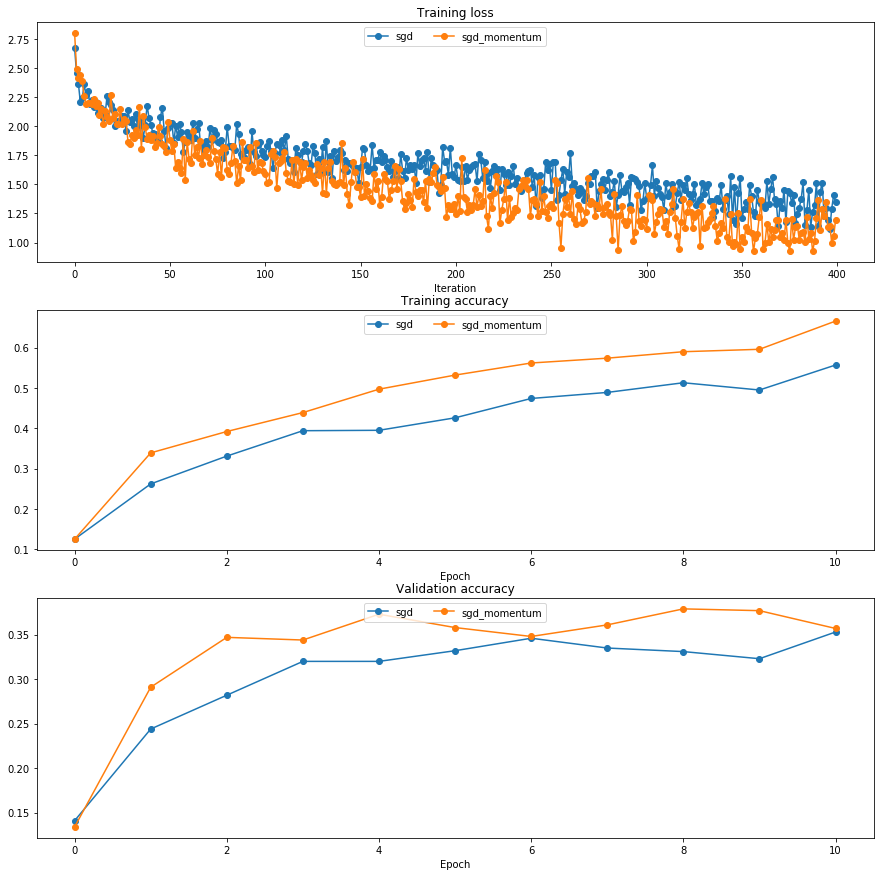

In [23]:
num_train = 4000
small_data = {
  'X_train': data['X_train'][:num_train],
  'y_train': data['y_train'][:num_train],
  'X_val': data['X_val'],
  'y_val': data['y_val'],
}

solvers = {}

for update_rule in ['sgd', 'sgd_momentum']:
  print('running with ', update_rule)
  model = FullyConnectedNeuralNet([100, 100, 100, 100, 100], weight_scale=5e-2)

  solver = Solver(model, small_data,
                  num_epochs=10, batch_size=100,
                  update_rule=update_rule,
                  optim_config={
                    'learning_rate': 1e-2,
                  },
                  verbose=True)
  solvers[update_rule] = solver
  solver.train()
  print()

plt.subplot(3, 1, 1)
plt.title('Training loss')
plt.xlabel('Iteration')

plt.subplot(3, 1, 2)
plt.title('Training accuracy')
plt.xlabel('Epoch')

plt.subplot(3, 1, 3)
plt.title('Validation accuracy')
plt.xlabel('Epoch')

for update_rule, solver in solvers.items():
  plt.subplot(3, 1, 1)
  plt.plot(solver.loss_history, '-o', label=update_rule)
  
  plt.subplot(3, 1, 2)
  plt.plot(solver.train_acc_history, '-o', label=update_rule)

  plt.subplot(3, 1, 3)
  plt.plot(solver.val_acc_history, '-o', label=update_rule)
  
for i in [1, 2, 3]:
  plt.subplot(3, 1, i)
  plt.legend(loc='upper center', ncol=4)
plt.gcf().set_size_inches(15, 15)
plt.show()

# RMSProp et Adam
RMSProp [1] et Adam [2] sont d'autres algorithmes de descente de gradient dont le code est dans le fichier `ift725/optim.py`.   Alors que le code de Adam vous est fournit, vous devez rédigé celui de RMSProp.

[1] Tijmen Tieleman and Geoffrey Hinton. "Lecture 6.5-rmsprop: Divide the gradient by a running average of its recent magnitude." COURSERA: Neural Networks for Machine Learning 4 (2012).

[2] Diederik Kingma and Jimmy Ba, "Adam: A Method for Stochastic Optimization", ICLR 2015.

In [24]:
# Test RMSProp implementation; you should see errors less than 1e-7
import numpy as np
from ift725.optim import rmsprop

N, D = 4, 5
w = np.linspace(-0.4, 0.6, num=N*D).reshape(N, D)
dw = np.linspace(-0.6, 0.4, num=N*D).reshape(N, D)
cache = np.linspace(0.6, 0.9, num=N*D).reshape(N, D)

config = {'learning_rate': 1e-2, 'cache': cache}
next_w, _ = rmsprop(w, dw, config=config)

expected_next_w = np.asarray([
    [-0.39,       -0.33846964, -0.2868865,  -0.23525427, -0.18357633],
    [-0.13185574, -0.0800953,  -0.02829757,  0.02353511,  0.07540058],
    [ 0.12729687,  0.17922215,  0.23117507,  0.28315533,  0.33516143],
    [ 0.38719188,  0.43924528,  0.49132033,  0.54341585,  0.59553073]])
expected_cache = np.asarray([
    [0.6,        0.61510526, 0.63021053, 0.64531579, 0.66042105],
 [0.67552632, 0.69063158, 0.70573684, 0.72084211, 0.73594737],
 [0.75105263, 0.76615789, 0.78189474, 0.79805263, 0.81421053],
 [0.83036842, 0.84652632, 0.86268421, 0.87884211, 0.895     ]])  


print('next_w error: ', rel_error(expected_next_w, next_w))
print('cache error: ', rel_error(expected_cache, config['cache']))

next_w error:  3.8665153708273904e-08
cache error:  3.2856307779330615e-09


In [25]:
# Test Adam implementation; you should see errors around 1e-7 or less
from ift725.optim import adam

N, D = 4, 5
w = np.linspace(-0.4, 0.6, num=N*D).reshape(N, D)
dw = np.linspace(-0.6, 0.4, num=N*D).reshape(N, D)
m = np.linspace(0.6, 0.9, num=N*D).reshape(N, D)
v = np.linspace(0.7, 0.5, num=N*D).reshape(N, D)

config = {'learning_rate': 1e-2, 'm': m, 'v': v, 't': 5}
next_w, config = adam(w, dw, config=config)

expected_next_w = np.asarray([
  [-0.40094747, -0.34836187, -0.29577703, -0.24319299, -0.19060977],
  [-0.1380274,  -0.08544591, -0.03286534,  0.01971428,  0.0722929],
  [ 0.1248705,   0.17744702,  0.23002243,  0.28259667,  0.33516969],
  [ 0.38774145,  0.44031188,  0.49288093,  0.54544852,  0.59801459]])
expected_v = np.asarray([
  [ 0.69966,     0.68908382,  0.67851319,  0.66794809,  0.65738853,],
  [ 0.64683452,  0.63628604,  0.6257431,   0.61520571,  0.60467385,],
  [ 0.59414753,  0.58362676,  0.57311152,  0.56260183,  0.55209767,],
  [ 0.54159906,  0.53110598,  0.52061845,  0.51013645,  0.49966,   ]])
expected_m = np.asarray([
  [ 0.48,        0.49947368,  0.51894737,  0.53842105,  0.55789474],
  [ 0.57736842,  0.59684211,  0.61631579,  0.63578947,  0.65526316],
  [ 0.67473684,  0.69421053,  0.71368421,  0.73315789,  0.75263158],
  [ 0.77210526,  0.79157895,  0.81105263,  0.83052632,  0.85      ]])

print('next_w error: ', rel_error(expected_next_w, next_w))
print('v error: ', rel_error(expected_v, config['v']))
print('m error: ', rel_error(expected_m, config['m']))

next_w error:  0.0015218451757856217
v error:  4.208314038113071e-09
m error:  4.214963193114416e-09


Exécuter le code que voici afin de comparer ces différent algorithmes.  En pricipe Adam devrait être le meilleur algorithme.

running with  adam
(Iteration 1 / 400) loss: 2.659648
(Epoch 0 / 10) train acc: 0.135000; val_acc: 0.134000
(Iteration 11 / 400) loss: 1.982325
(Iteration 21 / 400) loss: 2.028523
(Iteration 31 / 400) loss: 1.670277
(Epoch 1 / 10) train acc: 0.371000; val_acc: 0.294000
(Iteration 41 / 400) loss: 1.691621
(Iteration 51 / 400) loss: 1.755896
(Iteration 61 / 400) loss: 1.555593
(Iteration 71 / 400) loss: 1.732756
(Epoch 2 / 10) train acc: 0.447000; val_acc: 0.361000
(Iteration 81 / 400) loss: 1.492673
(Iteration 91 / 400) loss: 1.768067
(Iteration 101 / 400) loss: 1.423574
(Iteration 111 / 400) loss: 1.409261
(Epoch 3 / 10) train acc: 0.503000; val_acc: 0.372000
(Iteration 121 / 400) loss: 1.257890
(Iteration 131 / 400) loss: 1.330959
(Iteration 141 / 400) loss: 1.232838
(Iteration 151 / 400) loss: 1.217942
(Epoch 4 / 10) train acc: 0.531000; val_acc: 0.365000
(Iteration 161 / 400) loss: 1.402202
(Iteration 171 / 400) loss: 1.275194
(Iteration 181 / 400) loss: 1.339025
(Iteration 191 / 40

/home/julien/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:30: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
/home/julien/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:33: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
/home/julien/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:36: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the ear

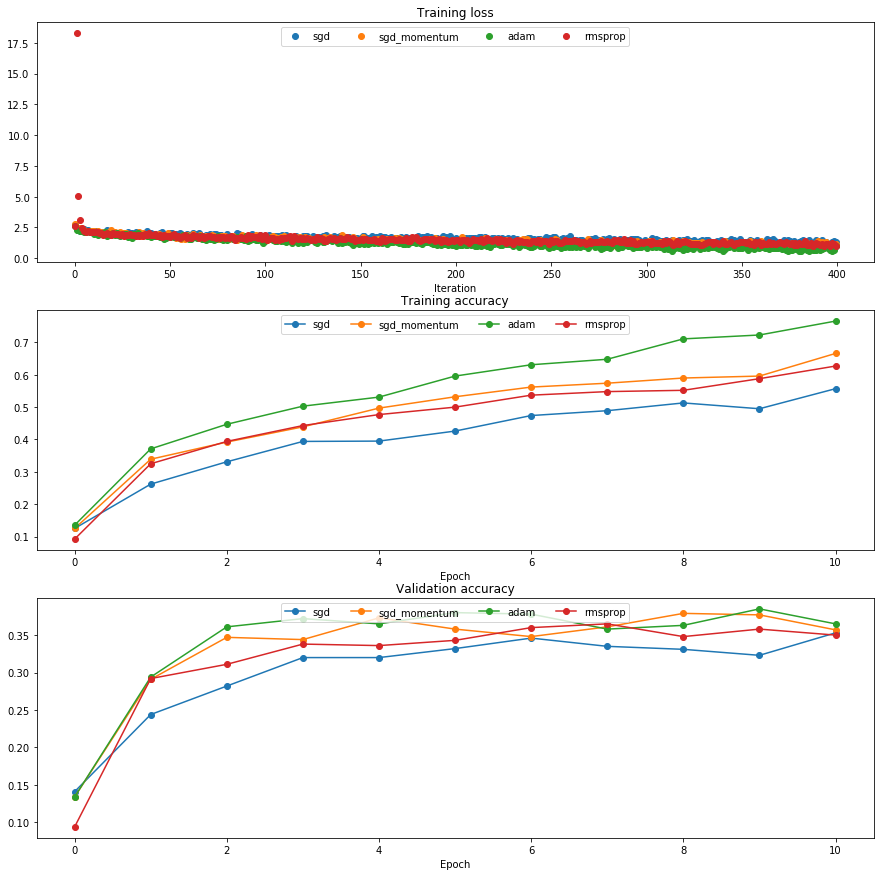

In [26]:
learning_rates = {'rmsprop': 1e-4, 'adam': 1e-3}
for update_rule in ['adam', 'rmsprop']:
  print('running with ', update_rule)
  model = FullyConnectedNeuralNet([100, 100, 100, 100, 100], weight_scale=5e-2)

  solver = Solver(model, small_data,
                  num_epochs=10, batch_size=100,
                  update_rule=update_rule,
                  optim_config={
                    'learning_rate': learning_rates[update_rule]
                  },
                  verbose=True)
  solvers[update_rule] = solver
  solver.train()
  print()

plt.subplot(3, 1, 1)
plt.title('Training loss')
plt.xlabel('Iteration')

plt.subplot(3, 1, 2)
plt.title('Training accuracy')
plt.xlabel('Epoch')

plt.subplot(3, 1, 3)
plt.title('Validation accuracy')
plt.xlabel('Epoch')

for update_rule, solver in solvers.items():
  plt.subplot(3, 1, 1)
  plt.plot(solver.loss_history, 'o', label=update_rule)
  
  plt.subplot(3, 1, 2)
  plt.plot(solver.train_acc_history, '-o', label=update_rule)

  plt.subplot(3, 1, 3)
  plt.plot(solver.val_acc_history, '-o', label=update_rule)
  
for i in [1, 2, 3]:
  plt.subplot(3, 1, i)
  plt.legend(loc='upper center', ncol=4)
plt.gcf().set_size_inches(15, 15)
plt.show()

# Entraînez un bon model!
Entraînez le meilleur réseau de neurones possible sur CIFAR-10 et mettez le meilleur modèle dans la variable `best_model`. Vous devriez avoir au moins une justesse 50% (voire même 55%) en validation et en test.

Plus tard dans le devoir, on vous demandera d'entrainer et de tester une réseau convolutionnel sur CIFAR-10.  Vous verrez alors que cette architecture est supérieure aux réseaus de neurones pleinement connectés.

NOTE: il serait judicieux de compléter le notebook `BatchNormalization.ipynb` et `Dropout.ipynb` avant de compléter cette dernière partie.

In [27]:
do_delete = True

In [28]:
if do_delete:
    trys = []
    best_try = -1
    best_val_acc = 0
    print('Deleted trys')
else:
    print('Did not delete trys')
do_delete = False

Deleted trys


In [29]:
best_model = None
################################################################################
# TODO: Entrainez le meilleur FullyConnectedNeuralNet que vous pouvez sur les  #
#  données CIFAR-10. Vous pourriez trouver la normalization par lots et le     #
#  dropout utile. Stockez votre meilleur modèle dans la variable best_model.   #
################################################################################

def uniform(minv, maxv):
    return np.random.rand() * (maxv - minv) + minv

if 'trys' not in locals():
    trys = []
    best_try = -1
    best_val_acc = 0
for i in range(1):
    # reg 0.00779190546432  lr 0.000423844376859
    # reg 0.000204588367827 lr 0.000529341067109
    weight_scale = 3e-2  # 10 ** uniform(-3, -1)
    lr = 10 ** -2.5  # 10 ** uniform(-4, -2)
    reg = 1e-10  # 10 ** uniform(-6, -3)
    
    model = FullyConnectedNeuralNet([100] * 5, weight_scale=weight_scale, reg=reg, use_batchnorm=True)

    solver = Solver(model, data,
                  num_epochs=30, batch_size=100,
                  update_rule='adam',
                  optim_config={
                    'learning_rate': lr
                  },
                  print_every=200,
                  verbose=True)
    solver.train()
    
    max_val_acc = np.max(solver.val_acc_history)
    cur_index = len(trys)
    print('Try', cur_index, 'Max accu. val.', max_val_acc, 'p:', weight_scale, reg, lr, ('Record!' if max_val_acc > best_val_acc else ''))
    trys.append({
            'ws': weight_scale, 'reg': reg, 'lr': lr,
            'maxvacc': max_val_acc,
            'lossh': solver.loss_history,
            'tacch': solver.train_acc_history,
            'vacch': solver.val_acc_history,
            'model': model
        })
    
    if max_val_acc > best_val_acc:
        best_val_acc = max_val_acc
        best_try = cur_index
        
print('Best try:', best_try)
print('Total tries', len(trys))
################################################################################
#                              FIN DE VOTRE CODE                               #
################################################################################

(Iteration 1 / 14700) loss: 2.295975
(Epoch 0 / 30) train acc: 0.138000; val_acc: 0.135000
(Iteration 201 / 14700) loss: 1.626487
(Iteration 401 / 14700) loss: 1.448544
(Epoch 1 / 30) train acc: 0.446000; val_acc: 0.444000
(Iteration 601 / 14700) loss: 1.514396
(Iteration 801 / 14700) loss: 1.340674
(Epoch 2 / 30) train acc: 0.491000; val_acc: 0.484000
(Iteration 1001 / 14700) loss: 1.488600
(Iteration 1201 / 14700) loss: 1.317754
(Iteration 1401 / 14700) loss: 1.504010
(Epoch 3 / 30) train acc: 0.508000; val_acc: 0.488000
(Iteration 1601 / 14700) loss: 1.361423
(Iteration 1801 / 14700) loss: 1.209864
(Epoch 4 / 30) train acc: 0.544000; val_acc: 0.519000
(Iteration 2001 / 14700) loss: 1.366754
(Iteration 2201 / 14700) loss: 1.482284
(Iteration 2401 / 14700) loss: 1.164821
(Epoch 5 / 30) train acc: 0.583000; val_acc: 0.528000
(Iteration 2601 / 14700) loss: 1.193499
(Iteration 2801 / 14700) loss: 1.157060
(Epoch 6 / 30) train acc: 0.588000; val_acc: 0.529000
(Iteration 3001 / 14700) loss

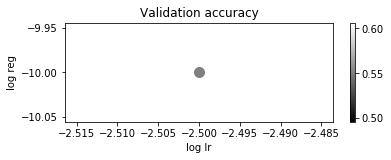

In [30]:
# Visualize the cross-validation results
forget = 0
new_tries = trys[forget:]
marker_size = 100
#x_scatter, x_label = [np.log10(x['ws']) for x in new_tries], 'log weight scale'
x_scatter, x_label = [np.log10(x['lr']) for x in new_tries], 'log lr'
y_scatter, y_label = [np.log10(x['reg']) for x in new_tries], 'log reg'

# plot validation accuracy
colors = [x['maxvacc'] for x in new_tries] # default size of markers is 20
isorted = np.argsort(colors)
x_scatter = np.asarray(x_scatter)[isorted]
y_scatter = np.asarray(y_scatter)[isorted]
colors = np.asarray(colors)[isorted]
plt.subplot(2, 1, 2)
plt.scatter(x_scatter, y_scatter, marker_size, c=colors)
plt.colorbar()
plt.xlabel(x_label)
plt.ylabel(y_label)
plt.title('Validation accuracy')
plt.show()

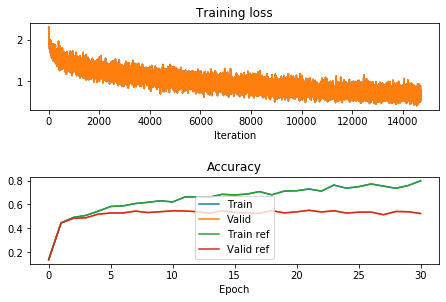

In [31]:
ref = trys[best_try]
best_try = -1
plt.subplot(2, 1, 1)
plt.title('Training loss')
plt.xlabel('Iteration')
plt.plot(trys[best_try]['lossh'], '-')
plt.plot(ref['lossh'], '-')

plt.subplot(2, 1, 2)
plt.title('Accuracy')
plt.xlabel('Epoch')
plt.plot(trys[best_try]['tacch'], '-', label='Train')
plt.plot(trys[best_try]['vacch'], '-', label='Valid')
plt.plot(ref['tacch'], '-', label='Train ref')
plt.plot(ref['vacch'], '-', label='Valid ref')
plt.legend(loc='lower center')

plt.tight_layout(pad=0, w_pad=0, h_pad=2)
plt.show()

# Test your model
Run your best model on the validation and test sets. You should achieve above 53% accuracy on the validation set.

In [32]:
best_model = trys[best_try]['model']
X_test = data['X_test']
y_test = data['y_test']
X_val  = data['X_val']
y_val  = data['y_val']
y_test_pred = np.argmax(best_model.loss(X_test), axis=1)
y_val_pred = np.argmax(best_model.loss(X_val), axis=1)
print('Validation set accuracy: ', (y_val_pred == y_val).mean())
print('Test set accuracy: ', (y_test_pred == y_test).mean())

Validation set accuracy:  0.555
Test set accuracy:  0.526
